In [111]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

import tqdm
from nba_api.stats.endpoints.shotchartdetail import ShotChartDetail
import requests
from nba_api.stats.static.players import find_players_by_full_name
from adjustText import adjust_text
from io import BytesIO
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import time
from PIL import Image
from time import sleep
from collections import defaultdict

In [108]:
from nba_api.stats.endpoints.playbyplayv2 import PlayByPlayV2

from nba_api.stats.endpoints.playbyplay import PlayByPlay
from nba_api.stats.endpoints.leaguegamefinder import LeagueGameFinder
from nba_api.stats.static.players import find_players_by_full_name
from nba_api.stats.static.teams import find_teams_by_full_name
from nba_api.stats.endpoints.playergamelogs import PlayerGameLogs
from nba_api.stats.endpoints.boxscoretraditionalv2 import BoxScoreTraditionalV2
from nba_api.stats.endpoints.shotchartdetail import ShotChartDetail

from nba_api.stats.endpoints.leaguedashteamshotlocations import LeagueDashTeamShotLocations
from nba_api.stats.endpoints.leaguedashplayerptshot import LeagueDashPlayerPtShot

from nba_api.stats.endpoints.synergyplaytypes import SynergyPlayTypes
from nba_api.stats.endpoints.leaguedashptstats import LeagueDashPtStats
from nba_api.stats.endpoints.leaguedashplayerstats import LeagueDashPlayerStats

from nba_api.stats.endpoints.leaguehustlestatsplayer import LeagueHustleStatsPlayer

In [109]:
plt.style.use('fivethirtyeight')

In [4]:
shot_data = ShotChartDetail(team_id=0, player_id=0, date_from_nullable='03-27-2021', context_measure_simple='FGA')

In [5]:
shot_df = shot_data.get_data_frames()[0]

In [6]:
cutting_shots = shot_df.loc[shot_df.ACTION_TYPE.str.contains("Cutting")]

In [7]:
cutting_shots

,GRID_TYPE,GAME_ID,GAME_EVENT_ID,PLAYER_ID,PLAYER_NAME,TEAM_ID,TEAM_NAME,PERIOD,MINUTES_REMAINING,SECONDS_REMAINING,...,SHOT_ZONE_AREA,SHOT_ZONE_RANGE,SHOT_DISTANCE,LOC_X,LOC_Y,SHOT_ATTEMPTED_FLAG,SHOT_MADE_FLAG,GAME_DATE,HTM,VTM
9,Shot Chart Detail,0022000171,30,203991,Clint Capela,1610612737,Atlanta Hawks,1,9,41,...,Center(C),Less Than 8 ft.,4,-5,40,1,1,20210330,PHX,ATL
19,Shot Chart Detail,0022000171,55,1629028,Deandre Ayton,1610612756,Phoenix Suns,1,7,30,...,Center(C),Less Than 8 ft.,1,-19,2,1,1,20210330,PHX,ATL
76,Shot Chart Detail,0022000171,254,203991,Clint Capela,1610612737,Atlanta Hawks,2,5,11,...,Center(C),Less Than 8 ft.,1,-2,14,1,1,20210330,PHX,ATL
111,Shot Chart Detail,0022000171,385,203991,Clint Capela,1610612737,Atlanta Hawks,3,6,47,...,Center(C),Less Than 8 ft.,1,10,5,1,1,20210330,PHX,ATL
124,Shot Chart Detail,0022000171,429,1628470,Torrey Craig,1610612756,Phoenix Suns,3,2,45,...,Center(C),Less Than 8 ft.,2,-3,29,1,1,20210330,PHX,ATL
128,Shot Chart Detail,0022000171,446,1630233,Nathan Knight,1610612737,Atlanta Hawks,3,1,38,...,Center(C),Less Than 8 ft.,1,6,8,1,1,20210330,PHX,ATL
138,Shot Chart Detail,0022000171,478,201568,Danilo Gallinari,1610612737,Atlanta Hawks,4,10,22,...,Center(C),Less Than 8 ft.,4,-1,48,1,0,20210330,PHX,ATL
142,Shot Chart Detail,0022000171,492,1628470,Torrey Craig,1610612756,Phoenix Suns,4,9,13,...,Center(C),Less Than 8 ft.,0,-4,6,1,1,20210330,PHX,ATL
158,Shot Chart Detail,0022000171,571,203991,Clint Capela,1610612737,Atlanta Hawks,4,4,3,...,Center(C),Less Than 8 ft.,1,3,15,1,1,20210330,PHX,ATL
215,Shot Chart Detail,0022000179,127,1628990,Chandler Hutchison,1610612764,Washington Wizards,1,1,32,...,Center(C),Less Than 8 ft.,4,-35,24,1,0,20210401,DET,WAS


In [22]:
cutting_shots.groupby('TEAM_NAME').SHOT_ATTEMPTED_FLAG.sum().reset_index().sort_values(by='SHOT_ATTEMPTED_FLAG', ascending=False)

,TEAM_NAME,SHOT_ATTEMPTED_FLAG
4,Chicago Bulls,59
10,Houston Rockets,48
17,Minnesota Timberwolves,48
5,Cleveland Cavaliers,44
7,Denver Nuggets,41
28,Utah Jazz,34
15,Miami Heat,33
16,Milwaukee Bucks,32
11,Indiana Pacers,32
9,Golden State Warriors,30


## All shots

In [23]:
all_shots = ShotChartDetail(team_id=0, player_id=0, season_nullable='2020-21', context_measure_simple='FGA')

In [24]:
full_df = all_shots.get_data_frames()[0]

In [88]:
full_df.ACTION_TYPE.unique().tolist()

['Pullup Jump shot',
 'Cutting Dunk Shot',
 'Jump Shot',
 'Cutting Layup Shot',
 'Driving Finger Roll Layup Shot',
 'Driving Layup Shot',
 'Driving Dunk Shot',
 'Running Layup Shot',
 'Step Back Jump shot',
 'Tip Dunk Shot',
 'Running Dunk Shot',
 'Hook Shot',
 'Turnaround Hook Shot',
 'Driving Floating Bank Jump Shot',
 'Tip Layup Shot',
 'Fadeaway Jump Shot',
 'Layup Shot',
 'Turnaround Fadeaway shot',
 'Running Finger Roll Layup Shot',
 'Driving Floating Jump Shot',
 'Putback Layup Shot',
 'Running Jump Shot',
 'Alley Oop Layup shot',
 'Alley Oop Dunk Shot',
 'Putback Dunk Shot',
 'Turnaround Jump Shot',
 'Driving Reverse Layup Shot',
 'Running Pull-Up Jump Shot',
 'Reverse Layup Shot',
 'Finger Roll Layup Shot',
 'Floating Jump shot',
 'Driving Hook Shot',
 'Step Back Bank Jump Shot',
 'Running Reverse Layup Shot',
 'Jump Bank Shot',
 'Hook Bank Shot',
 'Driving Bank Hook Shot',
 'Dunk Shot',
 'Running Alley Oop Layup Shot',
 'Turnaround Fadeaway Bank Jump Shot',
 'Running Alley Oo

In [89]:
cuts = full_df.loc[full_df.ACTION_TYPE.str.contains("Cutting")]

In [93]:
cut_agg = cuts.groupby('PLAYER_NAME').SHOT_MADE_FLAG.sum().reset_index()

In [95]:
cut_agg.sort_values(by='SHOT_MADE_FLAG', ascending=False)

,PLAYER_NAME,SHOT_MADE_FLAG
436,Zion Williamson,81
367,Rudy Gobert,77
308,Montrezl Harrell,60
58,Chris Boucher,56
121,Doug McDermott,54
181,Jakob Poeltl,53
117,Domantas Sabonis,51
133,Enes Kanter,43
99,Deandre Ayton,40
178,Jae'Sean Tate,38


### Hooks

In [25]:
hooks = full_df.loc[full_df.ACTION_TYPE.str.contains("Hook")]

In [26]:
hook_agg = hooks.groupby(('PLAYER_ID', 'PLAYER_NAME')).agg(
    {
        'SHOT_ATTEMPTED_FLAG': 'sum',
        'SHOT_MADE_FLAG': 'sum'
    }
).reset_index()

c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
  """Entry point for launching an IPython kernel.


In [37]:
hook_agg.loc[:, 'SHOT_PCT'] = hook_agg.SHOT_MADE_FLAG / hook_agg.SHOT_ATTEMPTED_FLAG

In [38]:
hook_agg.sort_values(by='SHOT_MADE_FLAG', ascending=False)

,PLAYER_ID,PLAYER_NAME,SHOT_ATTEMPTED_FLAG,SHOT_MADE_FLAG,SHOT_PCT
60,202696,Nikola Vucevic,200,111,0.555000
23,201577,Robin Lopez,144,94,0.652778
130,203999,Nikola Jokic,121,80,0.661157
15,201152,Thaddeus Young,99,60,0.606061
55,202685,Jonas Valanciunas,100,52,0.520000
249,1629028,Deandre Ayton,80,49,0.612500
159,1627732,Ben Simmons,89,46,0.516854
160,1627734,Domantas Sabonis,115,46,0.400000
54,202684,Tristan Thompson,78,39,0.500000
53,202683,Enes Kanter,79,37,0.468354


### Play Type

In [39]:
play_types = [
    "PRBallHandler",
    "Isolation",
    "Transition",
    "Spotup",
    "Handoff",
    "OffScreen",
    "Cut",
    "OffRebound",
    "Postup",
    "PRRollman",
]

play_types_seasons = {}


    
def download_play_type_data(season='2019-20'):
    
    play_type_dict = {}
    if season not in play_types_seasons:
        print("Retrieving play types...")
        for play in play_types:
            synergy = SynergyPlayTypes(player_or_team_abbreviation='P', play_type_nullable=play, type_grouping_nullable="offensive", per_mode_simple="PerGame", season=season)
            synergy_df = synergy.get_data_frames()[0]
            play_type_dict[play] = synergy_df
            time.sleep(1)
        play_types_seasons[season] = play_type_dict
    else:
        play_type_dict = play_types_seasons[season]

    
    return play_type_dict


In [40]:
def get_interesting_data(df, target_column):
    final_df = None
    for index, play in enumerate(play_types):
        columns = ["PLAYER_NAME", target_column]
        result = df[play].loc[:, columns]
        result = result.rename(columns={target_column: f'{target_column}_{play}'})
        if index == 0:
            final_df = result
        else:
            final_df = pd.merge(left=final_df, right=result, on='PLAYER_NAME', how='outer')
    return final_df


In [41]:
play_data = download_play_type_data('2020-21')

Retrieving play types...


In [42]:
postup = play_data['Postup']
pnr = play_data['PRRollman']

In [55]:
pnr

,SEASON_ID,PLAYER_ID,PLAYER_NAME,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,PLAY_TYPE,TYPE_GROUPING,PERCENTILE,GP,...,TOV_POSS_PCT,SF_POSS_PCT,PLUSONE_POSS_PCT,SCORE_POSS_PCT,EFG_PCT,POSS,PTS,FGM,FGA,FGMX
0,22020,203999,Nikola Jokic,1610612743,DEN,Denver Nuggets,PRRollMan,Offensive,0.768,52,...,0.054,0.036,0.004,0.543,0.650,4.3,5.3,1.7,3.9,1.7
1,22020,203497,Rudy Gobert,1610612762,UTA,Utah Jazz,PRRollMan,Offensive,0.805,53,...,0.099,0.250,0.057,0.660,0.703,4.0,5.2,0.8,2.8,0.8
2,22020,202696,Nikola Vucevic,1610612753,ORL,Orlando Magic,PRRollMan,Offensive,0.532,44,...,0.025,0.034,0.013,0.485,0.578,5.4,6.1,2.6,5.1,2.6
3,22020,1626158,Richaun Holmes,1610612758,SAC,Sacramento Kings,PRRollMan,Offensive,0.858,49,...,0.046,0.147,0.046,0.675,0.673,4.0,5.4,1.1,3.4,1.1
4,22020,1628449,Chris Boucher,1610612761,TOR,Toronto Raptors,PRRollMan,Offensive,0.737,53,...,0.034,0.205,0.051,0.540,0.573,3.3,4.1,1.4,2.7,1.4
5,22020,1628389,Bam Adebayo,1610612748,MIA,Miami Heat,PRRollMan,Offensive,0.884,46,...,0.048,0.110,0.055,0.690,0.705,3.2,4.4,0.8,2.8,0.8
6,22020,1627734,Domantas Sabonis,1610612754,IND,Indiana Pacers,PRRollMan,Offensive,0.289,48,...,0.116,0.160,0.066,0.475,0.532,3.8,3.9,1.5,3.0,1.5
7,22020,203991,Clint Capela,1610612737,ATL,Atlanta Hawks,PRRollMan,Offensive,0.742,46,...,0.029,0.121,0.014,0.643,0.620,3.0,3.8,1.0,2.6,1.0
8,22020,1629675,Naz Reid,1610612750,MIN,Minnesota Timberwolves,PRRollMan,Offensive,0.605,51,...,0.074,0.169,0.007,0.566,0.617,2.7,3.1,0.9,2.0,0.9
9,22020,1626174,Christian Wood,1610612745,HOU,Houston Rockets,PRRollMan,Offensive,0.616,30,...,0.091,0.144,0.053,0.545,0.616,4.4,5.2,1.5,3.6,1.5


In [59]:
postup = postup.groupby(('PLAYER_ID', 'PLAYER_NAME')).agg(
    {
        'POSS': 'mean',
        'PPP': 'mean',
        'PTS': 'mean'
    }
).reset_index()

pnr = pnr.groupby(('PLAYER_ID', 'PLAYER_NAME')).agg(
    {
        'POSS': 'mean',
        'PPP': 'mean',
        'PTS': 'mean'
    }
).reset_index()

c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
  """Entry point for launching an IPython kernel.
c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:9: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
  if __name__ == '__main__':


In [60]:
merged_df = pd.merge(left=postup, right=pnr, on=('PLAYER_ID', 'PLAYER_NAME'), suffixes=('_POSTUP', '_PNR'))

merged_df.loc[:, 'TOTAL_POSS'] = merged_df.POSS_POSTUP + merged_df.POSS_PNR

top_50 = merged_df.sort_values(by='TOTAL_POSS', ascending=False).iloc[:35]

In [72]:
player_root_dir = 'player_imgs'

import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

def getImage(player_id, zoom=1.0):
    #print(path)
    return OffsetImage(plt.imread(f"{player_root_dir}/{player_id}.png"), zoom=zoom)


In [62]:
jokic_id = find_players_by_full_name("Nikola Jokic")[0]['id']

In [73]:
from matplotlib.patches import Circle, Rectangle, Arc

Text(0.4, 0.7, 'source: nba.com')

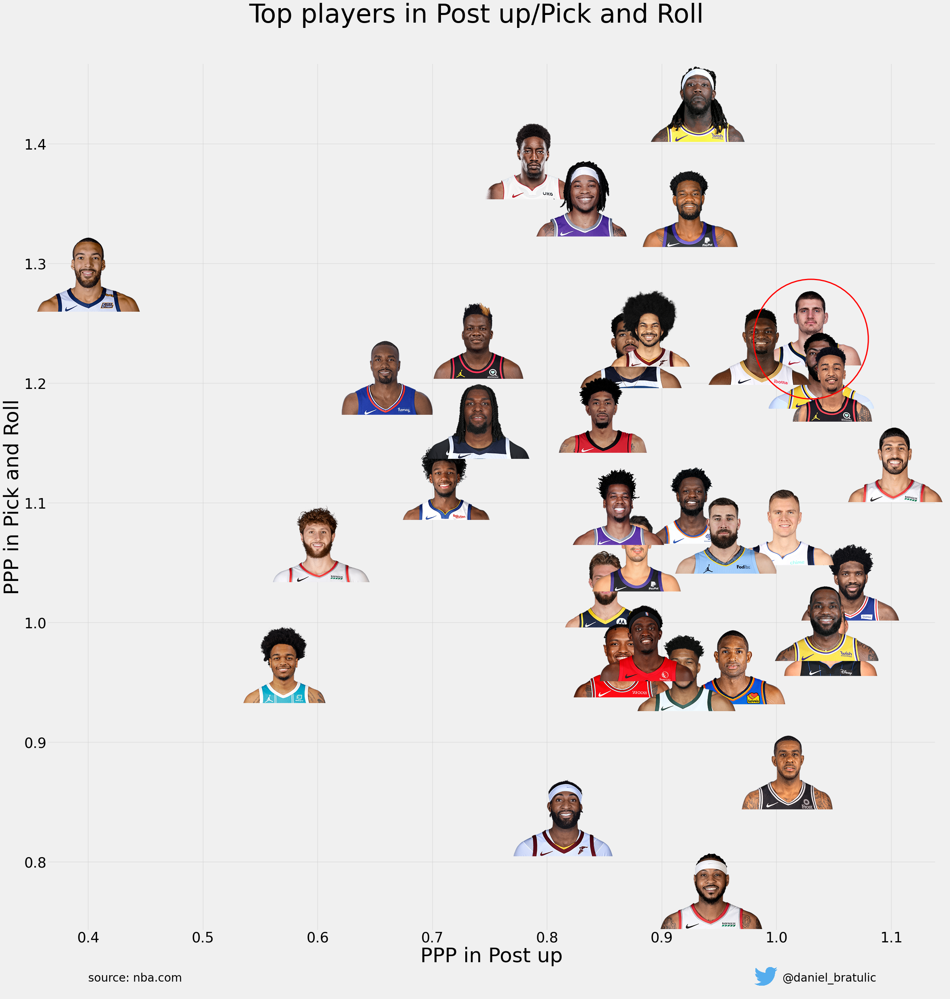

In [102]:
fig, ax = plt.subplots(figsize=(35, 35))
x = top_50.PPP_POSTUP.tolist()
y = top_50.PPP_PNR.tolist()
ax.scatter(x, y) 
ax.tick_params(labelsize=35)
ax.set_xlabel("PPP in Post up", size=50)
ax.set_ylabel("PPP in Pick and Roll", size=50)
plt.suptitle("Top players in Post up/Pick and Roll", size=64)
#ax.set_title("Top 35 igrača s najviše posjeda u tim akcijama", size=50, ha='center')
#ax.set_ylim(0.7, 1.55)
#ax.set_xlim(-0.1, 10.1)
ax.grid(b=True, alpha=0.5, lw=1.5)

for x0, y0, player_id in zip(x, y, top_50.PLAYER_ID.tolist()):
    if player_id == jokic_id:
        ab = AnnotationBbox(getImage(player_id), (x0, y0), frameon=False, pad=0.0)
        circle = Circle((x0, y0-0.01), radius=0.05, linewidth=3, color='red', fill=False, zorder=6)
        ax.add_patch(circle)
    else:
        ab = AnnotationBbox(getImage(player_id), (x0, y0), frameon=False, pad=0.0)
    ax.add_artist(ab)
    
fig.subplots_adjust(top=0.92)
#ax.title.set_position([.5, 1.15])
ax.set_frame_on(False)

y_coord = 0.7
offset_image = OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05, )

#ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (0.88, 0.74), frameon=False)

offset_image.set_offset((1850, 13))
ax.add_artist(offset_image)
ax.text(x=1.005, y=y_coord, ha='left', s='@daniel_bratulic', size=28)
ax.text(x=0.4, y=y_coord, ha='left', s='source: nba.com', size=28)

## PBP df

In [103]:
pbp_df = pd.read_csv('pbp_analysis/pbp_data/2020-21.csv')

c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\IPython\core\interactiveshell.py:3058: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [105]:
pbp_df.loc[pbp_df.EVENTMSGTYPE == 2]

,EVENTMSGACTIONTYPE,EVENTMSGTYPE,EVENTNUM,GAME_ID,HOMEDESCRIPTION,NEUTRALDESCRIPTION,PCTIMESECONDS,PCTIMESTRING,PERIOD,PERSON1TYPE,...,PLAYER3_NAME,PLAYER3_TEAM_ABBREVIATION,PLAYER3_TEAM_CITY,PLAYER3_TEAM_ID,PLAYER3_TEAM_NICKNAME,SCORE,SCOREMARGIN,VIDEO_AVAILABLE_FLAG,VISITORDESCRIPTION,WCTIMESTRING
2,1,2,7,22000267,NaN,NaN,17,11:43,1,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,MISS Dort 25' 3PT Jump Shot,10:11 PM
4,1,2,9,22000267,MISS Anthony 26' 3PT Jump Shot,NaN,28,11:32,1,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,10:11 PM
6,58,2,11,22000267,NaN,NaN,52,11:08,1,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,MISS Roby 3' Turnaround Hook Shot,10:12 PM
10,1,2,17,22000267,MISS Lillard 31' 3PT Jump Shot,NaN,83,10:37,1,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,10:12 PM
13,1,2,22,22000267,MISS Anthony 15' Jump Shot,NaN,117,10:03,1,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,10:13 PM
20,98,2,32,22000267,MISS Kanter 2' Cutting Layup Shot,NaN,186,8:54,1,4.0,...,Isaiah Roby,OKC,Oklahoma City,1.610613e+09,Thunder,NaN,NaN,1,Roby BLOCK (1 BLK),10:15 PM
22,86,2,37,22000267,MISS Anthony 12' Turnaround Fadeaway Shot,NaN,193,8:47,1,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,10:16 PM
27,1,2,43,22000267,MISS Jones Jr. 3PT Jump Shot,NaN,231,8:09,1,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,10:17 PM
31,1,2,49,22000267,MISS Trent Jr. 28' 3PT Jump Shot,NaN,263,7:37,1,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,10:18 PM
37,80,2,56,22000267,MISS Lillard 20' Step Back Jump Shot,NaN,290,7:10,1,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,10:19 PM


In [108]:
pbp_df = pbp_df.fillna({
    "HOMEDESCRIPTION": "",
    "NEUTRALDESCRIPTION": "",
    "VISITORDESCRIPTION": ""
})
pbp_df.loc[:, 'GAME_ID'] = [f"00{item}" for item in pbp_df.GAME_ID.astype(str)]

In [110]:
missed_shots = pbp_df.loc[pbp_df.EVENTMSGTYPE == 2]

In [114]:
next_events = []
for index in tqdm.tqdm(range(len(missed_shots))):
    item = missed_shots.iloc[index]
    next_item = pbp_df.iloc[pbp_df.loc[(pbp_df.GAME_ID == item.GAME_ID) & (pbp_df.EVENTNUM == item.EVENTNUM)].iloc[0].name+1]
    next_events.append(next_item.EVENTNUM)



  0%|                                                                                                                                                                                     | 0/71928 [00:00<?, ?it/s]

  0%|                                                                                                                                                                             | 5/71928 [00:00<28:33, 41.99it/s]

  0%|                                                                                                                                                                            | 10/71928 [00:00<28:10, 42.53it/s]

  0%|                                                                                                                                                                            | 15/71928 [00:00<27:55, 42.93it/s]

  0%|                                                                                                                                         

  1%|▉                                                                                                                                                                          | 380/71928 [00:08<27:54, 42.73it/s]

  1%|▉                                                                                                                                                                          | 385/71928 [00:08<28:11, 42.30it/s]

  1%|▉                                                                                                                                                                          | 390/71928 [00:09<28:14, 42.21it/s]

  1%|▉                                                                                                                                                                          | 395/71928 [00:09<28:21, 42.05it/s]

  1%|▉                                                                                                                                          

  1%|█▊                                                                                                                                                                         | 760/71928 [00:17<27:02, 43.86it/s]

  1%|█▊                                                                                                                                                                         | 765/71928 [00:17<26:53, 44.10it/s]

  1%|█▊                                                                                                                                                                         | 770/71928 [00:17<26:43, 44.38it/s]

  1%|█▊                                                                                                                                                                         | 775/71928 [00:17<26:40, 44.46it/s]

  1%|█▊                                                                                                                                         

  2%|██▋                                                                                                                                                                       | 1140/71928 [00:26<28:05, 42.00it/s]

  2%|██▋                                                                                                                                                                       | 1145/71928 [00:26<27:56, 42.22it/s]

  2%|██▋                                                                                                                                                                       | 1150/71928 [00:26<28:41, 41.12it/s]

  2%|██▋                                                                                                                                                                       | 1155/71928 [00:26<28:04, 42.01it/s]

  2%|██▋                                                                                                                                        

  2%|███▌                                                                                                                                                                      | 1520/71928 [00:35<26:46, 43.83it/s]

  2%|███▌                                                                                                                                                                      | 1525/71928 [00:35<26:58, 43.49it/s]

  2%|███▌                                                                                                                                                                      | 1530/71928 [00:35<26:58, 43.49it/s]

  2%|███▋                                                                                                                                                                      | 1535/71928 [00:35<26:46, 43.83it/s]

  2%|███▋                                                                                                                                       

  3%|████▍                                                                                                                                                                     | 1900/71928 [00:43<26:42, 43.69it/s]

  3%|████▌                                                                                                                                                                     | 1905/71928 [00:43<26:40, 43.74it/s]

  3%|████▌                                                                                                                                                                     | 1910/71928 [00:44<26:43, 43.67it/s]

  3%|████▌                                                                                                                                                                     | 1915/71928 [00:44<26:57, 43.27it/s]

  3%|████▌                                                                                                                                      

  3%|█████▍                                                                                                                                                                    | 2280/71928 [00:52<26:12, 44.28it/s]

  3%|█████▍                                                                                                                                                                    | 2285/71928 [00:52<26:17, 44.15it/s]

  3%|█████▍                                                                                                                                                                    | 2290/71928 [00:52<26:45, 43.38it/s]

  3%|█████▍                                                                                                                                                                    | 2295/71928 [00:53<26:48, 43.30it/s]

  3%|█████▍                                                                                                                                     

  4%|██████▎                                                                                                                                                                   | 2660/71928 [01:01<27:18, 42.27it/s]

  4%|██████▎                                                                                                                                                                   | 2665/71928 [01:01<26:56, 42.84it/s]

  4%|██████▎                                                                                                                                                                   | 2670/71928 [01:01<26:37, 43.36it/s]

  4%|██████▎                                                                                                                                                                   | 2675/71928 [01:01<26:27, 43.62it/s]

  4%|██████▎                                                                                                                                    

  4%|███████▏                                                                                                                                                                  | 3040/71928 [01:10<26:39, 43.07it/s]

  4%|███████▏                                                                                                                                                                  | 3045/71928 [01:10<26:47, 42.86it/s]

  4%|███████▏                                                                                                                                                                  | 3050/71928 [01:10<27:05, 42.38it/s]

  4%|███████▏                                                                                                                                                                  | 3055/71928 [01:10<28:03, 40.92it/s]

  4%|███████▏                                                                                                                                   

  5%|████████                                                                                                                                                                  | 3420/71928 [01:19<26:26, 43.19it/s]

  5%|████████                                                                                                                                                                  | 3425/71928 [01:19<26:27, 43.16it/s]

  5%|████████                                                                                                                                                                  | 3430/71928 [01:19<26:39, 42.81it/s]

  5%|████████                                                                                                                                                                  | 3435/71928 [01:19<26:53, 42.46it/s]

  5%|████████▏                                                                                                                                  

  5%|████████▉                                                                                                                                                                 | 3800/71928 [01:28<26:18, 43.17it/s]

  5%|████████▉                                                                                                                                                                 | 3805/71928 [01:28<26:06, 43.48it/s]

  5%|█████████                                                                                                                                                                 | 3810/71928 [01:28<26:02, 43.60it/s]

  5%|█████████                                                                                                                                                                 | 3815/71928 [01:28<26:07, 43.45it/s]

  5%|█████████                                                                                                                                  

  6%|█████████▉                                                                                                                                                                | 4180/71928 [01:37<26:01, 43.39it/s]

  6%|█████████▉                                                                                                                                                                | 4185/71928 [01:37<26:00, 43.42it/s]

  6%|█████████▉                                                                                                                                                                | 4190/71928 [01:37<26:11, 43.09it/s]

  6%|█████████▉                                                                                                                                                                | 4195/71928 [01:37<25:55, 43.55it/s]

  6%|█████████▉                                                                                                                                 

  6%|██████████▊                                                                                                                                                               | 4560/71928 [01:46<26:40, 42.08it/s]

  6%|██████████▊                                                                                                                                                               | 4565/71928 [01:46<26:41, 42.06it/s]

  6%|██████████▊                                                                                                                                                               | 4570/71928 [01:46<26:41, 42.05it/s]

  6%|██████████▊                                                                                                                                                               | 4575/71928 [01:46<26:29, 42.36it/s]

  6%|██████████▊                                                                                                                                

  7%|███████████▋                                                                                                                                                              | 4940/71928 [01:54<26:08, 42.71it/s]

  7%|███████████▋                                                                                                                                                              | 4945/71928 [01:54<26:03, 42.84it/s]

  7%|███████████▋                                                                                                                                                              | 4950/71928 [01:55<25:44, 43.36it/s]

  7%|███████████▋                                                                                                                                                              | 4955/71928 [01:55<25:47, 43.29it/s]

  7%|███████████▋                                                                                                                               

  7%|████████████▌                                                                                                                                                             | 5320/71928 [02:03<25:36, 43.36it/s]

  7%|████████████▌                                                                                                                                                             | 5325/71928 [02:03<25:46, 43.05it/s]

  7%|████████████▌                                                                                                                                                             | 5330/71928 [02:03<25:46, 43.08it/s]

  7%|████████████▌                                                                                                                                                             | 5335/71928 [02:04<25:53, 42.86it/s]

  7%|████████████▌                                                                                                                              

  8%|█████████████▍                                                                                                                                                            | 5695/71928 [02:12<28:24, 38.86it/s]

  8%|█████████████▍                                                                                                                                                            | 5700/71928 [02:12<27:29, 40.14it/s]

  8%|█████████████▍                                                                                                                                                            | 5705/71928 [02:13<27:03, 40.79it/s]

  8%|█████████████▍                                                                                                                                                            | 5710/71928 [02:13<27:05, 40.75it/s]

  8%|█████████████▌                                                                                                                             

  8%|██████████████▎                                                                                                                                                           | 6075/71928 [02:21<26:12, 41.88it/s]

  8%|██████████████▎                                                                                                                                                           | 6080/71928 [02:21<25:43, 42.67it/s]

  8%|██████████████▍                                                                                                                                                           | 6085/71928 [02:22<25:46, 42.58it/s]

  8%|██████████████▍                                                                                                                                                           | 6090/71928 [02:22<26:04, 42.09it/s]

  8%|██████████████▍                                                                                                                            

  9%|███████████████▎                                                                                                                                                          | 6455/71928 [02:30<25:48, 42.29it/s]

  9%|███████████████▎                                                                                                                                                          | 6460/71928 [02:30<27:29, 39.69it/s]

  9%|███████████████▎                                                                                                                                                          | 6465/71928 [02:30<26:46, 40.76it/s]

  9%|███████████████▎                                                                                                                                                          | 6470/71928 [02:31<26:12, 41.64it/s]

  9%|███████████████▎                                                                                                                           

 10%|████████████████▏                                                                                                                                                         | 6835/71928 [02:39<25:13, 43.02it/s]

 10%|████████████████▏                                                                                                                                                         | 6840/71928 [02:39<24:56, 43.49it/s]

 10%|████████████████▏                                                                                                                                                         | 6845/71928 [02:39<24:52, 43.60it/s]

 10%|████████████████▏                                                                                                                                                         | 6850/71928 [02:39<24:49, 43.68it/s]

 10%|████████████████▏                                                                                                                          

 10%|█████████████████                                                                                                                                                         | 7215/71928 [02:48<24:44, 43.60it/s]

 10%|█████████████████                                                                                                                                                         | 7220/71928 [02:48<25:00, 43.11it/s]

 10%|█████████████████                                                                                                                                                         | 7225/71928 [02:48<25:31, 42.24it/s]

 10%|█████████████████                                                                                                                                                         | 7230/71928 [02:48<25:06, 42.93it/s]

 10%|█████████████████                                                                                                                          

 11%|█████████████████▉                                                                                                                                                        | 7595/71928 [02:57<24:21, 44.00it/s]

 11%|█████████████████▉                                                                                                                                                        | 7600/71928 [02:57<24:42, 43.39it/s]

 11%|█████████████████▉                                                                                                                                                        | 7605/71928 [02:57<24:56, 42.97it/s]

 11%|█████████████████▉                                                                                                                                                        | 7610/71928 [02:57<25:10, 42.57it/s]

 11%|█████████████████▉                                                                                                                         

 11%|██████████████████▊                                                                                                                                                       | 7975/71928 [03:05<24:37, 43.27it/s]

 11%|██████████████████▊                                                                                                                                                       | 7980/71928 [03:06<24:42, 43.13it/s]

 11%|██████████████████▊                                                                                                                                                       | 7985/71928 [03:06<25:09, 42.36it/s]

 11%|██████████████████▉                                                                                                                                                       | 7990/71928 [03:06<24:46, 43.02it/s]

 11%|██████████████████▉                                                                                                                        

 12%|███████████████████▋                                                                                                                                                      | 8355/71928 [03:14<24:49, 42.68it/s]

 12%|███████████████████▊                                                                                                                                                      | 8360/71928 [03:14<25:04, 42.26it/s]

 12%|███████████████████▊                                                                                                                                                      | 8365/71928 [03:15<24:47, 42.73it/s]

 12%|███████████████████▊                                                                                                                                                      | 8370/71928 [03:15<24:51, 42.62it/s]

 12%|███████████████████▊                                                                                                                       

 12%|████████████████████▋                                                                                                                                                     | 8735/71928 [03:23<24:33, 42.88it/s]

 12%|████████████████████▋                                                                                                                                                     | 8740/71928 [03:23<24:27, 43.07it/s]

 12%|████████████████████▋                                                                                                                                                     | 8745/71928 [03:23<24:07, 43.64it/s]

 12%|████████████████████▋                                                                                                                                                     | 8750/71928 [03:23<24:05, 43.71it/s]

 12%|████████████████████▋                                                                                                                      

 13%|█████████████████████▌                                                                                                                                                    | 9115/71928 [03:32<23:59, 43.63it/s]

 13%|█████████████████████▌                                                                                                                                                    | 9120/71928 [03:32<24:08, 43.35it/s]

 13%|█████████████████████▌                                                                                                                                                    | 9125/71928 [03:32<24:22, 42.95it/s]

 13%|█████████████████████▌                                                                                                                                                    | 9130/71928 [03:32<24:43, 42.33it/s]

 13%|█████████████████████▌                                                                                                                     

 13%|██████████████████████▍                                                                                                                                                   | 9495/71928 [03:41<24:08, 43.11it/s]

 13%|██████████████████████▍                                                                                                                                                   | 9500/71928 [03:41<24:19, 42.78it/s]

 13%|██████████████████████▍                                                                                                                                                   | 9505/71928 [03:41<24:19, 42.77it/s]

 13%|██████████████████████▍                                                                                                                                                   | 9510/71928 [03:41<24:19, 42.75it/s]

 13%|██████████████████████▍                                                                                                                    

 14%|███████████████████████▎                                                                                                                                                  | 9875/71928 [03:50<24:29, 42.23it/s]

 14%|███████████████████████▎                                                                                                                                                  | 9880/71928 [03:50<24:46, 41.73it/s]

 14%|███████████████████████▎                                                                                                                                                  | 9885/71928 [03:50<24:17, 42.57it/s]

 14%|███████████████████████▎                                                                                                                                                  | 9890/71928 [03:50<24:12, 42.72it/s]

 14%|███████████████████████▍                                                                                                                   

 14%|████████████████████████                                                                                                                                                 | 10255/71928 [03:58<23:56, 42.94it/s]

 14%|████████████████████████                                                                                                                                                 | 10260/71928 [03:59<24:01, 42.77it/s]

 14%|████████████████████████                                                                                                                                                 | 10265/71928 [03:59<24:05, 42.65it/s]

 14%|████████████████████████▏                                                                                                                                                | 10270/71928 [03:59<24:08, 42.56it/s]

 14%|████████████████████████▏                                                                                                                  

 15%|████████████████████████▉                                                                                                                                                | 10632/71928 [04:08<24:50, 41.12it/s]

 15%|████████████████████████▉                                                                                                                                                | 10637/71928 [04:08<24:52, 41.08it/s]

 15%|█████████████████████████                                                                                                                                                | 10642/71928 [04:08<24:26, 41.78it/s]

 15%|█████████████████████████                                                                                                                                                | 10647/71928 [04:08<24:09, 42.27it/s]

 15%|█████████████████████████                                                                                                                  

 15%|█████████████████████████▊                                                                                                                                               | 11012/71928 [04:16<22:54, 44.32it/s]

 15%|█████████████████████████▉                                                                                                                                               | 11017/71928 [04:17<22:47, 44.53it/s]

 15%|█████████████████████████▉                                                                                                                                               | 11022/71928 [04:17<22:50, 44.44it/s]

 15%|█████████████████████████▉                                                                                                                                               | 11027/71928 [04:17<23:02, 44.04it/s]

 15%|█████████████████████████▉                                                                                                                 

 16%|██████████████████████████▊                                                                                                                                              | 11392/71928 [04:25<22:43, 44.41it/s]

 16%|██████████████████████████▊                                                                                                                                              | 11397/71928 [04:25<22:37, 44.59it/s]

 16%|██████████████████████████▊                                                                                                                                              | 11402/71928 [04:25<22:40, 44.49it/s]

 16%|██████████████████████████▊                                                                                                                                              | 11407/71928 [04:26<22:31, 44.77it/s]

 16%|██████████████████████████▊                                                                                                                

 16%|███████████████████████████▋                                                                                                                                             | 11772/71928 [04:34<23:31, 42.62it/s]

 16%|███████████████████████████▋                                                                                                                                             | 11777/71928 [04:34<23:44, 42.22it/s]

 16%|███████████████████████████▋                                                                                                                                             | 11782/71928 [04:34<23:31, 42.60it/s]

 16%|███████████████████████████▋                                                                                                                                             | 11787/71928 [04:34<23:34, 42.52it/s]

 16%|███████████████████████████▋                                                                                                               

 17%|████████████████████████████▌                                                                                                                                            | 12152/71928 [04:42<22:57, 43.39it/s]

 17%|████████████████████████████▌                                                                                                                                            | 12157/71928 [04:43<23:46, 41.89it/s]

 17%|████████████████████████████▌                                                                                                                                            | 12162/71928 [04:43<24:21, 40.90it/s]

 17%|████████████████████████████▌                                                                                                                                            | 12167/71928 [04:43<24:23, 40.83it/s]

 17%|████████████████████████████▌                                                                                                              

 17%|█████████████████████████████▍                                                                                                                                           | 12507/71928 [04:52<24:02, 41.18it/s]

 17%|█████████████████████████████▍                                                                                                                                           | 12512/71928 [04:52<24:04, 41.12it/s]

 17%|█████████████████████████████▍                                                                                                                                           | 12517/71928 [04:52<24:02, 41.18it/s]

 17%|█████████████████████████████▍                                                                                                                                           | 12522/71928 [04:52<24:22, 40.62it/s]

 17%|█████████████████████████████▍                                                                                                             

 18%|██████████████████████████████▏                                                                                                                                          | 12861/71928 [05:01<27:03, 36.38it/s]

 18%|██████████████████████████████▏                                                                                                                                          | 12865/71928 [05:01<27:17, 36.07it/s]

 18%|██████████████████████████████▏                                                                                                                                          | 12869/71928 [05:01<26:59, 36.46it/s]

 18%|██████████████████████████████▏                                                                                                                                          | 12873/71928 [05:01<30:42, 32.05it/s]

 18%|██████████████████████████████▎                                                                                                            

 18%|██████████████████████████████▉                                                                                                                                          | 13189/71928 [05:10<24:35, 39.82it/s]

 18%|███████████████████████████████                                                                                                                                          | 13194/71928 [05:10<25:00, 39.13it/s]

 18%|███████████████████████████████                                                                                                                                          | 13198/71928 [05:10<25:26, 38.47it/s]

 18%|███████████████████████████████                                                                                                                                          | 13202/71928 [05:10<27:07, 36.08it/s]

 18%|███████████████████████████████                                                                                                            

 19%|███████████████████████████████▌                                                                                                                                         | 13419/71928 [05:20<42:51, 22.75it/s]

 19%|███████████████████████████████▌                                                                                                                                         | 13422/71928 [05:20<40:14, 24.23it/s]

 19%|███████████████████████████████▌                                                                                                                                         | 13425/71928 [05:20<37:55, 25.71it/s]

 19%|███████████████████████████████▌                                                                                                                                         | 13428/71928 [05:20<37:33, 25.96it/s]

 19%|███████████████████████████████▌                                                                                                           

 19%|████████████████████████████████▏                                                                                                                                        | 13678/71928 [05:30<34:53, 27.82it/s]

 19%|████████████████████████████████▏                                                                                                                                        | 13682/71928 [05:30<33:52, 28.66it/s]

 19%|████████████████████████████████▏                                                                                                                                        | 13686/71928 [05:30<32:26, 29.92it/s]

 19%|████████████████████████████████▏                                                                                                                                        | 13690/71928 [05:30<31:44, 30.59it/s]

 19%|████████████████████████████████▏                                                                                                          

 19%|████████████████████████████████▉                                                                                                                                        | 14011/71928 [05:39<25:30, 37.85it/s]

 19%|████████████████████████████████▉                                                                                                                                        | 14015/71928 [05:39<27:28, 35.13it/s]

 19%|████████████████████████████████▉                                                                                                                                        | 14019/71928 [05:39<27:03, 35.67it/s]

 19%|████████████████████████████████▉                                                                                                                                        | 14024/71928 [05:39<25:25, 37.97it/s]

 20%|████████████████████████████████▉                                                                                                          

 20%|█████████████████████████████████▊                                                                                                                                       | 14365/71928 [05:48<23:33, 40.72it/s]

 20%|█████████████████████████████████▊                                                                                                                                       | 14370/71928 [05:48<24:05, 39.82it/s]

 20%|█████████████████████████████████▊                                                                                                                                       | 14374/71928 [05:49<24:51, 38.60it/s]

 20%|█████████████████████████████████▊                                                                                                                                       | 14378/71928 [05:49<25:09, 38.12it/s]

 20%|█████████████████████████████████▊                                                                                                         

 20%|██████████████████████████████████▋                                                                                                                                      | 14741/71928 [05:57<22:29, 42.38it/s]

 21%|██████████████████████████████████▋                                                                                                                                      | 14746/71928 [05:58<22:22, 42.59it/s]

 21%|██████████████████████████████████▋                                                                                                                                      | 14751/71928 [05:58<22:41, 41.99it/s]

 21%|██████████████████████████████████▋                                                                                                                                      | 14756/71928 [05:58<23:01, 41.37it/s]

 21%|██████████████████████████████████▋                                                                                                        

 21%|███████████████████████████████████▌                                                                                                                                     | 15113/71928 [06:06<23:46, 39.82it/s]

 21%|███████████████████████████████████▌                                                                                                                                     | 15118/71928 [06:07<23:51, 39.68it/s]

 21%|███████████████████████████████████▌                                                                                                                                     | 15122/71928 [06:07<25:09, 37.64it/s]

 21%|███████████████████████████████████▌                                                                                                                                     | 15126/71928 [06:07<25:20, 37.35it/s]

 21%|███████████████████████████████████▌                                                                                                       

 22%|████████████████████████████████████▍                                                                                                                                    | 15482/71928 [06:15<22:29, 41.83it/s]

 22%|████████████████████████████████████▍                                                                                                                                    | 15487/71928 [06:16<22:13, 42.32it/s]

 22%|████████████████████████████████████▍                                                                                                                                    | 15492/71928 [06:16<22:02, 42.66it/s]

 22%|████████████████████████████████████▍                                                                                                                                    | 15497/71928 [06:16<21:55, 42.90it/s]

 22%|████████████████████████████████████▍                                                                                                      

 22%|█████████████████████████████████████▎                                                                                                                                   | 15859/71928 [06:25<22:25, 41.66it/s]

 22%|█████████████████████████████████████▎                                                                                                                                   | 15864/71928 [06:25<22:42, 41.15it/s]

 22%|█████████████████████████████████████▎                                                                                                                                   | 15869/71928 [06:25<23:07, 40.40it/s]

 22%|█████████████████████████████████████▎                                                                                                                                   | 15874/71928 [06:25<22:47, 40.98it/s]

 22%|█████████████████████████████████████▎                                                                                                     

 23%|██████████████████████████████████████▏                                                                                                                                  | 16227/71928 [06:34<27:46, 33.43it/s]

 23%|██████████████████████████████████████▏                                                                                                                                  | 16231/71928 [06:34<26:36, 34.88it/s]

 23%|██████████████████████████████████████▏                                                                                                                                  | 16235/71928 [06:34<29:50, 31.11it/s]

 23%|██████████████████████████████████████▏                                                                                                                                  | 16239/71928 [06:34<28:40, 32.36it/s]

 23%|██████████████████████████████████████▏                                                                                                    

 23%|██████████████████████████████████████▉                                                                                                                                  | 16551/71928 [06:43<29:19, 31.47it/s]

 23%|██████████████████████████████████████▉                                                                                                                                  | 16555/71928 [06:43<29:14, 31.55it/s]

 23%|██████████████████████████████████████▉                                                                                                                                  | 16559/71928 [06:44<28:33, 32.31it/s]

 23%|██████████████████████████████████████▉                                                                                                                                  | 16563/71928 [06:44<29:20, 31.46it/s]

 23%|██████████████████████████████████████▉                                                                                                    

 23%|███████████████████████████████████████▌                                                                                                                                 | 16853/71928 [06:53<25:46, 35.61it/s]

 23%|███████████████████████████████████████▌                                                                                                                                 | 16858/71928 [06:53<24:39, 37.23it/s]

 23%|███████████████████████████████████████▌                                                                                                                                 | 16862/71928 [06:53<25:26, 36.07it/s]

 23%|███████████████████████████████████████▋                                                                                                                                 | 16866/71928 [06:53<26:04, 35.20it/s]

 23%|███████████████████████████████████████▋                                                                                                   

 24%|████████████████████████████████████████▎                                                                                                                                | 17169/71928 [07:02<23:11, 39.35it/s]

 24%|████████████████████████████████████████▎                                                                                                                                | 17174/71928 [07:02<22:51, 39.93it/s]

 24%|████████████████████████████████████████▎                                                                                                                                | 17179/71928 [07:02<23:39, 38.56it/s]

 24%|████████████████████████████████████████▎                                                                                                                                | 17183/71928 [07:02<23:48, 38.31it/s]

 24%|████████████████████████████████████████▍                                                                                                  

 24%|█████████████████████████████████████████                                                                                                                                | 17484/71928 [07:11<23:38, 38.39it/s]

 24%|█████████████████████████████████████████                                                                                                                                | 17489/71928 [07:11<23:14, 39.04it/s]

 24%|█████████████████████████████████████████                                                                                                                                | 17493/71928 [07:11<23:20, 38.87it/s]

 24%|█████████████████████████████████████████                                                                                                                                | 17498/71928 [07:11<22:42, 39.95it/s]

 24%|█████████████████████████████████████████                                                                                                  

 25%|█████████████████████████████████████████▉                                                                                                                               | 17828/71928 [07:20<25:06, 35.92it/s]

 25%|█████████████████████████████████████████▉                                                                                                                               | 17832/71928 [07:20<24:48, 36.35it/s]

 25%|█████████████████████████████████████████▉                                                                                                                               | 17836/71928 [07:20<25:32, 35.29it/s]

 25%|█████████████████████████████████████████▉                                                                                                                               | 17840/71928 [07:20<24:58, 36.09it/s]

 25%|█████████████████████████████████████████▉                                                                                                 

 25%|██████████████████████████████████████████▋                                                                                                                              | 18170/71928 [07:29<22:08, 40.45it/s]

 25%|██████████████████████████████████████████▋                                                                                                                              | 18175/71928 [07:29<22:00, 40.71it/s]

 25%|██████████████████████████████████████████▋                                                                                                                              | 18180/71928 [07:29<21:51, 41.00it/s]

 25%|██████████████████████████████████████████▋                                                                                                                              | 18185/71928 [07:29<21:51, 40.99it/s]

 25%|██████████████████████████████████████████▋                                                                                                

 26%|███████████████████████████████████████████▌                                                                                                                             | 18544/71928 [07:38<21:41, 41.01it/s]

 26%|███████████████████████████████████████████▌                                                                                                                             | 18549/71928 [07:38<21:48, 40.80it/s]

 26%|███████████████████████████████████████████▌                                                                                                                             | 18554/71928 [07:38<21:49, 40.75it/s]

 26%|███████████████████████████████████████████▌                                                                                                                             | 18559/71928 [07:38<21:47, 40.82it/s]

 26%|███████████████████████████████████████████▌                                                                                               

 26%|████████████████████████████████████████████▍                                                                                                                            | 18913/71928 [07:47<23:30, 37.59it/s]

 26%|████████████████████████████████████████████▍                                                                                                                            | 18917/71928 [07:47<23:08, 38.17it/s]

 26%|████████████████████████████████████████████▍                                                                                                                            | 18921/71928 [07:47<23:01, 38.36it/s]

 26%|████████████████████████████████████████████▍                                                                                                                            | 18925/71928 [07:47<23:00, 38.40it/s]

 26%|████████████████████████████████████████████▍                                                                                              

 27%|█████████████████████████████████████████████▎                                                                                                                           | 19267/71928 [07:56<20:17, 43.26it/s]

 27%|█████████████████████████████████████████████▎                                                                                                                           | 19272/71928 [07:56<20:12, 43.43it/s]

 27%|█████████████████████████████████████████████▎                                                                                                                           | 19277/71928 [07:56<20:18, 43.22it/s]

 27%|█████████████████████████████████████████████▎                                                                                                                           | 19282/71928 [07:56<20:38, 42.52it/s]

 27%|█████████████████████████████████████████████▎                                                                                             

 27%|██████████████████████████████████████████████▏                                                                                                                          | 19639/71928 [08:05<22:16, 39.13it/s]

 27%|██████████████████████████████████████████████▏                                                                                                                          | 19644/71928 [08:05<21:38, 40.25it/s]

 27%|██████████████████████████████████████████████▏                                                                                                                          | 19649/71928 [08:05<21:44, 40.08it/s]

 27%|██████████████████████████████████████████████▏                                                                                                                          | 19654/71928 [08:05<21:04, 41.34it/s]

 27%|██████████████████████████████████████████████▏                                                                                            

 28%|███████████████████████████████████████████████                                                                                                                          | 20007/71928 [08:14<21:08, 40.92it/s]

 28%|███████████████████████████████████████████████                                                                                                                          | 20012/71928 [08:14<21:08, 40.94it/s]

 28%|███████████████████████████████████████████████                                                                                                                          | 20017/71928 [08:14<21:07, 40.95it/s]

 28%|███████████████████████████████████████████████                                                                                                                          | 20022/71928 [08:14<20:42, 41.79it/s]

 28%|███████████████████████████████████████████████                                                                                            

 28%|███████████████████████████████████████████████▊                                                                                                                         | 20354/71928 [08:23<20:52, 41.19it/s]

 28%|███████████████████████████████████████████████▊                                                                                                                         | 20359/71928 [08:23<21:00, 40.92it/s]

 28%|███████████████████████████████████████████████▊                                                                                                                         | 20364/71928 [08:23<21:30, 39.96it/s]

 28%|███████████████████████████████████████████████▊                                                                                                                         | 20369/71928 [08:23<21:01, 40.86it/s]

 28%|███████████████████████████████████████████████▊                                                                                           

 29%|████████████████████████████████████████████████▋                                                                                                                        | 20730/71928 [08:32<20:12, 42.21it/s]

 29%|████████████████████████████████████████████████▋                                                                                                                        | 20735/71928 [08:32<19:59, 42.69it/s]

 29%|████████████████████████████████████████████████▋                                                                                                                        | 20740/71928 [08:32<20:47, 41.02it/s]

 29%|████████████████████████████████████████████████▋                                                                                                                        | 20745/71928 [08:32<20:57, 40.70it/s]

 29%|████████████████████████████████████████████████▊                                                                                          

 29%|█████████████████████████████████████████████████▌                                                                                                                       | 21107/71928 [08:41<20:30, 41.30it/s]

 29%|█████████████████████████████████████████████████▌                                                                                                                       | 21112/71928 [08:41<20:32, 41.21it/s]

 29%|█████████████████████████████████████████████████▌                                                                                                                       | 21117/71928 [08:41<20:25, 41.45it/s]

 29%|█████████████████████████████████████████████████▋                                                                                                                       | 21122/71928 [08:41<20:17, 41.72it/s]

 29%|█████████████████████████████████████████████████▋                                                                                         

 30%|██████████████████████████████████████████████████▍                                                                                                                      | 21472/71928 [08:50<20:57, 40.13it/s]

 30%|██████████████████████████████████████████████████▍                                                                                                                      | 21477/71928 [08:50<21:11, 39.69it/s]

 30%|██████████████████████████████████████████████████▍                                                                                                                      | 21482/71928 [08:50<20:35, 40.85it/s]

 30%|██████████████████████████████████████████████████▍                                                                                                                      | 21487/71928 [08:51<20:15, 41.51it/s]

 30%|██████████████████████████████████████████████████▍                                                                                        

 30%|███████████████████████████████████████████████████▎                                                                                                                     | 21845/71928 [08:59<21:38, 38.57it/s]

 30%|███████████████████████████████████████████████████▎                                                                                                                     | 21849/71928 [08:59<23:47, 35.09it/s]

 30%|███████████████████████████████████████████████████▎                                                                                                                     | 21853/71928 [08:59<24:13, 34.45it/s]

 30%|███████████████████████████████████████████████████▎                                                                                                                     | 21857/71928 [08:59<24:05, 34.64it/s]

 30%|███████████████████████████████████████████████████▎                                                                                       

 31%|████████████████████████████████████████████████████▏                                                                                                                    | 22218/71928 [09:08<21:01, 39.40it/s]

 31%|████████████████████████████████████████████████████▏                                                                                                                    | 22223/71928 [09:08<20:41, 40.04it/s]

 31%|████████████████████████████████████████████████████▏                                                                                                                    | 22228/71928 [09:08<20:23, 40.62it/s]

 31%|████████████████████████████████████████████████████▏                                                                                                                    | 22233/71928 [09:09<19:59, 41.43it/s]

 31%|████████████████████████████████████████████████████▏                                                                                      

 31%|█████████████████████████████████████████████████████                                                                                                                    | 22583/71928 [09:17<21:07, 38.93it/s]

 31%|█████████████████████████████████████████████████████                                                                                                                    | 22588/71928 [09:17<20:36, 39.90it/s]

 31%|█████████████████████████████████████████████████████                                                                                                                    | 22593/71928 [09:17<20:11, 40.71it/s]

 31%|█████████████████████████████████████████████████████                                                                                                                    | 22598/71928 [09:18<19:51, 41.40it/s]

 31%|█████████████████████████████████████████████████████                                                                                      

 32%|█████████████████████████████████████████████████████▉                                                                                                                   | 22943/71928 [09:26<23:10, 35.22it/s]

 32%|█████████████████████████████████████████████████████▉                                                                                                                   | 22947/71928 [09:26<23:19, 34.99it/s]

 32%|█████████████████████████████████████████████████████▉                                                                                                                   | 22951/71928 [09:26<25:38, 31.84it/s]

 32%|█████████████████████████████████████████████████████▉                                                                                                                   | 22955/71928 [09:27<26:16, 31.07it/s]

 32%|█████████████████████████████████████████████████████▉                                                                                     

 32%|██████████████████████████████████████████████████████▌                                                                                                                  | 23247/71928 [09:36<29:22, 27.62it/s]

 32%|██████████████████████████████████████████████████████▋                                                                                                                  | 23251/71928 [09:36<28:24, 28.56it/s]

 32%|██████████████████████████████████████████████████████▋                                                                                                                  | 23254/71928 [09:36<28:09, 28.81it/s]

 32%|██████████████████████████████████████████████████████▋                                                                                                                  | 23258/71928 [09:36<26:56, 30.10it/s]

 32%|██████████████████████████████████████████████████████▋                                                                                    

 33%|███████████████████████████████████████████████████████▎                                                                                                                 | 23560/71928 [09:45<20:01, 40.26it/s]

 33%|███████████████████████████████████████████████████████▎                                                                                                                 | 23565/71928 [09:45<19:37, 41.07it/s]

 33%|███████████████████████████████████████████████████████▍                                                                                                                 | 23570/71928 [09:45<19:20, 41.66it/s]

 33%|███████████████████████████████████████████████████████▍                                                                                                                 | 23575/71928 [09:45<19:18, 41.74it/s]

 33%|███████████████████████████████████████████████████████▍                                                                                   

 33%|████████████████████████████████████████████████████████▏                                                                                                                | 23934/71928 [09:54<19:12, 41.65it/s]

 33%|████████████████████████████████████████████████████████▏                                                                                                                | 23939/71928 [09:54<19:20, 41.36it/s]

 33%|████████████████████████████████████████████████████████▎                                                                                                                | 23944/71928 [09:54<19:06, 41.86it/s]

 33%|████████████████████████████████████████████████████████▎                                                                                                                | 23949/71928 [09:54<19:13, 41.60it/s]

 33%|████████████████████████████████████████████████████████▎                                                                                  

 34%|█████████████████████████████████████████████████████████                                                                                                                | 24312/71928 [10:03<19:30, 40.67it/s]

 34%|█████████████████████████████████████████████████████████▏                                                                                                               | 24317/71928 [10:03<19:53, 39.89it/s]

 34%|█████████████████████████████████████████████████████████▏                                                                                                               | 24321/71928 [10:03<19:56, 39.80it/s]

 34%|█████████████████████████████████████████████████████████▏                                                                                                               | 24325/71928 [10:03<19:54, 39.86it/s]

 34%|█████████████████████████████████████████████████████████▏                                                                                 

 34%|██████████████████████████████████████████████████████████                                                                                                               | 24686/71928 [10:12<20:04, 39.21it/s]

 34%|██████████████████████████████████████████████████████████                                                                                                               | 24691/71928 [10:12<19:54, 39.54it/s]

 34%|██████████████████████████████████████████████████████████                                                                                                               | 24696/71928 [10:12<20:16, 38.84it/s]

 34%|██████████████████████████████████████████████████████████                                                                                                               | 24700/71928 [10:12<20:08, 39.07it/s]

 34%|██████████████████████████████████████████████████████████                                                                                 

 35%|██████████████████████████████████████████████████████████▉                                                                                                              | 25059/71928 [10:21<20:20, 38.40it/s]

 35%|██████████████████████████████████████████████████████████▉                                                                                                              | 25063/71928 [10:21<20:19, 38.42it/s]

 35%|██████████████████████████████████████████████████████████▉                                                                                                              | 25067/71928 [10:21<20:12, 38.65it/s]

 35%|██████████████████████████████████████████████████████████▉                                                                                                              | 25071/71928 [10:21<20:35, 37.94it/s]

 35%|██████████████████████████████████████████████████████████▉                                                                                

 35%|███████████████████████████████████████████████████████████▋                                                                                                             | 25425/71928 [10:30<19:23, 39.97it/s]

 35%|███████████████████████████████████████████████████████████▋                                                                                                             | 25430/71928 [10:30<19:25, 39.88it/s]

 35%|███████████████████████████████████████████████████████████▊                                                                                                             | 25435/71928 [10:30<19:16, 40.21it/s]

 35%|███████████████████████████████████████████████████████████▊                                                                                                             | 25440/71928 [10:30<19:59, 38.75it/s]

 35%|███████████████████████████████████████████████████████████▊                                                                               

 36%|████████████████████████████████████████████████████████████▌                                                                                                            | 25793/71928 [10:39<18:19, 41.95it/s]

 36%|████████████████████████████████████████████████████████████▌                                                                                                            | 25798/71928 [10:39<18:38, 41.25it/s]

 36%|████████████████████████████████████████████████████████████▋                                                                                                            | 25803/71928 [10:39<18:32, 41.48it/s]

 36%|████████████████████████████████████████████████████████████▋                                                                                                            | 25808/71928 [10:39<19:20, 39.75it/s]

 36%|████████████████████████████████████████████████████████████▋                                                                              

 36%|█████████████████████████████████████████████████████████████▍                                                                                                           | 26159/71928 [10:48<18:25, 41.41it/s]

 36%|█████████████████████████████████████████████████████████████▍                                                                                                           | 26164/71928 [10:48<18:04, 42.22it/s]

 36%|█████████████████████████████████████████████████████████████▍                                                                                                           | 26169/71928 [10:48<18:08, 42.05it/s]

 36%|█████████████████████████████████████████████████████████████▍                                                                                                           | 26174/71928 [10:48<18:21, 41.52it/s]

 36%|█████████████████████████████████████████████████████████████▌                                                                             

 37%|██████████████████████████████████████████████████████████████▏                                                                                                          | 26494/71928 [10:57<18:55, 40.00it/s]

 37%|██████████████████████████████████████████████████████████████▎                                                                                                          | 26499/71928 [10:57<18:22, 41.19it/s]

 37%|██████████████████████████████████████████████████████████████▎                                                                                                          | 26504/71928 [10:57<18:05, 41.85it/s]

 37%|██████████████████████████████████████████████████████████████▎                                                                                                          | 26509/71928 [10:58<18:09, 41.69it/s]

 37%|██████████████████████████████████████████████████████████████▎                                                                            

 37%|██████████████████████████████████████████████████████████████▉                                                                                                          | 26811/71928 [11:07<19:44, 38.08it/s]

 37%|███████████████████████████████████████████████████████████████                                                                                                          | 26815/71928 [11:07<20:14, 37.13it/s]

 37%|███████████████████████████████████████████████████████████████                                                                                                          | 26819/71928 [11:07<20:14, 37.15it/s]

 37%|███████████████████████████████████████████████████████████████                                                                                                          | 26823/71928 [11:07<19:48, 37.95it/s]

 37%|███████████████████████████████████████████████████████████████                                                                            

 38%|███████████████████████████████████████████████████████████████▋                                                                                                         | 27112/71928 [11:16<19:23, 38.53it/s]

 38%|███████████████████████████████████████████████████████████████▋                                                                                                         | 27117/71928 [11:16<19:31, 38.26it/s]

 38%|███████████████████████████████████████████████████████████████▋                                                                                                         | 27121/71928 [11:16<22:39, 32.97it/s]

 38%|███████████████████████████████████████████████████████████████▋                                                                                                         | 27125/71928 [11:16<24:50, 30.05it/s]

 38%|███████████████████████████████████████████████████████████████▋                                                                           

 38%|████████████████████████████████████████████████████████████████▍                                                                                                        | 27408/71928 [11:25<19:20, 38.38it/s]

 38%|████████████████████████████████████████████████████████████████▍                                                                                                        | 27412/71928 [11:25<19:12, 38.62it/s]

 38%|████████████████████████████████████████████████████████████████▍                                                                                                        | 27417/71928 [11:25<18:31, 40.05it/s]

 38%|████████████████████████████████████████████████████████████████▍                                                                                                        | 27422/71928 [11:25<18:10, 40.83it/s]

 38%|████████████████████████████████████████████████████████████████▍                                                                          

 39%|█████████████████████████████████████████████████████████████████                                                                                                        | 27713/71928 [11:35<25:55, 28.43it/s]

 39%|█████████████████████████████████████████████████████████████████                                                                                                        | 27717/71928 [11:35<24:59, 29.48it/s]

 39%|█████████████████████████████████████████████████████████████████▏                                                                                                       | 27721/71928 [11:35<24:34, 29.98it/s]

 39%|█████████████████████████████████████████████████████████████████▏                                                                                                       | 27725/71928 [11:35<23:16, 31.64it/s]

 39%|█████████████████████████████████████████████████████████████████▏                                                                         

 39%|█████████████████████████████████████████████████████████████████▉                                                                                                       | 28082/71928 [11:44<18:12, 40.14it/s]

 39%|█████████████████████████████████████████████████████████████████▉                                                                                                       | 28087/71928 [11:44<18:31, 39.44it/s]

 39%|██████████████████████████████████████████████████████████████████                                                                                                       | 28092/71928 [11:44<18:19, 39.89it/s]

 39%|██████████████████████████████████████████████████████████████████                                                                                                       | 28097/71928 [11:44<18:07, 40.31it/s]

 39%|██████████████████████████████████████████████████████████████████                                                                         

 40%|██████████████████████████████████████████████████████████████████▊                                                                                                      | 28443/71928 [11:53<18:50, 38.46it/s]

 40%|██████████████████████████████████████████████████████████████████▊                                                                                                      | 28447/71928 [11:53<18:53, 38.35it/s]

 40%|██████████████████████████████████████████████████████████████████▊                                                                                                      | 28451/71928 [11:53<18:49, 38.49it/s]

 40%|██████████████████████████████████████████████████████████████████▊                                                                                                      | 28455/71928 [11:53<18:59, 38.15it/s]

 40%|██████████████████████████████████████████████████████████████████▊                                                                        

 40%|███████████████████████████████████████████████████████████████████▋                                                                                                     | 28791/71928 [12:01<17:30, 41.05it/s]

 40%|███████████████████████████████████████████████████████████████████▋                                                                                                     | 28796/71928 [12:02<17:49, 40.34it/s]

 40%|███████████████████████████████████████████████████████████████████▋                                                                                                     | 28801/71928 [12:02<18:15, 39.38it/s]

 40%|███████████████████████████████████████████████████████████████████▋                                                                                                     | 28805/71928 [12:02<18:19, 39.22it/s]

 40%|███████████████████████████████████████████████████████████████████▋                                                                       

 40%|████████████████████████████████████████████████████████████████████▍                                                                                                    | 29124/71928 [12:10<18:59, 37.58it/s]

 40%|████████████████████████████████████████████████████████████████████▍                                                                                                    | 29129/71928 [12:10<18:22, 38.81it/s]

 41%|████████████████████████████████████████████████████████████████████▍                                                                                                    | 29133/71928 [12:10<18:25, 38.70it/s]

 41%|████████████████████████████████████████████████████████████████████▍                                                                                                    | 29137/71928 [12:10<18:27, 38.63it/s]

 41%|████████████████████████████████████████████████████████████████████▍                                                                      

 41%|█████████████████████████████████████████████████████████████████████▎                                                                                                   | 29481/71928 [12:19<17:21, 40.74it/s]

 41%|█████████████████████████████████████████████████████████████████████▎                                                                                                   | 29486/71928 [12:19<17:15, 40.98it/s]

 41%|█████████████████████████████████████████████████████████████████████▎                                                                                                   | 29491/71928 [12:19<17:20, 40.78it/s]

 41%|█████████████████████████████████████████████████████████████████████▎                                                                                                   | 29496/71928 [12:19<18:25, 38.40it/s]

 41%|█████████████████████████████████████████████████████████████████████▎                                                                     

 41%|██████████████████████████████████████████████████████████████████████                                                                                                   | 29834/71928 [12:28<16:51, 41.61it/s]

 41%|██████████████████████████████████████████████████████████████████████                                                                                                   | 29839/71928 [12:28<17:01, 41.21it/s]

 41%|██████████████████████████████████████████████████████████████████████                                                                                                   | 29844/71928 [12:28<16:47, 41.77it/s]

 41%|██████████████████████████████████████████████████████████████████████▏                                                                                                  | 29849/71928 [12:28<16:58, 41.32it/s]

 42%|██████████████████████████████████████████████████████████████████████▏                                                                    

 42%|██████████████████████████████████████████████████████████████████████▉                                                                                                  | 30214/71928 [12:37<17:03, 40.76it/s]

 42%|███████████████████████████████████████████████████████████████████████                                                                                                  | 30219/71928 [12:37<16:41, 41.64it/s]

 42%|███████████████████████████████████████████████████████████████████████                                                                                                  | 30224/71928 [12:37<16:26, 42.28it/s]

 42%|███████████████████████████████████████████████████████████████████████                                                                                                  | 30229/71928 [12:37<16:20, 42.53it/s]

 42%|███████████████████████████████████████████████████████████████████████                                                                    

 43%|███████████████████████████████████████████████████████████████████████▊                                                                                                 | 30588/71928 [12:46<16:29, 41.77it/s]

 43%|███████████████████████████████████████████████████████████████████████▉                                                                                                 | 30593/71928 [12:46<16:35, 41.53it/s]

 43%|███████████████████████████████████████████████████████████████████████▉                                                                                                 | 30598/71928 [12:46<16:19, 42.20it/s]

 43%|███████████████████████████████████████████████████████████████████████▉                                                                                                 | 30603/71928 [12:47<16:07, 42.69it/s]

 43%|███████████████████████████████████████████████████████████████████████▉                                                                   

 43%|████████████████████████████████████████████████████████████████████████▊                                                                                                | 30968/71928 [12:55<16:06, 42.36it/s]

 43%|████████████████████████████████████████████████████████████████████████▊                                                                                                | 30973/71928 [12:55<16:04, 42.47it/s]

 43%|████████████████████████████████████████████████████████████████████████▊                                                                                                | 30978/71928 [12:55<16:12, 42.12it/s]

 43%|████████████████████████████████████████████████████████████████████████▊                                                                                                | 30983/71928 [12:56<16:27, 41.46it/s]

 43%|████████████████████████████████████████████████████████████████████████▊                                                                  

 44%|█████████████████████████████████████████████████████████████████████████▋                                                                                               | 31348/71928 [13:04<16:35, 40.76it/s]

 44%|█████████████████████████████████████████████████████████████████████████▋                                                                                               | 31353/71928 [13:04<16:11, 41.75it/s]

 44%|█████████████████████████████████████████████████████████████████████████▋                                                                                               | 31358/71928 [13:04<16:12, 41.73it/s]

 44%|█████████████████████████████████████████████████████████████████████████▋                                                                                               | 31363/71928 [13:05<15:55, 42.45it/s]

 44%|█████████████████████████████████████████████████████████████████████████▋                                                                 

 44%|██████████████████████████████████████████████████████████████████████████▌                                                                                              | 31728/71928 [13:13<16:08, 41.52it/s]

 44%|██████████████████████████████████████████████████████████████████████████▌                                                                                              | 31733/71928 [13:13<16:04, 41.67it/s]

 44%|██████████████████████████████████████████████████████████████████████████▌                                                                                              | 31738/71928 [13:14<16:33, 40.45it/s]

 44%|██████████████████████████████████████████████████████████████████████████▌                                                                                              | 31743/71928 [13:14<16:34, 40.42it/s]

 44%|██████████████████████████████████████████████████████████████████████████▌                                                                

 45%|███████████████████████████████████████████████████████████████████████████▍                                                                                             | 32108/71928 [13:22<15:49, 41.95it/s]

 45%|███████████████████████████████████████████████████████████████████████████▍                                                                                             | 32113/71928 [13:22<15:55, 41.65it/s]

 45%|███████████████████████████████████████████████████████████████████████████▍                                                                                             | 32118/71928 [13:22<15:39, 42.39it/s]

 45%|███████████████████████████████████████████████████████████████████████████▍                                                                                             | 32123/71928 [13:23<15:46, 42.07it/s]

 45%|███████████████████████████████████████████████████████████████████████████▍                                                               

 45%|████████████████████████████████████████████████████████████████████████████▎                                                                                            | 32488/71928 [13:31<15:16, 43.02it/s]

 45%|████████████████████████████████████████████████████████████████████████████▎                                                                                            | 32493/71928 [13:31<15:27, 42.50it/s]

 45%|████████████████████████████████████████████████████████████████████████████▎                                                                                            | 32498/71928 [13:31<15:49, 41.51it/s]

 45%|████████████████████████████████████████████████████████████████████████████▎                                                                                            | 32503/71928 [13:32<15:55, 41.25it/s]

 45%|████████████████████████████████████████████████████████████████████████████▍                                                              

 46%|█████████████████████████████████████████████████████████████████████████████▏                                                                                           | 32868/71928 [13:40<15:20, 42.45it/s]

 46%|█████████████████████████████████████████████████████████████████████████████▏                                                                                           | 32873/71928 [13:40<15:13, 42.75it/s]

 46%|█████████████████████████████████████████████████████████████████████████████▏                                                                                           | 32878/71928 [13:40<15:18, 42.53it/s]

 46%|█████████████████████████████████████████████████████████████████████████████▎                                                                                           | 32883/71928 [13:41<15:07, 43.02it/s]

 46%|█████████████████████████████████████████████████████████████████████████████▎                                                             

 46%|██████████████████████████████████████████████████████████████████████████████                                                                                           | 33248/71928 [13:49<15:21, 41.97it/s]

 46%|██████████████████████████████████████████████████████████████████████████████▏                                                                                          | 33253/71928 [13:49<15:23, 41.88it/s]

 46%|██████████████████████████████████████████████████████████████████████████████▏                                                                                          | 33258/71928 [13:49<15:08, 42.56it/s]

 46%|██████████████████████████████████████████████████████████████████████████████▏                                                                                          | 33263/71928 [13:49<15:04, 42.73it/s]

 46%|██████████████████████████████████████████████████████████████████████████████▏                                                            

 47%|███████████████████████████████████████████████████████████████████████████████                                                                                          | 33628/71928 [13:58<14:57, 42.69it/s]

 47%|███████████████████████████████████████████████████████████████████████████████                                                                                          | 33633/71928 [13:58<15:03, 42.39it/s]

 47%|███████████████████████████████████████████████████████████████████████████████                                                                                          | 33638/71928 [13:58<15:17, 41.74it/s]

 47%|███████████████████████████████████████████████████████████████████████████████                                                                                          | 33643/71928 [13:58<15:08, 42.15it/s]

 47%|███████████████████████████████████████████████████████████████████████████████                                                            

 47%|███████████████████████████████████████████████████████████████████████████████▉                                                                                         | 34008/71928 [14:07<14:44, 42.88it/s]

 47%|███████████████████████████████████████████████████████████████████████████████▉                                                                                         | 34013/71928 [14:07<14:40, 43.05it/s]

 47%|███████████████████████████████████████████████████████████████████████████████▉                                                                                         | 34018/71928 [14:07<14:44, 42.85it/s]

 47%|███████████████████████████████████████████████████████████████████████████████▉                                                                                         | 34023/71928 [14:07<14:43, 42.92it/s]

 47%|███████████████████████████████████████████████████████████████████████████████▉                                                           

 48%|████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 34388/71928 [14:16<14:54, 41.96it/s]

 48%|████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 34393/71928 [14:16<14:47, 42.30it/s]

 48%|████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 34398/71928 [14:16<14:35, 42.87it/s]

 48%|████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 34403/71928 [14:16<14:29, 43.16it/s]

 48%|████████████████████████████████████████████████████████████████████████████████▊                                                          

 48%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 34768/71928 [14:25<15:06, 40.99it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 34773/71928 [14:25<14:51, 41.70it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 34778/71928 [14:25<14:37, 42.33it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 34783/71928 [14:25<14:30, 42.67it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████▋                                                         

 49%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 35148/71928 [14:34<14:28, 42.35it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 35153/71928 [14:34<14:32, 42.14it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 35158/71928 [14:34<14:22, 42.64it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 35163/71928 [14:34<14:26, 42.45it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████▋                                                        

 49%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 35528/71928 [14:43<14:30, 41.84it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 35533/71928 [14:43<14:26, 42.00it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 35538/71928 [14:43<14:15, 42.54it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                     | 35543/71928 [14:43<14:05, 43.04it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████▌                                                       

 50%|████████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 35908/71928 [14:52<14:01, 42.81it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                    | 35913/71928 [14:52<14:03, 42.68it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                    | 35918/71928 [14:52<14:18, 41.94it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                    | 35923/71928 [14:52<14:09, 42.39it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████▍                                                      

 50%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 36286/71928 [15:01<14:11, 41.83it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 36291/71928 [15:01<14:04, 42.20it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 36296/71928 [15:01<14:09, 41.94it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 36301/71928 [15:01<14:13, 41.75it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████▎                                                     

 51%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 36666/71928 [15:10<13:57, 42.11it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 36671/71928 [15:10<14:25, 40.74it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 36676/71928 [15:10<14:11, 41.42it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 36681/71928 [15:10<13:56, 42.12it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████▏                                                    

 52%|███████████████████████████████████████████████████████████████████████████████████████                                                                                  | 37046/71928 [15:19<13:37, 42.66it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████                                                                                  | 37051/71928 [15:19<13:34, 42.80it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████                                                                                  | 37056/71928 [15:19<13:43, 42.35it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████                                                                                  | 37061/71928 [15:19<13:32, 42.89it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████                                                    

 52%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 37426/71928 [15:28<13:30, 42.56it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 37431/71928 [15:28<13:27, 42.73it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 37436/71928 [15:28<13:23, 42.94it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 37441/71928 [15:28<13:24, 42.88it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████▉                                                   

 53%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 37806/71928 [15:37<13:29, 42.13it/s]

 53%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 37811/71928 [15:37<13:18, 42.74it/s]

 53%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 37816/71928 [15:37<13:16, 42.85it/s]

 53%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 37821/71928 [15:37<13:10, 43.15it/s]

 53%|████████████████████████████████████████████████████████████████████████████████████████▊                                                  

 53%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 38186/71928 [15:46<13:51, 40.57it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 38191/71928 [15:46<13:32, 41.50it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 38196/71928 [15:46<13:29, 41.66it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 38201/71928 [15:46<13:23, 41.98it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                 

 54%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 38566/71928 [15:55<13:23, 41.52it/s]

 54%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 38571/71928 [15:55<13:12, 42.08it/s]

 54%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 38576/71928 [15:55<13:02, 42.60it/s]

 54%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 38581/71928 [15:55<13:06, 42.42it/s]

 54%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                

 54%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 38942/71928 [16:04<13:04, 42.07it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 38947/71928 [16:04<13:06, 41.95it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 38952/71928 [16:04<13:17, 41.35it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 38957/71928 [16:04<12:59, 42.28it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████▌                                               

 55%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 39322/71928 [16:13<12:38, 42.96it/s]

 55%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 39327/71928 [16:13<12:57, 41.92it/s]

 55%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 39332/71928 [16:13<13:32, 40.14it/s]

 55%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 39337/71928 [16:13<13:09, 41.28it/s]

 55%|████████████████████████████████████████████████████████████████████████████████████████████▍                                              

 55%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 39702/71928 [16:22<12:33, 42.74it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 39707/71928 [16:22<12:29, 42.97it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 39712/71928 [16:22<12:33, 42.78it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 39717/71928 [16:22<12:40, 42.33it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                             

 56%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 40082/71928 [16:30<12:35, 42.17it/s]

 56%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 40087/71928 [16:31<12:47, 41.49it/s]

 56%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 40092/71928 [16:31<12:42, 41.75it/s]

 56%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 40097/71928 [16:31<12:31, 42.36it/s]

 56%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                            

 56%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 40462/71928 [16:39<12:13, 42.89it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 40467/71928 [16:40<12:12, 42.95it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 40472/71928 [16:40<12:07, 43.22it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 40477/71928 [16:40<12:06, 43.30it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████                                            

 57%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 40831/71928 [16:48<12:04, 42.94it/s]

 57%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 40836/71928 [16:48<11:59, 43.21it/s]

 57%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 40841/71928 [16:49<12:00, 43.18it/s]

 57%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 40846/71928 [16:49<12:11, 42.49it/s]

 57%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                           

 57%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 41211/71928 [16:57<11:58, 42.76it/s]

 57%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 41216/71928 [16:57<11:52, 43.08it/s]

 57%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 41221/71928 [16:57<11:47, 43.43it/s]

 57%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 41226/71928 [16:58<11:56, 42.88it/s]

 57%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                          

 58%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 41591/71928 [17:06<11:45, 42.98it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 41596/71928 [17:06<11:50, 42.70it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 41601/71928 [17:06<11:52, 42.59it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 41606/71928 [17:06<12:00, 42.10it/s]

 58%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                         

 58%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 41959/71928 [17:15<11:57, 41.77it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 41964/71928 [17:15<12:01, 41.53it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 41969/71928 [17:15<11:53, 41.99it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 41974/71928 [17:15<11:44, 42.53it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                        

 59%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 42326/71928 [17:24<11:55, 41.39it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 42331/71928 [17:24<11:59, 41.16it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 42336/71928 [17:24<11:45, 41.94it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 42341/71928 [17:25<11:39, 42.27it/s]

 59%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                       

 59%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 42706/71928 [17:33<11:24, 42.66it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 42711/71928 [17:33<11:19, 43.02it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 42716/71928 [17:33<11:16, 43.16it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 42721/71928 [17:34<11:13, 43.37it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      

 60%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 43086/71928 [17:42<11:09, 43.09it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 43091/71928 [17:42<11:14, 42.75it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 43096/71928 [17:42<11:05, 43.31it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 43101/71928 [17:42<11:10, 43.02it/s]

 60%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 43466/71928 [17:51<11:05, 42.75it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 43471/71928 [17:51<11:16, 42.09it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 43476/71928 [17:51<11:17, 41.97it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 43481/71928 [17:51<11:07, 42.63it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    

 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 43846/71928 [18:00<10:52, 43.01it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 43851/71928 [18:00<11:04, 42.27it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 43856/71928 [18:00<11:06, 42.10it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 43861/71928 [18:00<11:15, 41.55it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                    

 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 44226/71928 [18:09<11:00, 41.95it/s]

 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 44231/71928 [18:09<10:56, 42.19it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 44236/71928 [18:09<10:57, 42.14it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 44241/71928 [18:09<11:07, 41.47it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 44606/71928 [18:18<10:36, 42.91it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 44611/71928 [18:18<10:30, 43.31it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 44616/71928 [18:18<10:41, 42.58it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 44621/71928 [18:18<10:34, 43.07it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 44986/71928 [18:27<10:51, 41.38it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 44991/71928 [18:27<10:59, 40.85it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 44996/71928 [18:27<11:13, 40.01it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 45001/71928 [18:27<11:11, 40.11it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 45366/71928 [18:36<10:20, 42.84it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 45371/71928 [18:36<10:17, 43.03it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 45376/71928 [18:36<10:15, 43.16it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 45381/71928 [18:36<10:12, 43.38it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 45746/71928 [18:45<10:09, 42.95it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 45751/71928 [18:45<10:13, 42.67it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 45756/71928 [18:45<10:47, 40.41it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 45761/71928 [18:45<11:06, 39.29it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 46122/71928 [18:53<10:16, 41.87it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 46127/71928 [18:54<10:31, 40.89it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 46132/71928 [18:54<10:35, 40.62it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 46137/71928 [18:54<10:25, 41.23it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 46502/71928 [19:02<09:52, 42.94it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 46507/71928 [19:03<09:57, 42.54it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 46512/71928 [19:03<09:53, 42.82it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 46517/71928 [19:03<09:53, 42.80it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 46882/71928 [19:11<09:56, 41.98it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 46887/71928 [19:12<09:56, 42.00it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 46892/71928 [19:12<09:56, 42.00it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 46897/71928 [19:12<09:58, 41.79it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 47262/71928 [19:20<09:41, 42.41it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 47267/71928 [19:20<09:56, 41.35it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 47272/71928 [19:21<09:46, 42.07it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 47277/71928 [19:21<09:49, 41.85it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                            

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 47642/71928 [19:29<09:36, 42.14it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 47647/71928 [19:29<09:43, 41.58it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 47652/71928 [19:30<09:34, 42.23it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 47657/71928 [19:30<09:32, 42.39it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 48022/71928 [19:38<09:31, 41.84it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 48027/71928 [19:38<09:33, 41.68it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 48032/71928 [19:38<09:34, 41.57it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 48037/71928 [19:39<09:34, 41.60it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 48402/71928 [19:47<09:12, 42.55it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 48407/71928 [19:47<09:09, 42.83it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 48412/71928 [19:47<09:15, 42.36it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 48417/71928 [19:47<09:21, 41.84it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 48782/71928 [19:56<08:53, 43.39it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 48787/71928 [19:56<08:55, 43.19it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 48792/71928 [19:56<09:05, 42.40it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 48797/71928 [19:56<09:04, 42.50it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 49162/71928 [20:05<08:51, 42.81it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 49167/71928 [20:05<08:53, 42.68it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 49172/71928 [20:05<08:59, 42.16it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 49177/71928 [20:05<08:56, 42.43it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 49542/71928 [20:14<08:44, 42.69it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 49547/71928 [20:14<08:40, 43.03it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 49552/71928 [20:14<08:43, 42.72it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 49557/71928 [20:14<08:44, 42.61it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 49922/71928 [20:23<08:41, 42.23it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 49927/71928 [20:23<08:45, 41.84it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 49932/71928 [20:23<08:43, 42.01it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 49937/71928 [20:23<08:35, 42.65it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 50302/71928 [20:32<08:30, 42.37it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 50307/71928 [20:32<08:24, 42.82it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 50312/71928 [20:32<08:26, 42.68it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 50317/71928 [20:32<08:23, 42.92it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 50682/71928 [20:41<08:18, 42.63it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 50687/71928 [20:41<08:13, 43.00it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 50692/71928 [20:41<08:14, 42.91it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 50697/71928 [20:41<08:15, 42.86it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   

 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 51058/71928 [20:50<08:06, 42.94it/s]

 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 51063/71928 [20:50<08:06, 42.89it/s]

 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 51068/71928 [20:50<08:08, 42.72it/s]

 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 51073/71928 [20:50<08:11, 42.41it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   

 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 51438/71928 [20:59<07:58, 42.79it/s]

 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 51443/71928 [20:59<08:00, 42.67it/s]

 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 51448/71928 [20:59<08:02, 42.46it/s]

 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 51453/71928 [20:59<08:03, 42.33it/s]

 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 51818/71928 [21:07<07:43, 43.35it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 51823/71928 [21:08<07:45, 43.17it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 51828/71928 [21:08<07:47, 43.03it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 51833/71928 [21:08<07:52, 42.51it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 52198/71928 [21:16<08:01, 41.02it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 52203/71928 [21:17<07:52, 41.72it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 52208/71928 [21:17<07:50, 41.91it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 52213/71928 [21:17<07:51, 41.84it/s]

 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 52578/71928 [21:25<07:30, 42.94it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 52583/71928 [21:26<07:25, 43.43it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 52588/71928 [21:26<07:26, 43.34it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 52593/71928 [21:26<07:26, 43.27it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 52958/71928 [21:34<07:29, 42.19it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 52963/71928 [21:34<07:24, 42.68it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 52968/71928 [21:35<07:25, 42.58it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 52973/71928 [21:35<07:29, 42.20it/s]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 53338/71928 [21:43<07:22, 41.97it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 53343/71928 [21:43<07:22, 41.98it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 53348/71928 [21:43<07:21, 42.10it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 53353/71928 [21:44<07:22, 41.97it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 53718/71928 [21:52<07:05, 42.81it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 53723/71928 [21:52<07:04, 42.90it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 53728/71928 [21:52<07:05, 42.74it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 53733/71928 [21:53<07:11, 42.19it/s]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 54094/71928 [22:01<07:01, 42.31it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 54099/71928 [22:01<07:04, 42.01it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 54104/71928 [22:01<07:09, 41.49it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 54109/71928 [22:02<07:01, 42.27it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 54473/71928 [22:10<07:51, 36.99it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 54477/71928 [22:10<07:50, 37.11it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 54482/71928 [22:10<07:40, 37.85it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 54486/71928 [22:11<07:43, 37.59it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 54851/71928 [22:19<06:45, 42.14it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 54856/71928 [22:19<06:41, 42.54it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 54861/71928 [22:19<06:37, 42.93it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 54866/71928 [22:19<06:34, 43.20it/s]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 55231/71928 [22:28<06:32, 42.55it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 55236/71928 [22:28<06:27, 43.04it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 55241/71928 [22:28<06:30, 42.73it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 55246/71928 [22:28<06:35, 42.19it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 55611/71928 [22:37<06:24, 42.47it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 55616/71928 [22:37<06:25, 42.33it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 55621/71928 [22:37<06:20, 42.90it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 55626/71928 [22:37<06:18, 43.07it/s]

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 55988/71928 [22:46<06:16, 42.35it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 55993/71928 [22:46<06:17, 42.25it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 55998/71928 [22:46<06:18, 42.08it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 56003/71928 [22:46<06:16, 42.27it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 56368/71928 [22:55<06:16, 41.37it/s]

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 56373/71928 [22:55<06:20, 40.85it/s]

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 56378/71928 [22:55<06:10, 41.92it/s]

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 56383/71928 [22:55<06:06, 42.37it/s]

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 56748/71928 [23:04<05:50, 43.29it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 56753/71928 [23:04<05:51, 43.11it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 56758/71928 [23:04<05:50, 43.33it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 56763/71928 [23:04<05:53, 42.93it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 57128/71928 [23:13<05:51, 42.11it/s]

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 57133/71928 [23:13<05:54, 41.77it/s]

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 57138/71928 [23:13<05:55, 41.64it/s]

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 57143/71928 [23:13<05:50, 42.17it/s]

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 57508/71928 [23:22<05:35, 42.93it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 57513/71928 [23:22<05:34, 43.09it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 57518/71928 [23:22<05:34, 43.10it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 57523/71928 [23:22<05:41, 42.22it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 57888/71928 [23:31<05:40, 41.22it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 57893/71928 [23:31<05:38, 41.46it/s]

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 57898/71928 [23:31<05:37, 41.53it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 57903/71928 [23:31<05:37, 41.56it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 58268/71928 [23:39<05:25, 42.01it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 58273/71928 [23:40<05:20, 42.55it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 58278/71928 [23:40<05:24, 42.07it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 58283/71928 [23:40<05:29, 41.42it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 58648/71928 [23:48<05:04, 43.67it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 58653/71928 [23:49<05:15, 42.07it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 58658/71928 [23:49<05:15, 42.05it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 58663/71928 [23:49<05:18, 41.62it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ 

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 59028/71928 [23:57<05:02, 42.71it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 59033/71928 [23:57<05:08, 41.86it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 59038/71928 [23:58<05:12, 41.18it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 59043/71928 [23:58<05:11, 41.33it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 59390/71928 [24:06<04:57, 42.13it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 59395/71928 [24:06<04:56, 42.20it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 59400/71928 [24:06<04:54, 42.58it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 59405/71928 [24:07<04:52, 42.84it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 59770/71928 [24:15<04:51, 41.77it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 59775/71928 [24:15<04:51, 41.74it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 59780/71928 [24:15<04:47, 42.24it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 59785/71928 [24:16<04:45, 42.50it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 60150/71928 [24:24<04:39, 42.21it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 60155/71928 [24:24<04:42, 41.63it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 60160/71928 [24:24<04:41, 41.74it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 60165/71928 [24:25<04:44, 41.31it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 60530/71928 [24:33<04:25, 42.92it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 60535/71928 [24:33<04:27, 42.65it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 60540/71928 [24:33<04:24, 43.00it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 60545/71928 [24:34<04:24, 43.03it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 60910/71928 [24:42<04:27, 41.22it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 60915/71928 [24:42<04:22, 41.98it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 60920/71928 [24:42<04:25, 41.46it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 60925/71928 [24:42<04:22, 41.95it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 61287/71928 [24:51<04:09, 42.71it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 61292/71928 [24:51<04:11, 42.29it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 61297/71928 [24:51<04:11, 42.20it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 61302/71928 [24:51<04:13, 41.93it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 61666/71928 [25:00<03:59, 42.89it/s]

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 61671/71928 [25:00<03:57, 43.18it/s]

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 61676/71928 [25:00<03:58, 43.04it/s]

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 61681/71928 [25:00<04:01, 42.51it/s]

 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 62046/71928 [25:09<03:58, 41.49it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 62051/71928 [25:09<03:59, 41.23it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 62056/71928 [25:09<04:06, 40.07it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 62061/71928 [25:09<04:02, 40.63it/s]

 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 62426/71928 [25:18<03:48, 41.63it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 62431/71928 [25:18<03:48, 41.53it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 62436/71928 [25:18<03:44, 42.20it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 62441/71928 [25:18<03:45, 42.15it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 62806/71928 [25:27<03:35, 42.28it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 62811/71928 [25:27<03:34, 42.52it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 62816/71928 [25:27<03:32, 42.81it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 62821/71928 [25:27<03:33, 42.68it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 63186/71928 [25:36<03:24, 42.75it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 63191/71928 [25:36<03:26, 42.31it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 63196/71928 [25:36<03:26, 42.22it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 63201/71928 [25:36<03:25, 42.38it/s]

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 63566/71928 [25:45<03:13, 43.17it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 63571/71928 [25:45<03:14, 42.93it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 63576/71928 [25:45<03:16, 42.43it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 63581/71928 [25:45<03:14, 42.97it/s]

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 63946/71928 [25:54<03:07, 42.66it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 63951/71928 [25:54<03:07, 42.57it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 63956/71928 [25:54<03:09, 41.97it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 63961/71928 [25:54<03:06, 42.64it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 64326/71928 [26:03<03:01, 41.96it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 64331/71928 [26:03<02:59, 42.40it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 64336/71928 [26:03<02:58, 42.61it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 64341/71928 [26:03<02:56, 43.10it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 64706/71928 [26:12<02:47, 43.14it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 64711/71928 [26:12<02:48, 42.81it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 64716/71928 [26:12<02:48, 42.89it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 64721/71928 [26:12<02:49, 42.52it/s]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 65079/71928 [26:20<02:38, 43.26it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 65084/71928 [26:21<02:39, 42.99it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 65089/71928 [26:21<02:41, 42.36it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 65094/71928 [26:21<02:41, 42.27it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 65459/71928 [26:29<02:31, 42.65it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 65464/71928 [26:30<02:33, 42.03it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 65469/71928 [26:30<02:32, 42.45it/s]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 65474/71928 [26:30<02:32, 42.32it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 65839/71928 [26:38<02:23, 42.57it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 65844/71928 [26:38<02:21, 42.94it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 65849/71928 [26:39<02:20, 43.32it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 65854/71928 [26:39<02:20, 43.37it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 66218/71928 [26:47<02:15, 42.22it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 66223/71928 [26:47<02:16, 41.73it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 66228/71928 [26:48<02:15, 42.13it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 66233/71928 [26:48<02:13, 42.63it/s]

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 66598/71928 [26:56<02:05, 42.37it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 66603/71928 [26:56<02:05, 42.26it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 66608/71928 [26:57<02:05, 42.30it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 66613/71928 [26:57<02:07, 41.58it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 66978/71928 [27:05<01:59, 41.36it/s]

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 66983/71928 [27:06<01:58, 41.86it/s]

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 66988/71928 [27:06<01:58, 41.70it/s]

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 66993/71928 [27:06<01:56, 42.33it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 67354/71928 [27:14<01:49, 41.67it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 67359/71928 [27:14<01:47, 42.31it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 67364/71928 [27:15<01:46, 42.83it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 67369/71928 [27:15<01:47, 42.48it/s]

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 67734/71928 [27:23<01:39, 42.17it/s]

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 67739/71928 [27:23<01:39, 42.02it/s]

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 67744/71928 [27:24<01:41, 41.09it/s]

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 67749/71928 [27:24<01:40, 41.47it/s]

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 68114/71928 [27:32<01:29, 42.76it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 68119/71928 [27:32<01:29, 42.75it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 68124/71928 [27:33<01:29, 42.53it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 68129/71928 [27:33<01:28, 43.15it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 68494/71928 [27:41<01:20, 42.71it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 68499/71928 [27:41<01:19, 42.94it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 68504/71928 [27:42<01:19, 43.10it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 68509/71928 [27:42<01:19, 42.99it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 68874/71928 [27:50<01:12, 41.95it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 68879/71928 [27:50<01:12, 41.86it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 68884/71928 [27:50<01:12, 41.81it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 68889/71928 [27:51<01:12, 41.86it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 69254/71928 [27:59<01:03, 42.14it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 69259/71928 [27:59<01:04, 41.68it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 69264/71928 [27:59<01:04, 41.16it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 69269/71928 [28:00<01:03, 41.84it/s]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 69634/71928 [28:08<00:53, 42.76it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 69639/71928 [28:08<00:53, 42.53it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 69644/71928 [28:08<00:53, 42.81it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 69649/71928 [28:08<00:53, 42.68it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 70014/71928 [28:17<00:46, 41.36it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 70019/71928 [28:17<00:45, 41.98it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 70024/71928 [28:17<00:45, 42.31it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 70029/71928 [28:18<00:44, 42.44it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 70394/71928 [28:26<00:35, 43.30it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 70399/71928 [28:26<00:35, 43.35it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 70404/71928 [28:26<00:35, 43.27it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 70409/71928 [28:26<00:35, 43.23it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 70774/71928 [28:35<00:26, 43.35it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 70779/71928 [28:35<00:26, 43.27it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 70784/71928 [28:35<00:26, 43.22it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 70789/71928 [28:35<00:26, 43.08it/s]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 71154/71928 [28:44<00:18, 41.11it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 71159/71928 [28:44<00:18, 42.00it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 71164/71928 [28:44<00:18, 42.23it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 71169/71928 [28:44<00:18, 41.95it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 71531/71928 [28:53<00:09, 42.26it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 71536/71928 [28:53<00:09, 41.86it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 71541/71928 [28:53<00:09, 41.91it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 71546/71928 [28:53<00:09, 42.05it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 71911/71928 [29:02<00:00, 42.32it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 71916/71928 [29:02<00:00, 41.80it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 71921/71928 [29:02<00:00, 42.51it/s]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 71928/71928 [29:02<00:00, 41.27it/s]


In [115]:
missed_shots.loc[:, 'NEXT_EVENTNUM'] = next_events

c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\pandas\core\indexing.py:480: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


In [116]:
merged_missed = pd.merge(left=missed_shots, right=pbp_df, left_on=('GAME_ID', 'NEXT_EVENTNUM'), right_on=('GAME_ID', 'EVENTNUM'), suffixes=('_BLK', '_NEXT'))

In [131]:
merged_missed.to_csv('miss_next_play.csv')

In [123]:
own_off_reb = merged_missed.loc[(merged_missed.EVENTMSGTYPE_NEXT == 4) & (merged_missed.PLAYER1_ID_NEXT == merged_missed.PLAYER1_ID_BLK)]

In [126]:
own_off_reb = own_off_reb.PLAYER1_NAME_NEXT.value_counts()

In [130]:
own_off_reb.t.reset_index()

,index,PLAYER1_NAME_NEXT
0,Clint Capela,50
1,Nikola Jokic,49
2,Zion Williamson,45
3,Jonas Valanciunas,42
4,Domantas Sabonis,30
5,Julius Randle,29
6,Jaylen Brown,29
7,Joel Embiid,28
8,Josh Jackson,28
9,Montrezl Harrell,27


## TODO

* Jokic Points/Efficiency

* Heatmap of assists between players

* Jamal Murray i možda neki unassisted ratio prikazat ako ima smisla, pullupovi usporedba s ostalima

## On off

In [8]:
from nba_api.stats.endpoints.teamplayeronoffsummary import TeamPlayerOnOffSummary

In [9]:
from nba_api.stats.static.teams import get_teams

In [18]:
on_offs = []

for team in get_teams():
    cur_id = team['id']
    data = TeamPlayerOnOffSummary(team_id=cur_id, season='2020-21')
    on_df = data.get_data_frames()[1]
    off_df = data.get_data_frames()[2]
    merged_on_off = pd.merge(left=on_df, right=off_df, on=('TEAM_ID', 'TEAM_ABBREVIATION', 'TEAM_NAME', 'VS_PLAYER_ID', 'VS_PLAYER_NAME'), suffixes=('_ON', '_OFF'))
    on_offs.append(merged_on_off)
    time.sleep(0.2)

In [19]:
concat_on_off = pd.concat(on_offs)

In [36]:
scorers_data = LeagueDashPlayerStats(per_mode_detailed='PerGame', starter_bench_nullable='Starters')

In [37]:
scorers_df = scorers_data.get_data_frames()[0]

In [38]:
top_scorers = scorers_df.sort_values(by='PTS', ascending=False)

In [61]:
top_60 = top_scorers.loc[top_scorers.GP > 30].iloc[:50]

In [62]:
top_60.TEAM_ABBREVIATION.unique()

array(['WAS', 'GSW', 'PHI', 'MIL', 'POR', 'DAL', 'CHI', 'BKN', 'NOP',
       'UTA', 'DEN', 'LAC', 'PHX', 'BOS', 'LAL', 'ATL', 'MIN', 'SAC',
       'CLE', 'OKC', 'NYK', 'DET', 'MIA', 'IND', 'SAS', 'HOU', 'TOR',
       'CHA', 'MEM'], dtype=object)

In [63]:
selected_on_off = concat_on_off.loc[concat_on_off.VS_PLAYER_ID.isin(top_60.PLAYER_ID.tolist())]

In [66]:
selected_on_off.loc[:, 'NET_RATING_DIFF'] = selected_on_off.NET_RATING_ON - selected_on_off.NET_RATING_OFF

c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\pandas\core\indexing.py:480: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


In [68]:
selected_on_off = selected_on_off.loc[selected_on_off.GP_ON > 15]

In [69]:
selected_on_off.sort_values(by='NET_RATING_DIFF', ascending=False)

,GROUP_SET_ON,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,VS_PLAYER_ID,VS_PLAYER_NAME,COURT_STATUS_ON,GP_ON,MIN_ON,PLUS_MINUS_ON,...,NET_RATING_ON,GROUP_SET_OFF,COURT_STATUS_OFF,GP_OFF,MIN_OFF,PLUS_MINUS_OFF,OFF_RATING_OFF,DEF_RATING_OFF,NET_RATING_OFF,NET_RATING_DIFF
3,On/Off Court,1610612755,PHI,Philadelphia 76ers,203954,"Embiid, Joel",On,35,1130.0,13.2,...,12.9,On/Off Court,Off,53,1439.0,-1.3,105.4,106.5,-1.1,14.0
12,On/Off Court,1610612743,DEN,Denver Nuggets,203999,"Jokic, Nikola",On,53,1875.0,8.5,...,8.6,On/Off Court,Off,53,699.0,-4.3,101.4,104.9,-3.6,12.2
11,On/Off Court,1610612747,LAL,Los Angeles Lakers,2544,"James, LeBron",On,41,1388.0,9.7,...,9.8,On/Off Court,Off,53,1181.0,-1.8,103.6,105.4,-1.8,11.6
5,On/Off Court,1610612748,MIA,Miami Heat,202710,"Butler, Jimmy",On,38,1285.0,5.1,...,4.7,On/Off Court,Off,53,1279.0,-6.3,104.9,111.6,-6.7,11.4
16,On/Off Court,1610612743,DEN,Denver Nuggets,1627750,"Murray, Jamal",On,47,1670.0,8.8,...,8.3,On/Off Court,Off,53,904.0,-1.9,107.6,110.3,-2.6,10.9
5,On/Off Court,1610612746,LAC,LA Clippers,202331,"George, Paul",On,41,1373.0,12.4,...,12.2,On/Off Court,Off,55,1267.0,0.8,113.5,112.0,1.5,10.7
2,On/Off Court,1610612744,GSW,Golden State Warriors,201939,"Curry, Stephen",On,45,1527.0,3.1,...,2.3,On/Off Court,Off,53,1022.0,-9.0,100.7,109.1,-8.4,10.7
10,On/Off Court,1610612746,LAC,LA Clippers,202695,"Leonard, Kawhi",On,45,1559.0,11.0,...,11.0,On/Off Court,Off,55,1081.0,0.8,109.8,108.9,0.9,10.1
1,On/Off Court,1610612749,MIL,Milwaukee Bucks,203507,"Antetokounmpo, Giannis",On,45,1529.0,10.7,...,10.8,On/Off Court,Off,53,1020.0,-0.8,110.7,109.8,1.0,9.8
12,On/Off Court,1610612751,BKN,Brooklyn Nets,202681,"Irving, Kyrie",On,38,1337.0,8.9,...,8.7,On/Off Court,Off,53,1232.0,-0.9,111.3,112.3,-1.0,9.7


In [76]:
selected_on_off = selected_on_off.sort_values(by='NET_RATING_DIFF')

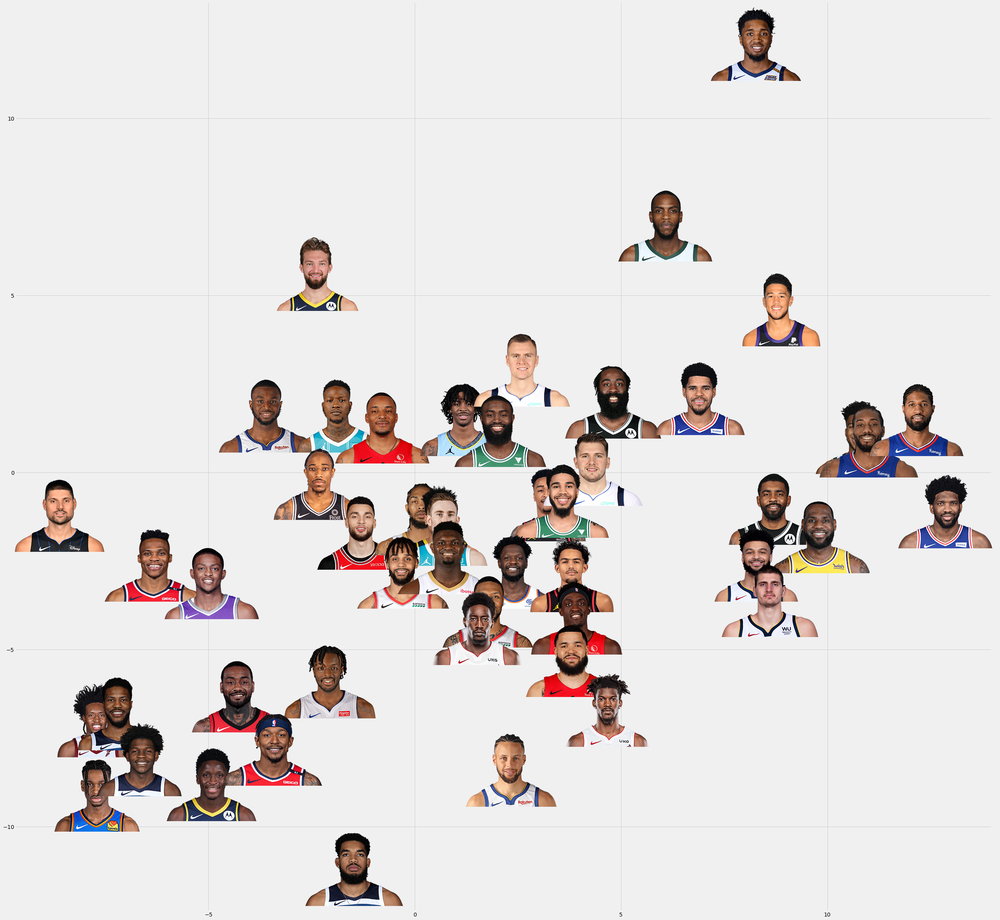

In [77]:
fig, ax = plt.subplots(figsize=(40, 40))

ax.scatter(x=selected_on_off.NET_RATING_ON, y=selected_on_off.NET_RATING_OFF, s=100, alpha=0.7, edgecolors='black')

x = selected_on_off.NET_RATING_ON
y = selected_on_off.NET_RATING_OFF
for x0, y0, player_id in zip(x, y, selected_on_off.VS_PLAYER_ID):
    ab = AnnotationBbox(getImage(player_id), (x0, y0), frameon=False, pad=0.0)
    ax.add_artist(ab)

ax.tick_params()

### Efficiency top 20

In [79]:
base_data = LeagueDashPlayerStats(per_mode_detailed='PerGame', season='2020-21')

In [80]:
adv_data = LeagueDashPlayerStats(per_mode_detailed='PerGame', season='2020-21', measure_type_detailed_defense='Advanced')

In [81]:
base_df = base_data.get_data_frames()[0]

In [82]:
adv_df = adv_data.get_data_frames()[0]

In [84]:
merged_df = pd.merge(left=base_df, right=adv_df, on=('PLAYER_ID', 'PLAYER_NAME'))

In [86]:
top_df = merged_df.loc[merged_df.PTS > 20]

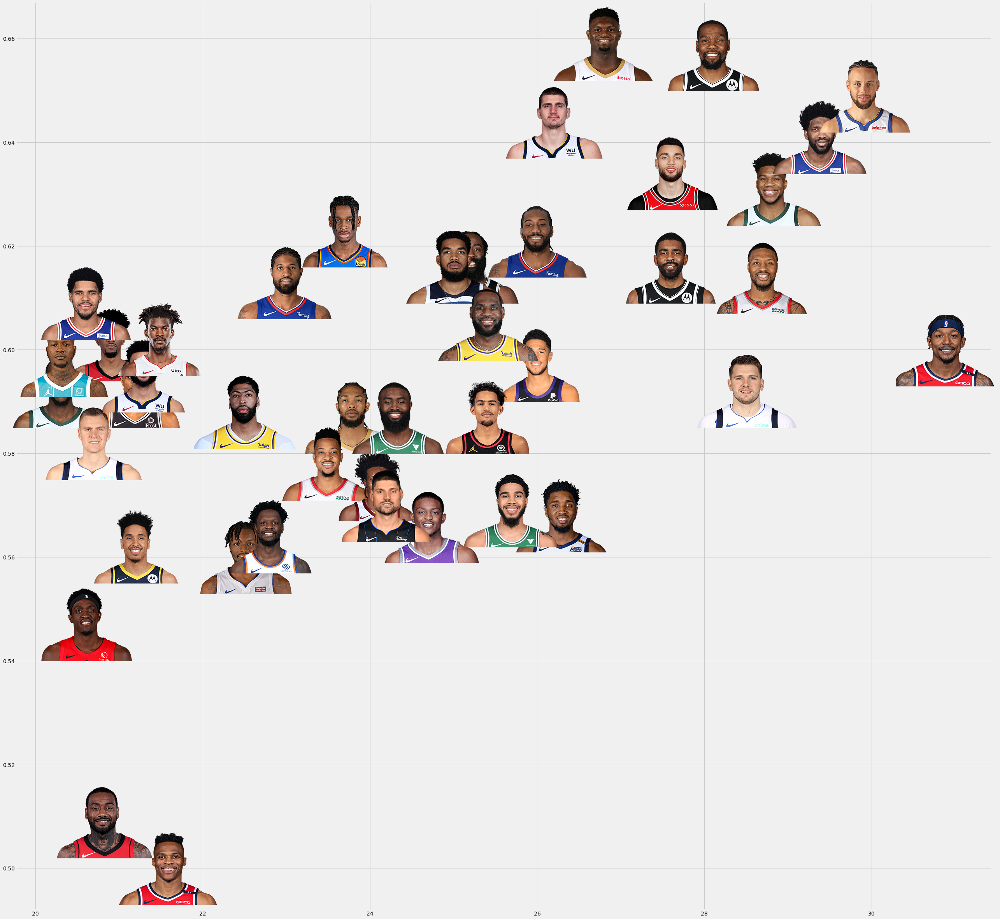

In [90]:
fig, ax = plt.subplots(figsize=(40, 40))

ax.scatter(x=top_df.PTS, y=top_df.TS_PCT, s=100, alpha=0.7, edgecolors='black')

x = top_df.PTS
y = top_df.TS_PCT
for x0, y0, player_id in zip(x, y, top_df.PLAYER_ID):
    ab = AnnotationBbox(getImage(player_id), (x0, y0), frameon=False, pad=0.0)
    ax.add_artist(ab)

ax.tick_params()

### CLUTCH

In [91]:
from nba_api.stats.endpoints.leaguedashplayerclutch import LeagueDashPlayerClutch

In [92]:
base_data = LeagueDashPlayerClutch(per_mode_detailed='PerGame', season='2020-21')

adv_data = LeagueDashPlayerClutch(per_mode_detailed='PerGame', season='2020-21', measure_type_detailed_defense='Advanced')

In [94]:
base_df = base_data.get_data_frames()[0]
adv_df = adv_data.get_data_frames()[0]

In [95]:
merged_df = pd.merge(left=base_df, right=adv_df, on=('PLAYER_ID', 'PLAYER_NAME'))

In [99]:
merged_df = merged_df.loc[merged_df.GP_x > 5]

In [100]:
merged_df.sort_values(by='PTS', ascending=False)

,GROUP_SET_x,PLAYER_ID,PLAYER_NAME,TEAM_ID_x,TEAM_ABBREVIATION_x,AGE_x,GP_x,W_x,L_x,W_PCT_x,...,PACE_RANK,sp_work_PACE_RANK,PIE_RANK,FGM_RANK_y,FGA_RANK_y,FGM_PG_RANK,FGA_PG_RANK,FG_PCT_RANK_y,CFID_y,CFPARAMS_y
71,Players,203081,Damian Lillard,1610612757,POR,30.0,27,20,7,0.741,...,239,239,10,2,5,7,16,85,1,"203081,1610612757"
354,Players,1628983,Shai Gilgeous-Alexander,1610612760,OKC,22.0,15,11,4,0.733,...,303,303,7,29,36,12,19,99,1,"1628983,1610612760"
406,Players,203897,Zach LaVine,1610612741,CHI,26.0,26,10,16,0.385,...,145,145,69,4,1,9,4,202,1,"203897,1610612741"
257,Players,2544,LeBron James,1610612747,LAL,36.0,17,12,5,0.706,...,374,374,47,6,9,2,3,149,1,"2544,1610612747"
200,Players,203954,Joel Embiid,1610612755,PHI,27.0,18,15,3,0.833,...,187,187,6,17,25,10,17,101,1,"203954,1610612755"
358,Players,201939,Stephen Curry,1610612744,GSW,33.0,19,10,9,0.526,...,261,261,21,17,19,14,13,158,1,"201939,1610612744"
178,Players,1627750,Jamal Murray,1610612743,DEN,24.0,19,11,8,0.579,...,379,379,68,10,14,6,8,102,1,"1627750,1610612743"
180,Players,201935,James Harden,1610612751,BKN,31.0,23,19,4,0.826,...,263,263,15,10,14,18,26,102,1,"201935,1610612751"
64,Players,1629012,Collin Sexton,1610612739,CLE,22.0,15,9,6,0.600,...,250,250,17,20,28,4,10,88,1,"1629012,1610612739"
235,Players,201142,Kevin Durant,1610612751,BKN,32.0,13,9,4,0.692,...,130,130,65,41,56,19,34,94,1,"201142,1610612751"


In [101]:
top_df = merged_df.sort_values(by='PTS', ascending=False).iloc[:40]

In [109]:
top_df = top_df.sort_values(by='PTS', ascending=False)

0.0016611547786570258

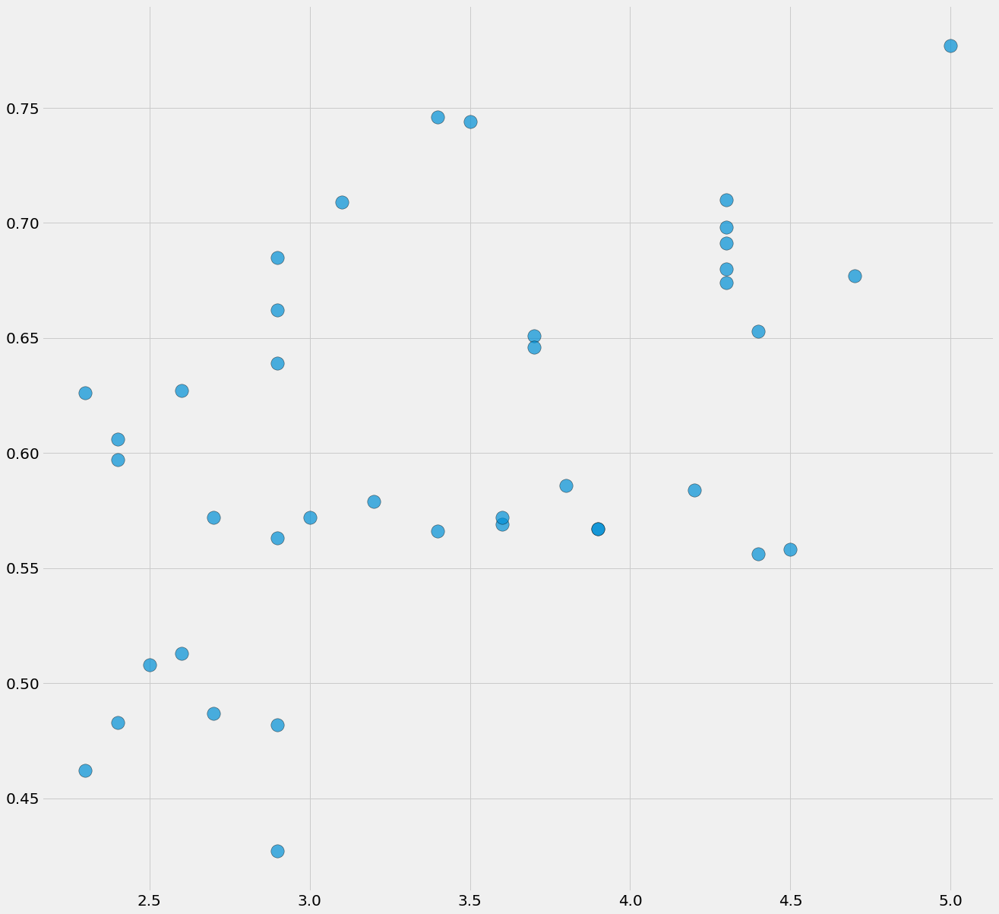

In [122]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(x=top_df.PTS, y=top_df.TS_PCT, s=300, alpha=0.7, edgecolors='black')


ax.tick_params(labelsize=20)

In [138]:
seasons = [f"{item}-{str(item+1)[-2:]}" for item in range(2016, 2021)]

In [140]:
dfs = []
for season in seasons:
    base_data = LeagueDashPlayerClutch(season=season, per_mode_detailed='Totals') 
    cur_df = base_data.get_data_frames()[0]
    cur_df.loc[:, 'SEASON'] = season
    dfs.append(cur_df)
    time.sleep(0.2)

In [141]:
concat_df = pd.concat(dfs)

In [142]:
murray_only = concat_df.loc[concat_df.PLAYER_ID == find_players_by_full_name('Jamal Murray')[0]['id']]

In [143]:
murray_only.PTS, murray_only.PTS / (2 * (murray_only.FGA + 0.44 * murray_only.FTA))

(165    12
 176    86
 189    76
 192    82
 178    81
 Name: PTS, dtype: int64, 165    0.338600
 176    0.624274
 189    0.476429
 192    0.505424
 178    0.679530
 dtype: float64)

In [144]:
murray_only.FTA

165    13
176    27
189    29
192    23
178    15
Name: FTA, dtype: int64

## Passing heatmap

In [4]:
from nba_api.stats.endpoints.playerdashboardbyshootingsplits import PlayerDashboardByShootingSplits

In [5]:
base_data = LeagueDashPlayerStats(per_mode_detailed='PerGame', season='2020-21')
base_df = base_data.get_data_frames()[0]

In [6]:
denver_players = base_df.loc[base_df.TEAM_ABBREVIATION == 'DEN']

In [7]:
top_denver = denver_players.sort_values(by='MIN', ascending=False).iloc[:10]

In [8]:
assist_dfs = []
for index in range(len(top_denver)):
    item = top_denver.iloc[index]
    shot_dash = PlayerDashboardByShootingSplits(player_id=item.PLAYER_ID, season='2020-21')
    df = shot_dash.get_data_frames()[-1]
    df.loc[:, 'TARGET_PLAYER'] = item.PLAYER_NAME
    assist_dfs.append(df)
    time.sleep(0.2)

In [9]:
full_assists = pd.concat(assist_dfs)

In [10]:
corrected_names = [f"{item.split(',')[1].strip()} {item.split(',')[0].strip()}" for item in full_assists.PLAYER_NAME]

In [11]:
full_assists.loc[:, 'PLAYER_NAME'] = corrected_names

In [12]:
unique_targets = full_assists.TARGET_PLAYER.unique().tolist()

In [13]:
interesting_data = full_assists.loc[:, ['PLAYER_NAME', 'FGA', 'TARGET_PLAYER']]

In [19]:
interesting_data = interesting_data.loc[interesting_data.PLAYER_NAME.isin(top_denver.PLAYER_NAME.tolist())]

In [20]:
pivoted = interesting_data.pivot(index='PLAYER_NAME', columns='TARGET_PLAYER', values='FGA').fillna(0.0)

In [21]:
pivoted.iloc[0].keys()

Index(['Aaron Gordon', 'Facundo Campazzo', 'JaMychal Green', 'Jamal Murray',
       'Michael Porter Jr.', 'Monte Morris', 'Nikola Jokic', 'PJ Dozier',
       'Paul Millsap', 'Will Barton'],
      dtype='object', name='TARGET_PLAYER')

Text(0.4, 12.25, 'source: nba.com')

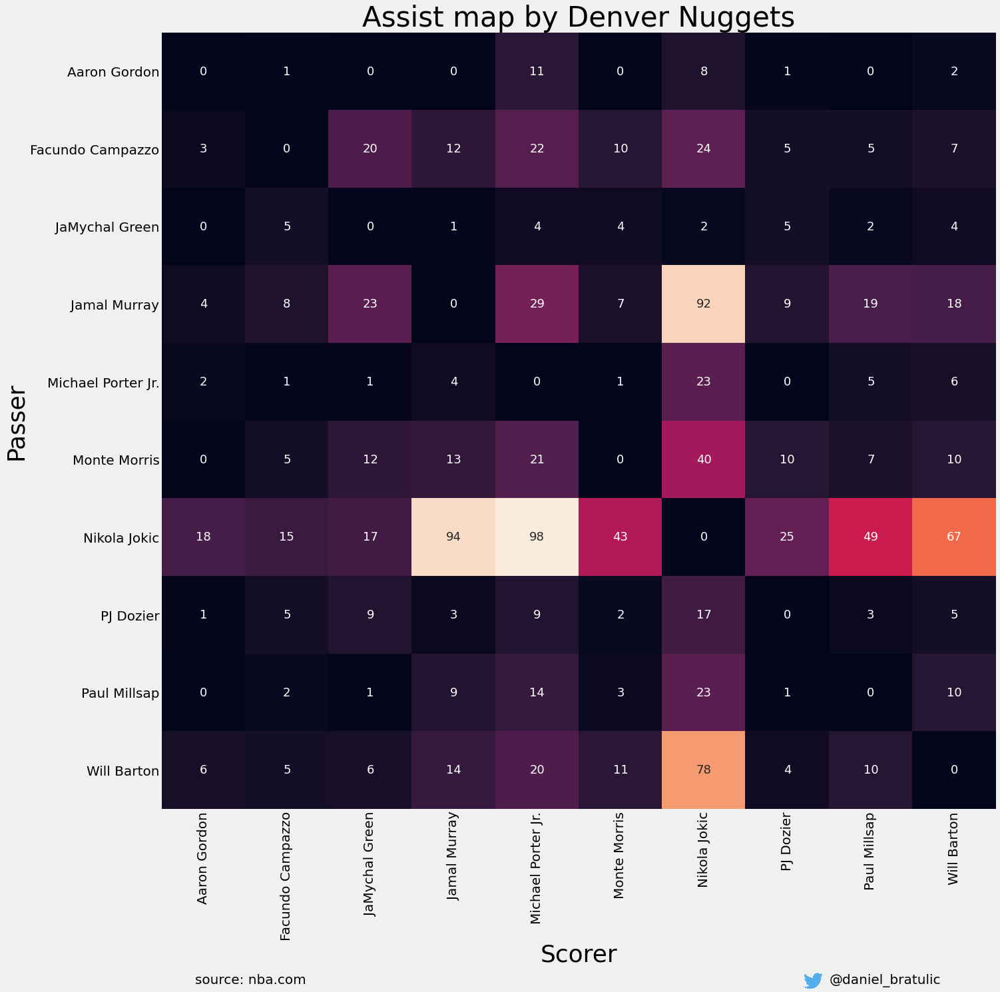

In [22]:
fig, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(pivoted, cbar=False, annot=True, annot_kws={'size': 18})

ax.tick_params(labelsize=20)
ax.set_xticklabels(pivoted.iloc[0].keys(), rotation=90)

ax.set_xlabel("Scorer", size=36)
ax.set_ylabel("Passer", size=36)
ax.set_title("Assist map by Denver Nuggets", size=42)

y_coord = len(pivoted)+2.25

offset_image = OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.025, )

#ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (0.88, len(pivoted)+0.5), frameon=False)

offset_image.set_offset((1200, -5))
ax.add_artist(offset_image)
ax.text(x=len(pivoted)-2, y=y_coord, ha='left', s='@daniel_bratulic', size=20)
ax.text(x=0.4, y=y_coord, ha='left', s='source: nba.com', size=20)

## Phoenix

In [71]:
denver_players = base_df.loc[base_df.TEAM_ABBREVIATION == 'DAL']


In [76]:
denver_players = denver_players.loc[(denver_players.GP > 30) & (denver_players.PLAYER_NAME != 'JJ Redick')]

In [80]:

top_denver = denver_players.sort_values(by='MIN', ascending=False).iloc[:7]


In [81]:
top_denver

,PLAYER_ID,PLAYER_NAME,TEAM_ID,TEAM_ABBREVIATION,AGE,GP,W,L,W_PCT,MIN,...,BLKA_RANK,PF_RANK,PFD_RANK,PTS_RANK,PLUS_MINUS_RANK,NBA_FANTASY_PTS_RANK,DD2_RANK,TD3_RANK,CFID,CFPARAMS
322,1629029,Luka Doncic,1610612742,DAL,22.0,48,28,20,0.583,35.0,...,57,113,9,6,80,5,19,4,5,"1629029,1610612742"
137,1627827,Dorian Finney-Smith,1610612742,DAL,27.0,42,24,18,0.571,32.1,...,227,71,289,207,88,176,148,27,5,"1627827,1610612742"
263,1626196,Josh Richardson,1610612742,DAL,27.0,43,24,19,0.558,32.0,...,217,66,147,128,271,144,208,27,5,"1626196,1610612742"
304,204001,Kristaps Porzingis,1610612742,DAL,25.0,34,20,14,0.588,31.0,...,70,43,48,37,133,36,24,27,5,"204001,1610612742"
474,203501,Tim Hardaway Jr.,1610612742,DAL,29.0,52,29,23,0.558,28.6,...,184,301,123,70,242,139,208,27,5,"203501,1610612742"
348,1628467,Maxi Kleber,1610612742,DAL,29.0,38,24,14,0.632,27.9,...,422,86,287,248,67,206,208,27,5,"1628467,1610612742"
214,1628973,Jalen Brunson,1610612742,DAL,24.0,49,27,22,0.551,25.6,...,340,237,71,122,79,157,148,27,5,"1628973,1610612742"


In [82]:

assist_dfs = []
for index in range(len(top_denver)):
    item = top_denver.iloc[index]
    shot_dash = PlayerDashboardByShootingSplits(player_id=item.PLAYER_ID, season='2020-21')
    df = shot_dash.get_data_frames()[-1]
    df.loc[:, 'TARGET_PLAYER'] = item.PLAYER_NAME
    assist_dfs.append(df)
    time.sleep(0.2)

In [83]:
full_assists = pd.concat(assist_dfs)

corrected_names = [f"{item.split(',')[1].strip()} {item.split(',')[0].strip()}" for item in full_assists.PLAYER_NAME]

full_assists.loc[:, 'PLAYER_NAME'] = corrected_names
interesting_data = full_assists.loc[:, ['PLAYER_NAME', 'FGA', 'TARGET_PLAYER']]

interesting_data = interesting_data.loc[interesting_data.PLAYER_NAME.isin(top_denver.PLAYER_NAME.tolist())]
pivoted = interesting_data.pivot(index='PLAYER_NAME', columns='TARGET_PLAYER', values='FGA').fillna(0.0)

Text(0.4, 8.75, 'source: nba.com')

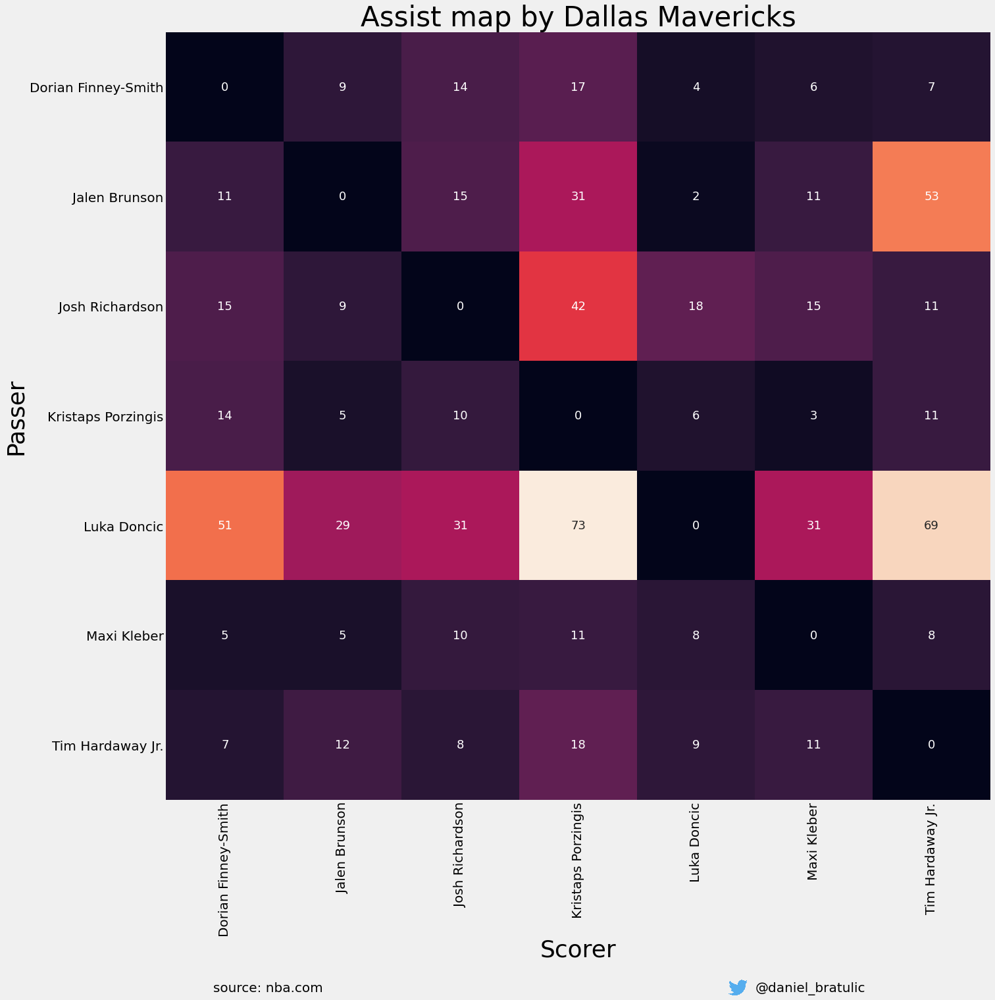

In [86]:
fig, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(pivoted.astype(np.int32), cbar=False, annot=True, annot_kws={'size': 18}, fmt="d")

ax.tick_params(labelsize=20)
ax.set_xticklabels(pivoted.iloc[0].keys(), rotation=90)
ax.set_yticklabels(pivoted.iloc[0].keys(), rotation=0)

ax.set_xlabel("Scorer", size=36)
ax.set_ylabel("Passer", size=36)
ax.set_title("Assist map by Dallas Mavericks", size=42)

y_coord = len(pivoted)+1.75

offset_image = OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.025, )

#ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (0.88, len(pivoted)+0.5), frameon=False)

offset_image.set_offset((1100, -3))
ax.add_artist(offset_image)
ax.text(x=len(pivoted)-2, y=y_coord, ha='left', s='@daniel_bratulic', size=20)
ax.text(x=0.4, y=y_coord, ha='left', s='source: nba.com', size=20)

## Efficiency > 15ppg

In [96]:
base_data = LeagueDashPlayerStats(per_mode_detailed='PerGame', season='2020-21')


In [97]:

adv_data = LeagueDashPlayerStats(per_mode_detailed='PerGame', season='2020-21', measure_type_detailed_defense='Advanced')

In [98]:
base_df = base_data.get_data_frames()[0]

adv_df = adv_data.get_data_frames()[0]

merged_df = pd.merge(left=base_df, right=adv_df, on=('PLAYER_ID', 'PLAYER_NAME'))

In [105]:
over_fifteen = merged_df.loc[(merged_df.GP_x > 20) & (merged_df.PTS > 15)]

In [112]:
over_fifteen.loc[:, 'EFG_PCT'] = over_fifteen.EFG_PCT * 100

c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\pandas\core\indexing.py:480: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


In [113]:
top_efg_pct = over_fifteen.sort_values(by='EFG_PCT', ascending=False).iloc[:5]

In [114]:
other = over_fifteen.sort_values(by='EFG_PCT', ascending=False).iloc[5:]

In [130]:
top_efg_pct.iloc[3].EFG_PCT

60.4

15

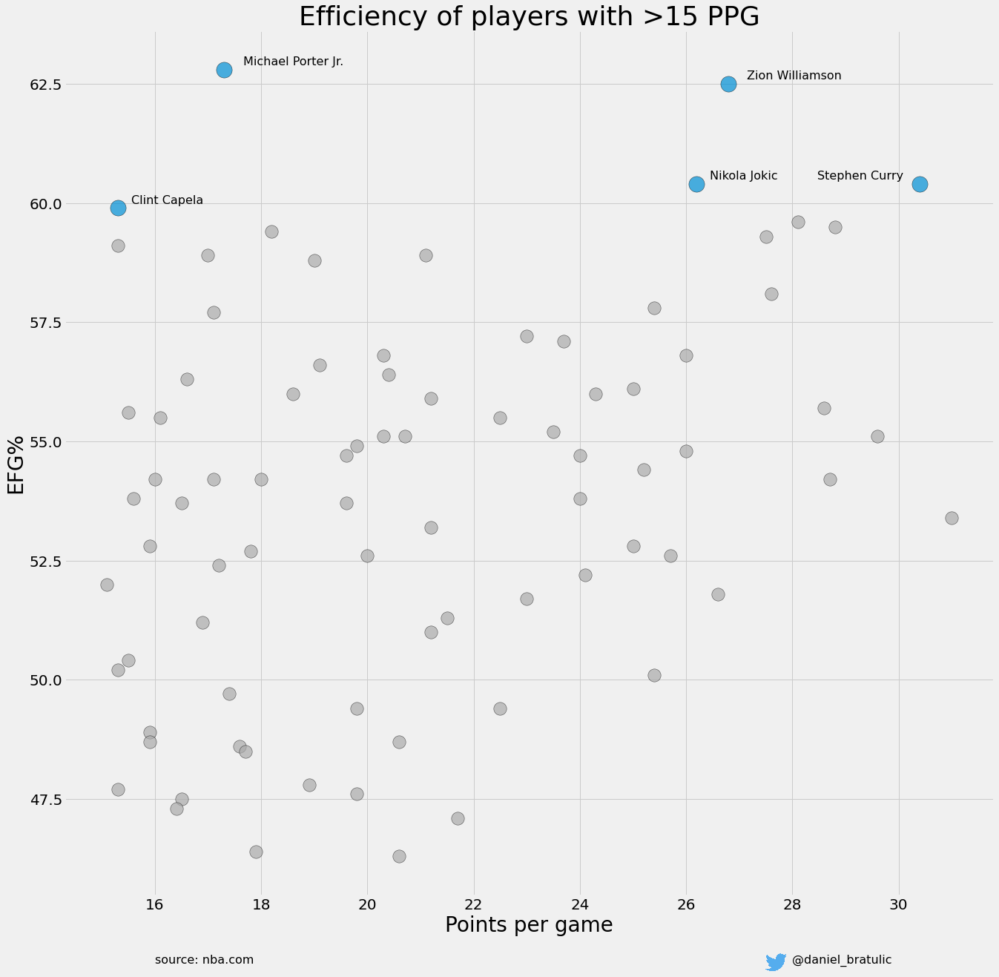

In [126]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(x=other.PTS, y=other.EFG_PCT, s=300, alpha=0.7, edgecolors='black', color='#ABABAB')
ax.scatter(x=top_efg_pct.PTS, y=top_efg_pct.EFG_PCT, s=450, alpha=0.7, edgecolors='black',)

texts = []
for index in range(len(top_efg_pct)):
    item = top_efg_pct.iloc[index]
    texts.append(ax.text(x=item.PTS, y=item.EFG_PCT, s=item.PLAYER_NAME, size=16))

ax.tick_params(labelsize=20)
ax.set_title("Efficiency of players with >15 PPG", size=36)
ax.set_xlabel("Points per game", size=28)
ax.set_ylabel("EFG%", size=28)

y_coord = min(other.EFG_PCT) - 2.25

offset_image = OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.025, )

#ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (0.88, len(pivoted)+0.5), frameon=False)

offset_image.set_offset((1025, -2))
ax.add_artist(offset_image)
ax.text(x=28, y=y_coord, ha='left', s='@daniel_bratulic', size=16)
ax.text(x=16, y=y_coord, ha='left', s='source: nba.com', size=16)
adjust_text(texts, expand_points=(1.4, 1.4))


## MPJ sophmore season comparison

In [4]:
seasons = [f"{item}-{str(item+1)[2:]}" for item in range(2003, 2021)]

In [5]:
base_dfs = []
adv_dfs = []
for season in seasons:
    base_df = LeagueDashPlayerStats(season=season, player_experience_nullable='Sophomore', per_mode_detailed='PerGame').get_data_frames()[0]
    time.sleep(0.2)
    adv_df = LeagueDashPlayerStats(season=season, measure_type_detailed_defense='Advanced', player_experience_nullable='Sophomore', per_mode_detailed='PerGame').get_data_frames()[0]
    time.sleep(0.2)
    base_df.loc[:, 'SEASON'] = season
    adv_df.loc[:, 'SEASON'] = season
    adv_dfs.append(adv_df)
    base_dfs.append(base_df)

In [6]:
concat_base = pd.concat(base_dfs)
concat_adv = pd.concat(adv_dfs)

In [7]:
merged_df = pd.merge(left=concat_base, right=concat_adv, on=('PLAYER_ID', 'PLAYER_NAME'))

In [8]:
merged_df = merged_df.loc[(merged_df.GP_x > 30)]

In [9]:
merged_df.loc[:, 'EFG_PCT'] = merged_df.EFG_PCT * 100
merged_df.loc[:, 'TS_PCT'] = merged_df.TS_PCT * 100

In [10]:
top_pts = merged_df.sort_values(by='PTS', ascending=False).iloc[:10]

In [11]:
top_efg = merged_df.loc[merged_df.PTS > 9.5].sort_values(by='EFG_PCT', ascending=False).iloc[:5]

In [12]:
interesting = pd.concat([top_pts, top_efg])

In [13]:
mpj = interesting.loc[interesting.PLAYER_NAME == 'Michael Porter Jr.']

In [14]:
other = merged_df.loc[~merged_df.PLAYER_ID.isin(interesting)]

Text(0, 21, 'source: nba.com')

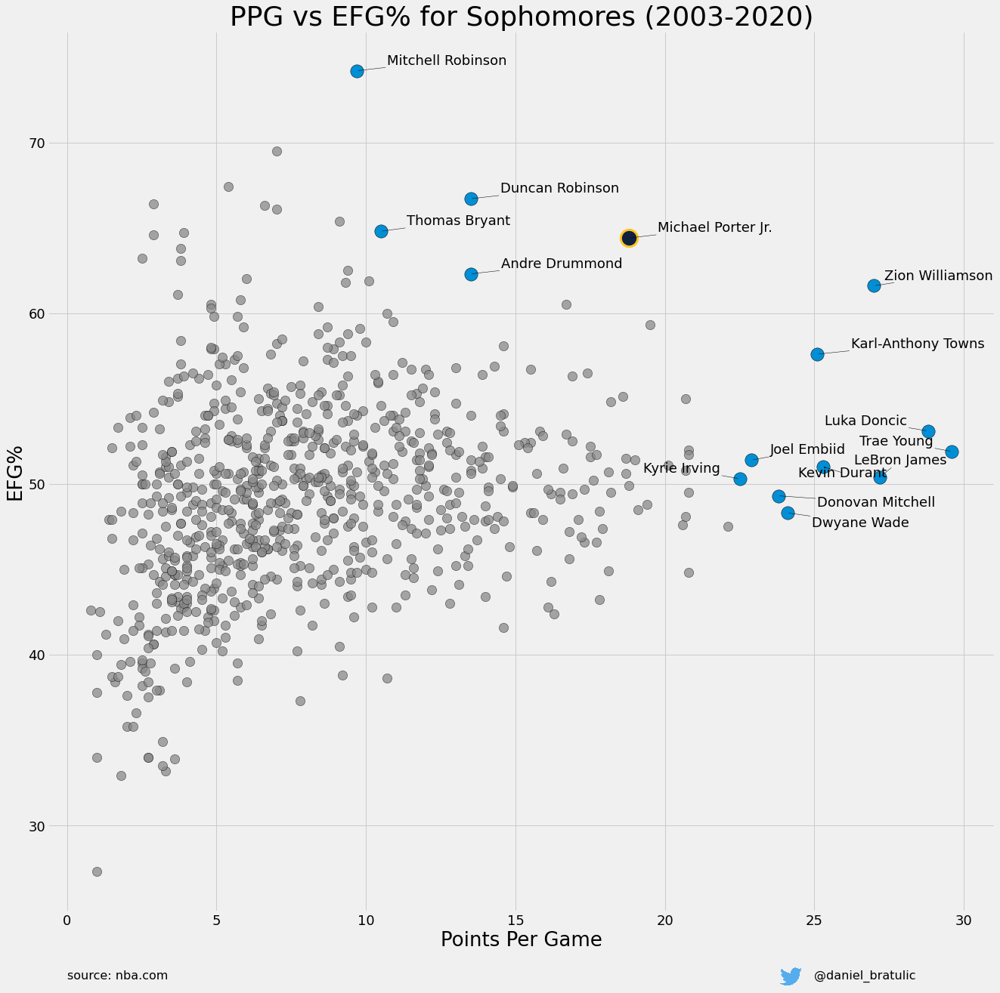

In [15]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(x=other.PTS, y=other.EFG_PCT, s=150, color='#898989', edgecolors='black', alpha=0.75)
ax.scatter(x=interesting.PTS, y=interesting.EFG_PCT, s=300, edgecolors='black')
ax.scatter(x=mpj.PTS, y=mpj.EFG_PCT, s=500, color='#0E2240', edgecolors='#FEC524', lw=3)
ax.set_xlabel("Points Per Game", size=26)
ax.set_ylabel("EFG%", size=26)
ax.set_title("PPG vs EFG% for Sophomores (2003-2020)", size=36)

texts = []
for index in range(len(interesting)):
    item = interesting.iloc[index]
    texts.append(ax.text(x=item.PTS, y=item.EFG_PCT, s=item.PLAYER_NAME, size=18))

ax.tick_params(labelsize=18)
adjust_text(texts, expand_points=(1.5, 1.5), arrowprops={'arrowstyle': '-', 'color': 'black'})

offset_image = OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.025, )

#ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (0.88, len(pivoted)+0.5), frameon=False)
y_coord = 21
offset_image.set_offset((1025, 0))
ax.add_artist(offset_image)
ax.text(x=25, y=y_coord, ha='left', s='@daniel_bratulic', size=16)
ax.text(x=0, y=y_coord, ha='left', s='source: nba.com', size=16)


### Tracking and Play Type

In [146]:
from nba_api.stats.endpoints.synergyplaytypes import SynergyPlayTypes
from nba_api.stats.endpoints.leaguedashptstats import LeagueDashPtStats


In [147]:

import matplotlib.pyplot as plt
import pandas as pd
from math import pi

def plot_radar(
    title,
    data,
    labels,
    colors,
    alphas,
    ax=None
):
    # number of variable
    categories=list(data[0].tolist())
    N = len(categories)

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]

    # Initialise the spider plot
    if ax is None:
        fig = plt.figure(figsize=(12, 12))
        ax = plt.subplot(111, polar=True)

    # If you want the first axis to be on top:
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)

    # Draw one axe per variable + add labels labels yet
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels([item.replace("_", " ") for item in data[0].index.tolist()])
    for label,i in zip(ax.get_xticklabels(),range(0,len(angles))):

        angle_rad=angles[i]
        if angle_rad <= pi/2:
            ha= 'left'
            va= "bottom"
            angle_text=angle_rad*(-180/pi)+90
        elif pi/2 < angle_rad <= pi:
            ha= 'left'
            va= "top"
            angle_text=angle_rad*(-180/pi)+90
        elif pi < angle_rad <= (3*pi/2):
            ha= 'right'
            va= "top"  
            angle_text=angle_rad*(-180/pi)-90
        else:
            ha= 'right'
            va= "bottom"
            angle_text=angle_rad*(-180/pi)-90
        label.set_rotation(angle_text)
        label.set_verticalalignment(va)
        label.set_horizontalalignment(ha)


    # Draw ylabels
    ax.set_rlabel_position(0)
    #items = [item / 10 for item in range(0, 55, 10)]
    #plt.yticks(items, map(str, items), size=12)
    #ax.spines['polar'].set_color('#cbcbcb')
    #ax.spines['polar'].set_linewidth('1')
    
    max_val = max([item.max() for item in data])
    ax.set_ylim(0, max_val)
    ax.spines['polar'].set_visible(False)

    ax.set_title(title, color='black', size=20, pad=20)
    
    for i in range(len(data)):
    
        cur_data = data[i]
        values=cur_data.tolist()
        values += values[:1]
        ax.plot(angles, values, linewidth=2, linestyle='solid', label=labels[i], color=colors[i])
        ax.fill(angles, values, colors[i], alpha=alphas[i])
    
    legend = ax.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1), fontsize=12)
    
    #ax.set_yticks([item for item in range(0, 45, 10)])
    #ax.set_yticklabels([f"{item}" for item in range(0, 45, 10)], size=12)


    ax.set_frame_on(False)
    ax.set_axisbelow(True)
    #ax.set_facecolor(bball_gray)
    #fig.set_facecolor(bball_gray)

In [148]:
play_types = [
    "PRBallHandler",
    "Isolation",
    "Transition",
    "Spotup",
    "Handoff",
    "OffScreen",
    "Cut",
    "OffRebound",
    "Postup",
    "PRRollman",
]

play_types_seasons = {}


    
def download_play_type_data(season='2019-20'):
    
    play_type_dict = {}
    if season not in play_types_seasons:
        print("Retrieving play types...")
        for play in play_types:
            synergy = SynergyPlayTypes(player_or_team_abbreviation='P', play_type_nullable=play, type_grouping_nullable="offensive", per_mode_simple="PerGame", season=season)
            synergy_df = synergy.get_data_frames()[0]
            play_type_dict[play] = synergy_df
            time.sleep(1)
        play_types_seasons[season] = play_type_dict
    else:
        play_type_dict = play_types_seasons[season]

    
    return play_type_dict




In [149]:
def get_interesting_data(df, target_column):
    final_df = None
    for index, play in enumerate(play_types):
        columns = ["PLAYER_NAME", target_column]
        result = df[play].loc[:, columns]
        result = result.rename(columns={target_column: f'{target_column}_{play}'})
        if index == 0:
            final_df = result
        else:
            final_df = pd.merge(left=final_df, right=result, on='PLAYER_NAME', how='outer')
    return final_df


def get_merged_data(first_year, second_year, target_column):
    
    target_columns = [
        f"{target_column}_PRBallHandler",
        f"{target_column}_Isolation",
        f"{target_column}_Transition",
        f"{target_column}_Spotup",
        f"{target_column}_Handoff",
        f"{target_column}_OffScreen",
        f"{target_column}_Cut",
        f"{target_column}_OffRebound",
        f"{target_column}_Postup",
        f"{target_column}_PRRollman",
    ]

    
    
    first_df = get_interesting_data(first_year, target_column)
    second_df = get_interesting_data(second_year, target_column)
    merged_df = pd.merge(left=first_df, right=second_df, on='PLAYER_NAME', suffixes=('_last', '_cur'))
    for play in play_types:
        merged_df.loc[:, f'{play}_diff'] = (merged_df[f'{target_column}_{play}_cur'] - merged_df[f'{target_column}_{play}_last'])**2
        
    merged_df.loc[:, "LAST_NORM"] = ((merged_df.loc[:, [f"{item}_last" for item in target_columns]]) ** 2).sum(axis=1) ** (1/2)
    merged_df.loc[:, "CUR_NORM"] = ((merged_df.loc[:, [f"{item}_cur" for item in target_columns]]) ** 2).sum(axis=1) ** (1/2)
    
    dot_product = []
    for i in range(len(merged_df)):
        last_numpy = merged_df.loc[:, [f"{item}_last" for item in target_columns]].to_numpy()[i]
        cur_numpy = merged_df.loc[:, [f"{item}_cur" for item in target_columns]].to_numpy()[i]
        dot_product.append(last_numpy.dot(cur_numpy))
    merged_df.loc[:, "DOT_PRODUCT"] = dot_product
    return merged_df
    

In [328]:
seasons = [f"{item}-{str(item+1)[2:]}" for item in range(2015, 2021)]

In [337]:
ptc_dfs = []
for season in seasons:
    df = download_play_type_data(season=season)
    cur_df = get_interesting_data(df, 'POSS_PCT').fillna(0.01)
    cur_df.loc[:, 'SEASON'] = season
    ptc_dfs.append(cur_df)

In [338]:
concat_pt = pd.concat(ptc_dfs)

In [339]:
def calculate_similarity(df, target_row):
    other_rows = df.loc[(df.PLAYER_NAME != target_row.PLAYER_NAME) & (df.SEASON != target_row.SEASON)]
    target_columns = [item for item in df.columns if 'POSS_PCT' in item]
    comparisons = []
    for i in range(len(df)):
        item = df.iloc[i]
        cur_team = item.loc[target_columns].to_numpy()
        target_team = target_row.loc[target_columns].to_numpy()
        cur_norm = (cur_team ** 2).sum() ** (1/2)
        target_norm = (target_team ** 2).sum() ** (1/2)
        cosine_similarity = cur_team.dot(target_team) / (cur_norm * target_norm)
        comparisons.append(
            {
                'PLAYER_NAME': item.PLAYER_NAME,
                'SEASON': item.SEASON,
                'COSINE_SIMILARITY': cosine_similarity
            }
        )
    return pd.DataFrame(comparisons)


In [340]:
porter_jr = concat_pt.loc[(concat_pt.PLAYER_NAME == 'Michael Porter Jr.') & (concat_pt.SEASON == '2020-21')].iloc[0]

In [341]:
porter_sim_df = calculate_similarity(concat_pt, porter_jr)

In [342]:
porter_sim_df = porter_sim_df.drop_duplicates(('PLAYER_NAME', 'SEASON'))

In [343]:
porter_sim_df.loc[porter_sim_df.PLAYER_NAME == 'Kevin Durant']

,PLAYER_NAME,SEASON,COSINE_SIMILARITY
31,Kevin Durant,2015-16,0.697057
2142,Kevin Durant,2016-17,0.852699
4075,Kevin Durant,2017-18,0.755959
8122,Kevin Durant,2018-19,0.700073
14403,Kevin Durant,2020-21,0.813212


In [344]:
porter_sim_df.loc[porter_sim_df.PLAYER_NAME == 'Klay Thompson']

,PLAYER_NAME,SEASON,COSINE_SIMILARITY
458,Klay Thompson,2015-16,0.788565
2299,Klay Thompson,2016-17,0.795411
5731,Klay Thompson,2017-18,0.731878
9563,Klay Thompson,2018-19,0.736799


In [270]:
porter_sim_df.sort_values(by='COSINE_SIMILARITY', ascending=False).iloc[:50]

,PLAYER_NAME,SEASON,COSINE_SIMILARITY
14851,Michael Porter Jr.,2020-21,1.000000
14547,Kelly Oubre Jr.,2020-21,0.989010
1270,Thabo Sefolosha,2015-16,0.987143
2302,Gary Harris,2016-17,0.986094
11169,Justin Jackson,2018-19,0.985309
7217,Justin Anderson,2017-18,0.983573
6086,Justin Jackson,2017-18,0.982625
1303,Maurice Harkless,2015-16,0.978584
1353,Kelly Oubre Jr.,2015-16,0.978290
13233,Josh Okogie,2019-20,0.978216


In [346]:
porter_jr = concat_pt.loc[(concat_pt.PLAYER_NAME == 'Michael Porter Jr.') & (concat_pt.SEASON == '2020-21')]
warren = concat_pt.loc[(concat_pt.PLAYER_NAME == 'T.J. Warren') & (concat_pt.SEASON == '2018-19')]
lavine = concat_pt.loc[(concat_pt.PLAYER_NAME == 'Zach LaVine') & (concat_pt.SEASON == '2019-20')]
durant = concat_pt.loc[(concat_pt.PLAYER_NAME == 'Kevin Durant') & (concat_pt.SEASON == '2015-16')]
oubre = concat_pt.loc[(concat_pt.PLAYER_NAME == 'Kelly Oubre Jr.') & (concat_pt.SEASON == '2020-21')]
brown = concat_pt.loc[(concat_pt.PLAYER_NAME == 'Jaylen Brown') & (concat_pt.SEASON == '2017-18')]

In [347]:
porter_jr

,PLAYER_NAME,POSS_PCT_PRBallHandler,POSS_PCT_Isolation,POSS_PCT_Transition,POSS_PCT_Spotup,POSS_PCT_Handoff,POSS_PCT_OffScreen,POSS_PCT_Cut,POSS_PCT_OffRebound,POSS_PCT_Postup,POSS_PCT_PRRollman,SEASON
1167,Michael Porter Jr.,0.042,0.036,0.213,0.255,0.082,0.085,0.139,0.073,0.023,0.01,2020-21


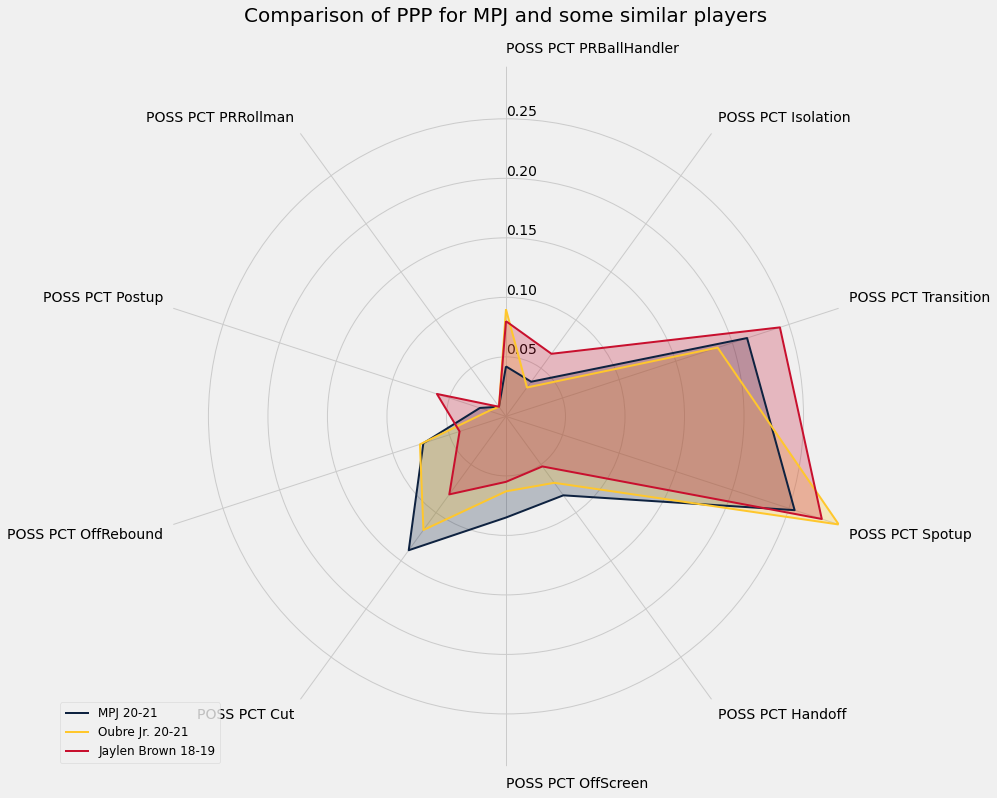

In [348]:
plot_radar(
    title="Comparison of PPP for MPJ and some similar players",
    data=[porter_jr.iloc[0][1:-1], oubre.iloc[0][1:-1], brown.iloc[0][1:-1]],
    labels=["MPJ 20-21", "Oubre Jr. 20-21", "Jaylen Brown 18-19"],
    colors=[
        "#0E2240",
        "#FFC72C",
        "#C8102E"
    ],
    alphas=[0.25, 0.25, 0.25]
)

### Tracking differences

In [275]:
denver_id = find_teams_by_full_name("Denver Nuggets")[0]['id']

In [280]:
tracking_eff_before = LeagueDashPtStats(per_mode_simple='PerGame', pt_measure_type='Efficiency', date_to_nullable='04-14-2021', player_or_team='Player', team_id_nullable=denver_id).get_data_frames()[0]

In [281]:
tracking_eff_after = LeagueDashPtStats(per_mode_simple='PerGame', pt_measure_type='Efficiency', date_from_nullable='04-15-2021', player_or_team='Player', team_id_nullable=denver_id).get_data_frames()[0]

In [283]:
tracking_eff_after = tracking_eff_after.loc[tracking_eff_after.GP > 7]

In [284]:
merged_df = pd.merge(left=tracking_eff_before, right=tracking_eff_after, on=('PLAYER_ID', 'PLAYER_NAME'), suffixes=('_BEFORE', '_AFTER'))

In [326]:
tracking_eff_before

,PLAYER_ID,PLAYER_NAME,TEAM_ID,TEAM_ABBREVIATION,GP,W,L,MIN,POINTS,DRIVE_PTS,...,CATCH_SHOOT_FG_PCT,PULL_UP_PTS,PULL_UP_FG_PCT,PAINT_TOUCH_PTS,PAINT_TOUCH_FG_PCT,POST_TOUCH_PTS,POST_TOUCH_FG_PCT,ELBOW_TOUCH_PTS,ELBOW_TOUCH_FG_PCT,EFF_FG_PCT
0,203932,Aaron Gordon,1610612743,DEN,10,8,2,27.8,11.8,0.8,...,0.333,0.4,0.222,6.5,0.829,1.0,0.833,1.5,1.000,0.627
1,1629626,Bol Bol,1610612743,DEN,23,15,8,5.0,2.5,0.3,...,0.333,0.9,0.500,0.2,1.000,0.2,1.000,0.1,1.000,0.622
2,1630267,Facundo Campazzo,1610612743,DEN,49,32,17,18.8,5.1,0.8,...,0.430,0.8,0.237,0.1,1.000,0.0,0.000,0.0,1.000,0.523
3,1629109,Gary Clark,1610612743,DEN,2,2,0,2.1,0.0,0.0,...,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.000
4,203914,Gary Harris,1610612753,ORL,19,11,8,30.6,9.7,2.1,...,0.379,0.3,0.150,1.0,0.778,0.0,0.000,0.3,0.400,0.519
5,204222,Greg Whittington,1610612743,DEN,4,3,1,3.0,0.0,0.0,...,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.000
6,1628392,Isaiah Hartenstein,1610612739,CLE,30,16,14,9.1,3.5,0.3,...,0.000,0.0,0.000,2.4,0.475,0.0,0.000,1.0,0.480,0.513
7,203210,JaMychal Green,1610612743,DEN,42,27,15,18.5,8.3,0.1,...,0.413,0.0,0.077,2.9,0.645,0.5,0.450,0.4,0.500,0.574
8,201580,JaVale McGee,1610612743,DEN,4,3,1,9.9,4.0,0.0,...,0.000,0.0,0.000,1.8,0.600,0.3,0.000,1.8,1.000,0.538
9,1627750,Jamal Murray,1610612743,DEN,48,31,17,35.5,21.2,5.6,...,0.440,9.3,0.412,1.2,0.615,0.3,0.545,0.8,0.714,0.559


In [286]:
merged_df.columns

Index(['PLAYER_ID', 'PLAYER_NAME', 'TEAM_ID_BEFORE',
       'TEAM_ABBREVIATION_BEFORE', 'GP_BEFORE', 'W_BEFORE', 'L_BEFORE',
       'MIN_BEFORE', 'POINTS_BEFORE', 'DRIVE_PTS_BEFORE',
       'DRIVE_FG_PCT_BEFORE', 'CATCH_SHOOT_PTS_BEFORE',
       'CATCH_SHOOT_FG_PCT_BEFORE', 'PULL_UP_PTS_BEFORE',
       'PULL_UP_FG_PCT_BEFORE', 'PAINT_TOUCH_PTS_BEFORE',
       'PAINT_TOUCH_FG_PCT_BEFORE', 'POST_TOUCH_PTS_BEFORE',
       'POST_TOUCH_FG_PCT_BEFORE', 'ELBOW_TOUCH_PTS_BEFORE',
       'ELBOW_TOUCH_FG_PCT_BEFORE', 'EFF_FG_PCT_BEFORE', 'TEAM_ID_AFTER',
       'TEAM_ABBREVIATION_AFTER', 'GP_AFTER', 'W_AFTER', 'L_AFTER',
       'MIN_AFTER', 'POINTS_AFTER', 'DRIVE_PTS_AFTER', 'DRIVE_FG_PCT_AFTER',
       'CATCH_SHOOT_PTS_AFTER', 'CATCH_SHOOT_FG_PCT_AFTER',
       'PULL_UP_PTS_AFTER', 'PULL_UP_FG_PCT_AFTER', 'PAINT_TOUCH_PTS_AFTER',
       'PAINT_TOUCH_FG_PCT_AFTER', 'POST_TOUCH_PTS_AFTER',
       'POST_TOUCH_FG_PCT_AFTER', 'ELBOW_TOUCH_PTS_AFTER',
       'ELBOW_TOUCH_FG_PCT_AFTER', 'EFF_FG_PCT_AF

In [287]:
columns = [item.split("_BEFORE")[0] for item in ['DRIVE_PTS_BEFORE',
'DRIVE_FG_PCT_BEFORE', 'CATCH_SHOOT_PTS_BEFORE',
'CATCH_SHOOT_FG_PCT_BEFORE', 'PULL_UP_PTS_BEFORE',
'PULL_UP_FG_PCT_BEFORE', 'PAINT_TOUCH_PTS_BEFORE',
'PAINT_TOUCH_FG_PCT_BEFORE', 'POST_TOUCH_PTS_BEFORE',
'POST_TOUCH_FG_PCT_BEFORE', 'ELBOW_TOUCH_PTS_BEFORE',]]

In [289]:
columns = [item for item in columns if 'PTS' in item]

In [294]:
columns

['DRIVE_PTS',
 'CATCH_SHOOT_PTS',
 'PULL_UP_PTS',
 'PAINT_TOUCH_PTS',
 'POST_TOUCH_PTS',
 'ELBOW_TOUCH_PTS']

In [291]:
merged_df = merged_df.loc[:, ['PLAYER_ID', 'PLAYER_NAME'] + [f"{item}_BEFORE" for item in columns] + [f"{item}_AFTER" for item in columns]]

In [292]:
merged_df

,PLAYER_ID,PLAYER_NAME,DRIVE_PTS_BEFORE,CATCH_SHOOT_PTS_BEFORE,PULL_UP_PTS_BEFORE,PAINT_TOUCH_PTS_BEFORE,POST_TOUCH_PTS_BEFORE,ELBOW_TOUCH_PTS_BEFORE,DRIVE_PTS_AFTER,CATCH_SHOOT_PTS_AFTER,PULL_UP_PTS_AFTER,PAINT_TOUCH_PTS_AFTER,POST_TOUCH_PTS_AFTER,ELBOW_TOUCH_PTS_AFTER
0,203932,Aaron Gordon,0.8,2.6,0.4,6.5,1.0,1.5,1.4,1.5,1.8,2.8,0.2,0.4
1,1630267,Facundo Campazzo,0.8,2.6,0.8,0.1,0.0,0.0,1.7,3.7,1.1,0.4,0.0,0.0
2,203210,JaMychal Green,0.1,4.4,0.0,2.9,0.5,0.4,0.2,3.2,0.2,3.0,0.6,0.0
3,1629008,Michael Porter Jr.,1.2,6.6,2.5,4.8,0.4,1.1,2.9,10.3,4.9,2.7,0.2,1.8
4,203999,Nikola Jokic,3.1,6.7,2.0,6.7,5.5,4.7,4.0,4.4,2.6,8.7,6.9,4.0
5,1628408,PJ Dozier,1.4,2.2,1.0,1.4,0.0,0.4,3.0,2.6,2.5,1.6,0.0,0.3
6,200794,Paul Millsap,0.9,2.8,0.5,3.0,0.8,0.4,1.8,1.4,0.9,2.2,1.8,0.7


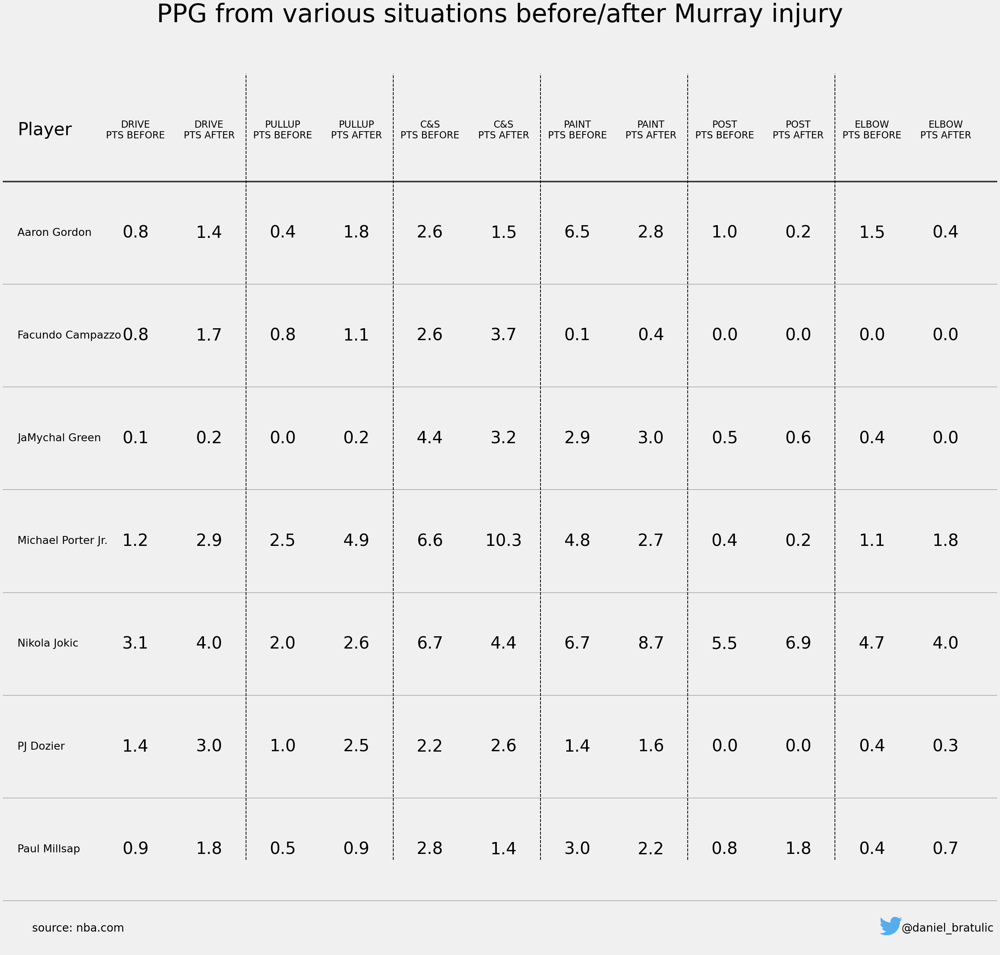

In [325]:
fig, ax = plt.subplots(figsize=(40, 40))
number_size = 42
font_size = 36
font_title = 44
title_size = 64
#top = 10

sorted_open_df = merged_df
top = len(merged_df)
for i in range(top):
    item = merged_df.iloc[i]
    try:
        player_id = find_players_by_full_name(item.PLAYER)[0]['id']
    except Exception:
        player_id = 1630191
        #continue
    y_coord = top - i - 1
    #if i % 2 == 1:
    #    color = '#EAE8E8'
    #    rect = Rectangle((-4.5, y_coord + 0.5), width=50, height=1, fill=True, color=color)
    #    ax.add_patch(rect)
    
    #ab = AnnotationBbox(get_player_img(player_id), (0.2, y_coord), frameon=False)
    #ax.add_artist(ab)
    #ax.text(x=0.25, y=y_coord, ha='left', va='center', s=item.SEASON, size=font_size)
    ax.text(x=0.2, y=y_coord, ha='left', va='center', s=item.PLAYER_NAME, size=number_size-15)
    ax.axhline(y=y_coord-0.5, xmin=-0.25, xmax=30, color='#A0A0A0', alpha=0.75, lw=2)


    ax.text(x=1.8, y=y_coord, ha='center', va='center', s=f"{item.DRIVE_PTS_BEFORE}", size=number_size)
    ax.text(x=2.8, y=y_coord, ha='center', va='center', s=f"{item.DRIVE_PTS_AFTER}", size=number_size)
    ax.text(x=3.8, y=y_coord, ha='center', va='center', s=f"{item.PULL_UP_PTS_BEFORE}", size=number_size)
    ax.text(x=4.8, y=y_coord, ha='center', va='center', s=f"{item.PULL_UP_PTS_AFTER}", size=number_size)
    ax.text(x=5.8, y=y_coord, ha='center', va='center', s=f"{item.CATCH_SHOOT_PTS_BEFORE}", size=number_size)
    ax.text(x=6.8, y=y_coord, ha='center', va='center', s=f"{item.CATCH_SHOOT_PTS_AFTER}", size=number_size)
    ax.text(x=7.8, y=y_coord, ha='center', va='center', s=f"{item.PAINT_TOUCH_PTS_BEFORE}", size=number_size)
    ax.text(x=8.8, y=y_coord, ha='center', va='center', s=f"{item.PAINT_TOUCH_PTS_AFTER}", size=number_size)
    ax.text(x=9.8, y=y_coord, ha='center', va='center', s=f"{item.POST_TOUCH_PTS_BEFORE}", size=number_size)
    ax.text(x=10.8, y=y_coord, ha='center', va='center', s=f"{item.POST_TOUCH_PTS_AFTER}", size=number_size)
    ax.text(x=11.8, y=y_coord, ha='center', va='center', s=f"{item.ELBOW_TOUCH_PTS_BEFORE}", size=number_size)
    ax.text(x=12.8, y=y_coord, ha='center', va='center', s=f"{item.ELBOW_TOUCH_PTS_AFTER}", size=number_size)

    #y_img_start = y_coord-0.5 + (1 - 0.730769232) / 2
    #ax.imshow(img, extent=(0, 1.36, y_img_start-0.5, y_img_start + 0.1), aspect='auto')
    #ax.imshow(img, extent=(0, 260, 0, 190), aspect=260/190)
    
#ax.text(x=0.25, y=top, s='Season', ha='left', va='center', size=font_title)

ax.text(x=0.2, y=top, s='Player', ha='left', va='center', size=font_title)
ax.text(x=1.8, y=top, ha='center', va='center', s="DRIVE\nPTS BEFORE", size=font_title-20)
ax.text(x=2.8, y=top, ha='center', va='center', s="DRIVE\nPTS AFTER", size=font_title-20)
ax.text(x=3.8, y=top, ha='center', va='center', s="PULLUP\nPTS BEFORE", size=font_title-20)
ax.text(x=4.8, y=top, ha='center', va='center', s="PULLUP\nPTS AFTER", size=font_title-20)
ax.text(x=5.8, y=top, ha='center', va='center', s="C&S\nPTS BEFORE", size=font_title-20)
ax.text(x=6.8, y=top, ha='center', va='center', s="C&S\nPTS AFTER", size=font_title-20)
ax.text(x=7.8, y=top, ha='center', va='center', s="PAINT\nPTS BEFORE", size=font_title-20)
ax.text(x=8.8, y=top, ha='center', va='center', s="PAINT\nPTS AFTER", size=font_title-20)
ax.text(x=9.8, y=top, ha='center', va='center', s="POST\nPTS BEFORE", size=font_title-20)
ax.text(x=10.8, y=top, ha='center', va='center', s="POST\nPTS AFTER", size=font_title-20)
ax.text(x=11.8, y=top, ha='center', va='center', s="ELBOW\nPTS BEFORE", size=font_title-20)
ax.text(x=12.8, y=top, ha='center', va='center', s="ELBOW\nPTS AFTER", size=font_title-20)
#ax.text(x=2.7, y=top, ha='center', va='center', s="Recovered%", size=font_title)

#ax.text(x=2.75, y=-0.75, s='twitter: @daniel_bratulic', ha='right', va='center', size=30)
#ax.text(x=0.25, y=-0.75, s='data: nba.com', ha='left', va='center', size=30)
ax.axhline(y=top-0.5, xmin=-0.25, xmax=30, color='black', alpha=0.75, lw=4)
ax.axvline(x=3.3, ymin=0.1, ymax=0.95, lw=2, color='black', ls='--')
ax.axvline(x=5.3, ymin=0.1, ymax=0.95, lw=2, color='black', ls='--')
ax.axvline(x=7.3, ymin=0.1, ymax=0.95, lw=2, color='black', ls='--')
ax.axvline(x=9.3, ymin=0.1, ymax=0.95, lw=2, color='black', ls='--')
ax.axvline(x=11.3, ymin=0.1, ymax=0.95, lw=2, color='black', ls='--')
ax.set_title("PPG from various situations before/after Murray injury", size=title_size)
    
ax.set_ylim(bottom=-1, top=top+1)
ax.set_xlim(left=-0, right=13.5)
ax.grid(False)
ax.set_frame_on(False)
ax.set_yticklabels([])
ax.set_xticklabels([])
ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (12.05, -0.75), frameon=False)
ax.add_artist(ab)
ax.text(x=12.2, y=-0.8, ha='left', s='@daniel_bratulic', size=28)
ax.text(x=0.4, y=-0.8, ha='left', s='source: nba.com', size=28)
plt.savefig('block_recoveries.png', dpi=120, bbox_inches='tight')

### Todo; 

* Usporedit MPJ-a baš s KD-om i Klayom (za njih mogu usporedit C&S i Pullup i to) -> DONE, ovo drugo ako stignem

* provjeri način igre nakon ozljede Murraya -> Moga bin tablicu s tracking podacima

* On off za napad/obranu -> Ispričat ili tablicu

* Pogledat čiji stil se najviše promjenio od ozljede -> TO

* Omjer free throwova i šuteva u paintu -> DONE

#### Obrana

* Koje pozicije imaju najviše šuteva u reketu protiv njih -> Stacked bar chart za C/F/G or Nah

* Hustle brojke za Campazza; pogledat možda steal ratinge i napredne neke metrike -> Done

* Provjerit matchupove -> SKORO DONE

* Izvuć tablicu za on/off razliku u obrani -> Otvorit si samo

* Defensive chartovi -> Ovo mogu ispucat možda

### Matchup game-per-game after injury

* Get playing time which defender spent time on offensive player

* 

In [30]:
finder = LeagueGameFinder(league_id_nullable='00', season_type_nullable='Regular Season', season_nullable='2020-21')

schedule_df = finder.get_data_frames()[0]

In [31]:
denver_schedule = schedule_df.loc[schedule_df.TEAM_ABBREVIATION == 'DEN']

In [32]:
post_murray = denver_schedule.loc[denver_schedule.GAME_DATE > '2021-04-14']

In [33]:
from nba_api.stats.endpoints.boxscorematchups import BoxScoreMatchups

In [34]:
matchup_dfs = []
for index in range(len(post_murray)):
    item = post_murray.iloc[index]
    matchups = BoxScoreMatchups(game_id=item.GAME_ID)
    matchup_df = matchups.get_data_frames()[0]
    matchup_df = matchup_df.loc[matchup_df.DEF_TEAM_ABBREVIATION == 'DEN']
    matchup_dfs.append(matchup_df)
    time.sleep(0.2)

In [35]:
full_matchup = pd.concat(matchup_dfs)

In [36]:
full_matchup.columns

Index(['GAME_ID', 'OFF_TEAM_ID', 'OFF_TEAM_ABBREVIATION', 'OFF_TEAM_CITY',
       'OFF_TEAM_NICKNAME', 'OFF_PLAYER_ID', 'OFF_PLAYER_NAME', 'DEF_TEAM_ID',
       'DEF_TEAM_ABBREVIATION', 'DEF_TEAM_CITY', 'DEF_TEAM_NICKNAME',
       'DEF_PLAYER_ID', 'DEF_PLAYER_NAME', 'MATCHUP_MIN', 'PARTIAL_POSS',
       'PCT_DEFENDER_TOTAL_TIME', 'PCT_OFF_TOTAL_TIME',
       'PCT_TOTAL_TIME_BOTH_ON', 'SWITCHES_ON', 'PLAYER_PTS', 'TEAM_PTS',
       'MATCHUP_AST', 'MATCHUP_POTENTIAL_AST', 'MATCHUP_TOV', 'MATCHUP_BLK',
       'MATCHUP_FGM', 'MATCHUP_FGA', 'MATCHUP_FG_PCT', 'MATCHUP_FG3M',
       'MATCHUP_FG3A', 'MATCHUP_FG3_PCT', 'HELP_BLK', 'HELP_FGM', 'HELP_FGA',
       'HELP_FG_PERC', 'MATCHUP_FTM', 'MATCHUP_FTA', 'SFL'],
      dtype='object')

In [37]:
full_matchup.loc[:, 'MATCHUP_SEC'] = [int(item.split(":")[0]) * 60 + int(item.split(":")[1]) for item in full_matchup.MATCHUP_MIN]

In [38]:
matchups_grouped = full_matchup.groupby(('DEF_PLAYER_NAME', 'OFF_PLAYER_NAME')).agg(
    {
        'PARTIAL_POSS': 'sum',
        'PCT_DEFENDER_TOTAL_TIME': 'sum',
        'PCT_OFF_TOTAL_TIME': 'sum',
        'PCT_TOTAL_TIME_BOTH_ON': 'sum',
        'SWITCHES_ON': 'sum',
        'PLAYER_PTS': 'sum',
        'TEAM_PTS': 'sum',
        'MATCHUP_AST': 'sum',
        'MATCHUP_POTENTIAL_AST': 'sum',
        'MATCHUP_TOV': 'sum',
        'MATCHUP_BLK': 'sum',
        'MATCHUP_FGM': 'sum',
        'MATCHUP_FGA': 'sum',
        'MATCHUP_FG_PCT': 'sum',
        'MATCHUP_FG3M': 'sum',
        'MATCHUP_FG3A': 'sum',
        'MATCHUP_FG3_PCT': 'sum',
        'HELP_BLK': 'sum',
        'HELP_FGM': 'sum',
        'HELP_FGA': 'sum',
        'HELP_FG_PERC': 'sum',
        'MATCHUP_FTM': 'sum',
        'MATCHUP_FTA': 'sum',
        'SFL': 'sum',
        'MATCHUP_SEC': 'sum'
    }
).reset_index()

c:\users\danie\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.
  """Entry point for launching an IPython kernel.


In [39]:
denver_players = matchups_grouped.DEF_PLAYER_NAME.unique()

In [40]:
top_8 = matchups_grouped.groupby('DEF_PLAYER_NAME').MATCHUP_SEC.sum().sort_values(ascending=False)[:8]

In [41]:
interesting_denver = matchups_grouped.loc[matchups_grouped.DEF_PLAYER_NAME.isin(list(top_8.index))]

In [51]:
len(list(top_8.index))

8

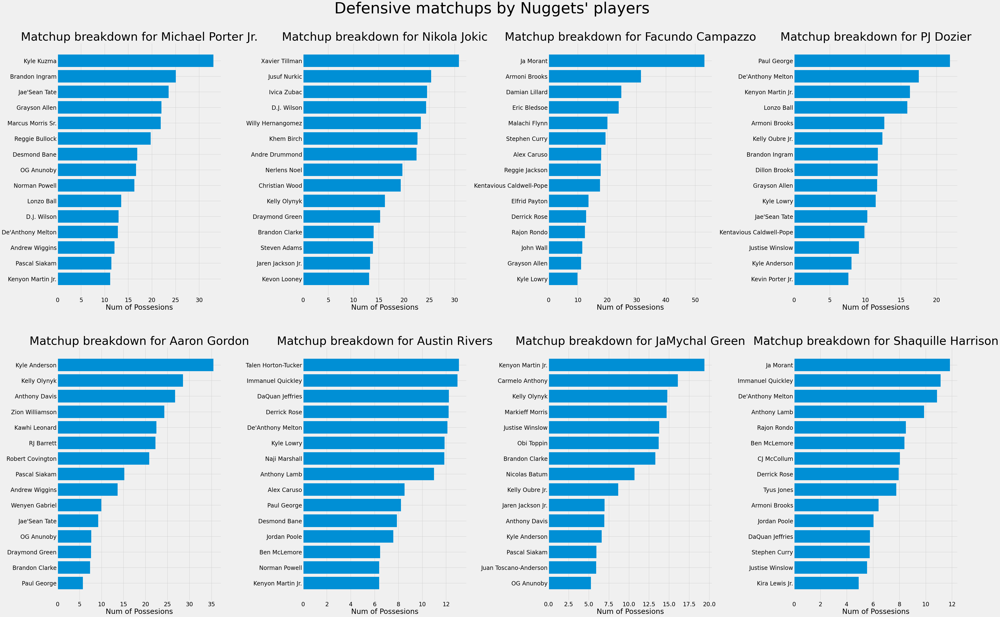

In [68]:
names = list(top_8.index)
fig, axes = plt.subplots(2, 4, figsize=(60, 40))
flat_ax = axes.flatten()
for index, player in enumerate(names):
    cur_player_df = interesting_denver.loc[interesting_denver.DEF_PLAYER_NAME == player]
    sort_data = cur_player_df.sort_values(by='PARTIAL_POSS', ascending=False).iloc[:15]
    target_data = sort_data.loc[:, ['DEF_PLAYER_NAME', 'OFF_PLAYER_NAME', 'PARTIAL_POSS']]
    target_data = target_data.sort_values(by='PARTIAL_POSS', ascending=True)
    cur_ax = flat_ax[index]
    cur_ax.barh(y=target_data.OFF_PLAYER_NAME, width=target_data.PARTIAL_POSS)
    cur_ax.set_title(f"Matchup breakdown for {player}", size=48)
    cur_ax.set_xlabel("Num of Possesions", size=30)
    cur_ax.tick_params(labelsize=24)
plt.suptitle("Defensive matchups by Nuggets' players", size=64, y=0.94)
plt.subplots_adjust(wspace=0.5)

### Hustle

In [69]:
from nba_api.stats.endpoints.leaguehustlestatsplayer import LeagueHustleStatsPlayer

In [122]:
league_df = LeagueHustleStatsPlayer(per_mode_time='PerGame', date_from_nullable='04-15-2021').get_data_frames()[0]

In [123]:
league_df = league_df.loc[(league_df.G > 5) & (league_df.MIN > 15)]

In [124]:
plt.style.use('fivethirtyeight')

In [125]:
base_df = LeagueDashPlayerStats(per_mode_detailed='PerGame', date_from_nullable='04-15-2021').get_data_frames()[0]

In [126]:
merged_df = pd.merge(left=league_df, right=base_df, on=('PLAYER_ID', 'PLAYER_NAME'))

In [138]:
top_deflections = merged_df.sort_values(by='DEFLECTIONS', ascending=False).iloc[:5]
top_contested = merged_df.sort_values(by='STL', ascending=False).iloc[:5]
campazzo = merged_df.loc[merged_df.PLAYER_NAME == 'Facundo Campazzo']
other_pl = top_contested.PLAYER_ID.tolist() + top_deflections.PLAYER_ID.tolist() + campazzo.PLAYER_ID.tolist()
other = merged_df.loc[~merged_df.PLAYER_ID.isin(other_pl)]

In [140]:
list(set(other_pl))

{202710, 204456, 1626153, 1627832, 1628384, 1629643, 1629680, 1630165, 1630267}

In [143]:
top_performers = pd.concat([top_deflections, top_contested, campazzo]).drop_duplicates('PLAYER_ID')

16

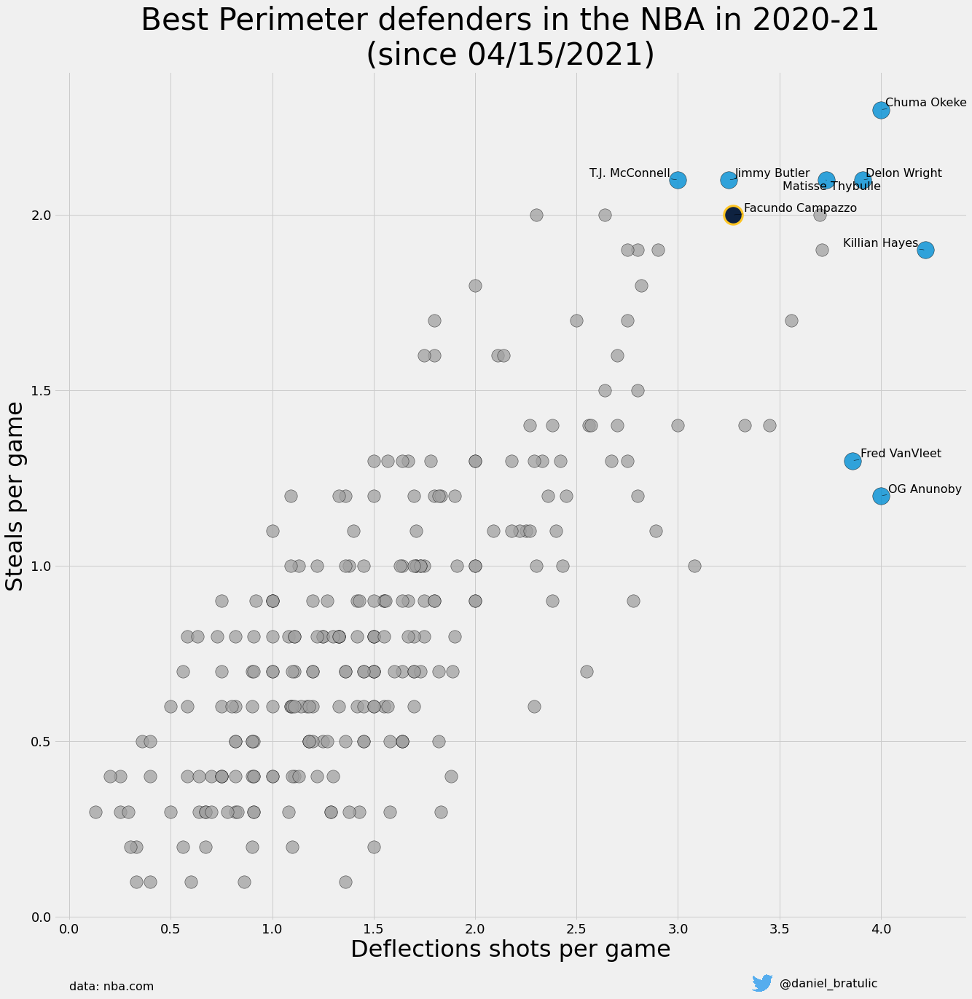

In [145]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(x=other.DEFLECTIONS, y=other.STL, s=300, edgecolors='black', alpha=0.75, color='#A0A0A0')
ax.scatter(x=top_performers.DEFLECTIONS, y=top_performers.STL, s=550, edgecolors='black', alpha=0.8)
ax.scatter(x=campazzo.DEFLECTIONS, y=campazzo.STL, s=650, color='#0E2240', edgecolors='#FEC524', lw=3)
#ax.set_xlim(-0.1, 18.5)
#ax.set_xticks(range(0, 19, 2))

texts = []
added = []
for i in range(len(top_performers)):
    item = top_performers.iloc[i]
    if item.PLAYER_NAME in added:
        continue
    texts.append(ax.text(x=item.DEFLECTIONS, y=item.STL, s=item.PLAYER_NAME, fontsize=16))
    added.append(item.PLAYER_NAME)
    
ax.set_title('Best Perimeter defenders in the NBA in 2020-21\n(since 04/15/2021)', size=42)
ax.set_xlabel("Deflections shots per game", size=32)
ax.set_ylabel("Steals per game", size=32)
ax.tick_params(labelsize=18)

offset_image = OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.025, )

#ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (0.88, len(pivoted)+0.5), frameon=False)
y_coord = -0.2
offset_image.set_offset((1025, 0))
ax.add_artist(offset_image)
ax.text(x=3.5, y=y_coord, ha='left', s='@daniel_bratulic', size=16)
ax.text(x=0, y=y_coord, s='data: nba.com', size=16, va='center', ha='left')
adjust_text(texts, expand_points=(1.2, 1.2), arrowprops={'arrowstyle': '-', 'color': 'black'})

### FTA vs FGA in paint

In [16]:
from nba_api.stats.endpoints.leaguedashplayershotlocations import LeagueDashPlayerShotLocations

In [17]:
shot_locations = LeagueDashPlayerShotLocations(distance_range='By Zone', season='2020-21', per_mode_detailed='PerGame')

In [18]:
shot_types = shot_locations.get_dict()['resultSets']['headers'][0]['columnNames']

In [19]:
columns = shot_locations.get_dict()['resultSets']['headers'][1]['columnNames']

In [20]:
final_columns = columns[:5]
for cur_type in shot_types:
    final_columns.append(f'FGM_{cur_type.split("(")[0].strip().replace(" ", "_").upper()}')
    final_columns.append(f'FGA_{cur_type.split("(")[0].strip().replace(" ", "_").upper()}')
    final_columns.append(f'FG_PCT_{cur_type.split("(")[0].strip().replace(" ", "_").upper()}')

In [21]:
shot_df = pd.DataFrame(data=shot_locations.get_dict()['resultSets']['rowSet'], columns=final_columns)

In [22]:
shot_df.loc[:, 'FGA_PAINT_ALL'] = shot_df.FGA_RESTRICTED_AREA + shot_df.FGA_IN_THE_PAINT

In [23]:
base_data = LeagueDashPlayerStats(per_mode_detailed='PerGame', season='2020-21')
base_df = base_data.get_data_frames()[0]

In [24]:
merged_df = pd.merge(left=base_df, right=shot_df, on=('PLAYER_ID', 'PLAYER_NAME'))

In [25]:
top_players = merged_df.sort_values(by='PTS', ascending=False).iloc[:40]

In [26]:
player_root_dir = 'player_imgs'

import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

def getImage(player_id, zoom=1.0):
    #print(path)
    return OffsetImage(plt.imread(f"{player_root_dir}/{player_id}.png"), zoom=zoom)


In [27]:
from sklearn.linear_model import LinearRegression

In [28]:
import scipy

xs = top_players.FGA_PAINT_ALL
ys = top_players.FTA
    
#x = merged_df.FG3_PCT.to_numpy().reshape(-1, 1)
#y = merged_df.CONTESTED_SHOTS_3PT

reg = LinearRegression().fit(np.array(xs).reshape(-1, 1), ys)

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(xs, ys)

r_value

0.5350369934566355

Text(6, 1.32, 'source: nba.com')

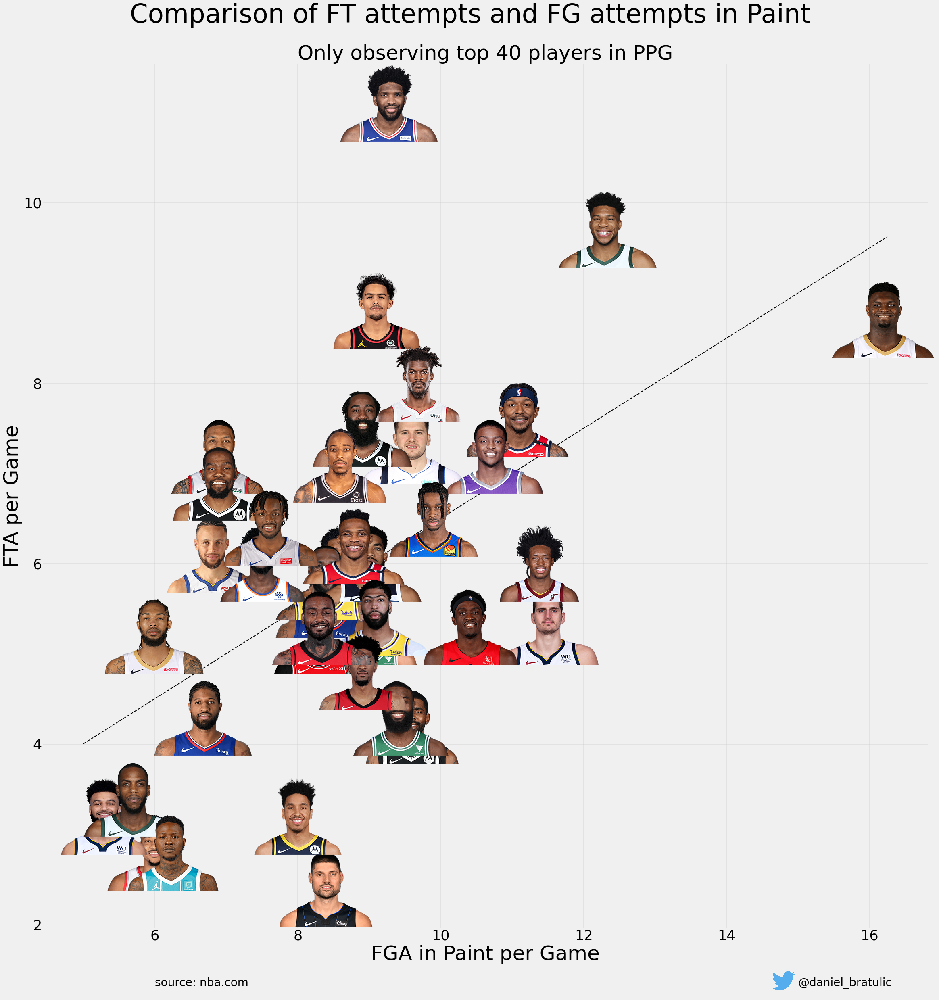

In [29]:
fig, ax = plt.subplots(figsize=(35, 35))
x = top_players.FGA_PAINT_ALL.tolist()
y = top_players.FTA.tolist()
ax.scatter(x, y) 
ax.tick_params(labelsize=35)
ax.set_xlabel("FGA in Paint per Game", size=50)
ax.set_ylabel("FTA per Game", size=50)
plt.suptitle("Comparison of FT attempts and FG attempts in Paint", size=64)
ax.set_title("Only observing top 40 players in PPG", size=50, ha='center')
#ax.set_title("Top 35 igrača s najviše posjeda u tim akcijama", size=50, ha='center')
#ax.set_ylim(0.7, 1.55)
#ax.set_xlim(-0.1, 10.1)
ax.grid(b=True, alpha=0.5, lw=1.5)

for x0, y0, player_id in zip(x, y, top_players.PLAYER_ID.tolist()):
    ab = AnnotationBbox(getImage(player_id), (x0, y0), frameon=False, pad=0.0)
    ax.add_artist(ab)
    
fig.subplots_adjust(top=0.92)
#ax.title.set_position([.5, 1.15])
ax.set_frame_on(False)
data = np.arange(5, 16.5, 0.25)
ax.plot(data, reg.predict(data.reshape(-1, 1)), color='black', ls='--', lw=2)

y_coord = 1.32
offset_image = OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05, )

#ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (0.88, 0.74), frameon=False)

offset_image.set_offset((1900, 5))
ax.add_artist(offset_image)
ax.text(x=15, y=y_coord, ha='left', s='@daniel_bratulic', size=28)
ax.text(x=6, y=y_coord, ha='left', s='source: nba.com', size=28)

#### No Zion

In [79]:
top_players = top_players.loc[top_players.PLAYER_NAME != "Zion Williamson"]

In [80]:
import scipy

xs = top_players.FGA_PAINT_ALL
ys = top_players.FTA
    
#x = merged_df.FG3_PCT.to_numpy().reshape(-1, 1)
#y = merged_df.CONTESTED_SHOTS_3PT

reg = LinearRegression().fit(np.array(xs).reshape(-1, 1), ys)

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(xs, ys)

r_value

0.5026038584430005

Text(6, 1.32, 'source: nba.com')

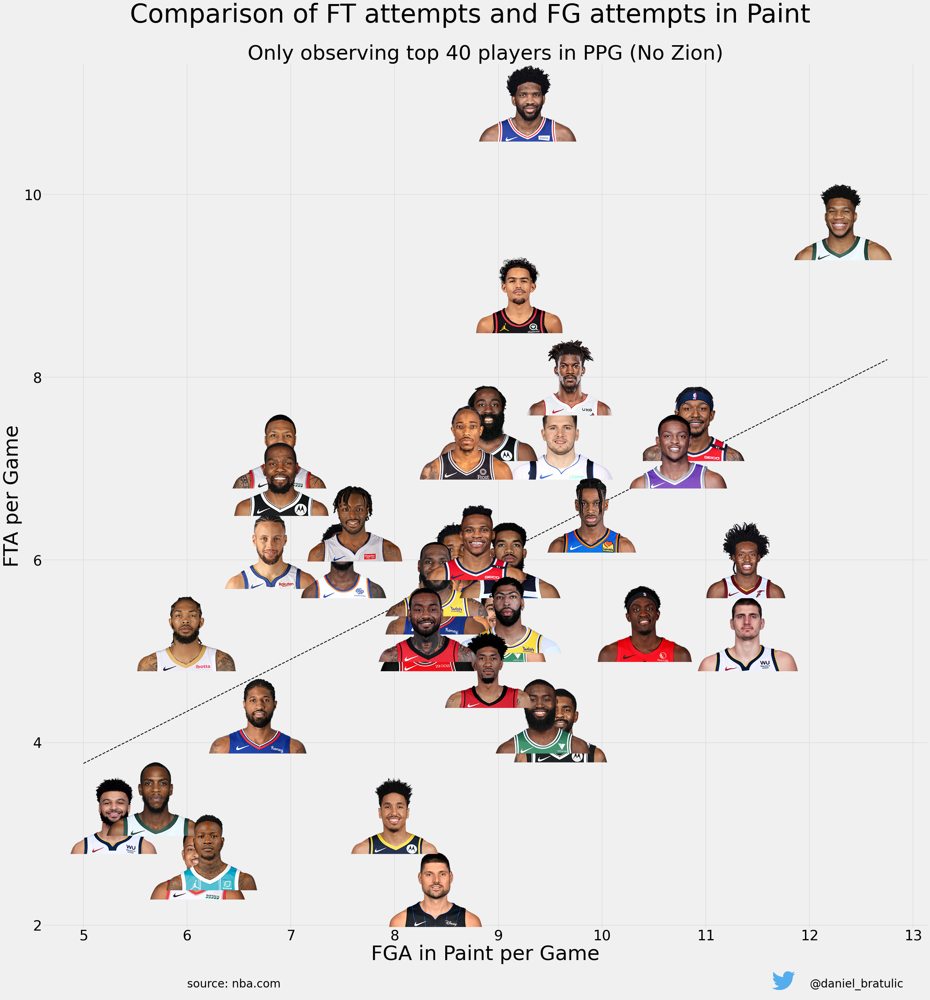

In [84]:


fig, ax = plt.subplots(figsize=(35, 35))
x = top_players.FGA_PAINT_ALL.tolist()
y = top_players.FTA.tolist()
ax.scatter(x, y) 
ax.tick_params(labelsize=35)
ax.set_xlabel("FGA in Paint per Game", size=50)
ax.set_ylabel("FTA per Game", size=50)
plt.suptitle("Comparison of FT attempts and FG attempts in Paint", size=64)
ax.set_title("Only observing top 40 players in PPG (No Zion)", size=50, ha='center')
#ax.set_title("Top 35 igrača s najviše posjeda u tim akcijama", size=50, ha='center')
#ax.set_ylim(0.7, 1.55)
#ax.set_xlim(-0.1, 10.1)
ax.grid(b=True, alpha=0.5, lw=1.5)

for x0, y0, player_id in zip(x, y, top_players.PLAYER_ID.tolist()):
    ab = AnnotationBbox(getImage(player_id), (x0, y0), frameon=False, pad=0.0)
    ax.add_artist(ab)
    
fig.subplots_adjust(top=0.92)
#ax.title.set_position([.5, 1.15])
ax.set_frame_on(False)
data = np.arange(5, 13, 0.25)
ax.plot(data, reg.predict(data.reshape(-1, 1)), color='black', ls='--', lw=2)

y_coord = 1.32
offset_image = OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05, )

#ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (0.88, 0.74), frameon=False)

offset_image.set_offset((1900, 5))
ax.add_artist(offset_image)
ax.text(x=12, y=y_coord, ha='left', s='@daniel_bratulic', size=28)
ax.text(x=6, y=y_coord, ha='left', s='source: nba.com', size=28)

### Tracking stats

In [85]:
from nba_api.stats.endpoints.leaguedashptstats import LeagueDashPtStats

In [91]:
measures = [
    'Drives',
    'PaintTouch',
    'ElbowTouch',
    'PostTouch'
]

In [89]:
paint_touch = LeagueDashPtStats(per_mode_simple='PerGame', pt_measure_type='PaintTouch', player_or_team='Player')

In [92]:
#todo iterate over measures

## Defensive chart

In [99]:
headers= {
    'Host': 'stats.nba.com', 
    'Connection': 'keep-alive', 
    'Accept': 'application/json, text/plain, */*', 
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/78.0.3904.97 Safari/537.36', 
    'Referer': 'https://stats.nba.com/', 
    'Accept-Encoding': 'gzip, deflate, br', 
    'Accept-Language': 'en-US,en;q=0.9',
    'x-nba-stats-origin': 'stats',
    'x-nba-stats-token': 'true',
}

In [100]:
import random
from matplotlib.patches import Circle, Rectangle, Arc

# Amazing function by Bradley Fay for plotting the nba court
# source: https://github.com/bradleyfay/py-Goldsberry/blob/master/docs/Visualizing%20NBA%20Shots%20with%20py-Goldsberry.ipynb
def draw_court(ax=None, color='black', lw=2, background_color="#EBEBE8", outer_lines=False, zorder=None):
    # If an axes object isn't provided to plot onto, just get current one
    if ax is None:
        ax = plt.gca()

    # Create the various parts of an NBA basketball court

    # Create the basketball hoop
    # Diameter of a hoop is 18" so it has a radius of 9", which is a value
    # 7.5 in our coordinate system
    hoop = Circle((0, 0), radius=7.5, linewidth=lw, color=color, fill=False, zorder=zorder)

    # Create backboard
    backboard = Rectangle((-30, -7.5), 60, -1, linewidth=lw, color=color, zorder=zorder)

    # The paint
    # Create the outer box 0f the paint, width=16ft, height=19ft
    outer_box = Rectangle((-80, -47.5), 160, 190, linewidth=lw, color=color,
                          fill=False, zorder=0)
    # Create the inner box of the paint, widt=12ft, height=19ft
    inner_box = Rectangle((-60, -47.5), 120, 190, linewidth=lw, color=color,
                          fill=False, zorder=0)

    # Create free throw top arc
    top_free_throw = Arc((0, 142.5), 120, 120, theta1=0, theta2=180,
                         linewidth=lw, color=color, fill=False, zorder=0)
    # Create free throw bottom arc
    bottom_free_throw = Arc((0, 142.5), 120, 120, theta1=180, theta2=0,
                            linewidth=lw, color=color, linestyle='dashed', zorder=0)
    # Restricted Zone, it is an arc with 4ft radius from center of the hoop
    restricted = Arc((0, 0), 80, 80, theta1=0, theta2=180, linewidth=lw,
                     color=color, zorder=0)

    # Three point line
    # Create the side 3pt lines, they are 14ft long before they begin to arc
    corner_three_a = Rectangle((-220, -47.5), 0, 138, linewidth=lw,
                               color=color, zorder=zorder)
    corner_three_b = Rectangle((220, -47.5), 0, 138, linewidth=lw, color=color, zorder=zorder)
    # 3pt arc - center of arc will be the hoop, arc is 23'9" away from hoop
    # I just played around with the theta values until they lined up with the 
    # threes
    three_arc = Arc((0, 0), 475, 475, theta1=22.13, theta2=157.87, linewidth=lw,
                    color=color, zorder=zorder)

    # Center Court
    center_outer_arc = Arc((0, 422), 120, 120, theta1=180, theta2=0,
                           linewidth=lw, color=color, zorder=0)
    center_inner_arc = Arc((0, 422), 40, 40, theta1=180, theta2=0,
                           linewidth=lw, color=color, zorder=0)

    # List of the court elements to be plotted onto the axes
    court_elements = [hoop, backboard, outer_box, inner_box, top_free_throw,
                      bottom_free_throw, restricted, corner_three_a,
                      corner_three_b, three_arc, center_outer_arc,
                      center_inner_arc]
    
    # Draw the half court line, baseline and side out bound lines
    outer_lines = Rectangle((-249, -48), 498, 470, linewidth=lw,
                            color=color, fill=None, zorder=zorder)
    court_elements.append(outer_lines)

    # Add the court elements onto the axes
    for element in court_elements:
        ax.add_patch(element)

    return ax

In [101]:
from nba_api.stats.endpoints.playerdashptshotdefend import PlayerDashPtShotDefend

LESS_SIX = "LESS_THAN_SIX"
SIX_TEN = "SIX_TEN"
TEN_FIFTEEN = "TEN_FIFTEEN"
GREATER_FIFTEEN = "GREATER_FIFTEEN"
THREE_POINTER = "THREE_POINTER"

bball_gray = '#312f30'
bball_white = '#dddee0'
bball_orange = '#f87c24'
bball_light_orange = '#fbaf7b'


In [102]:
def_dist_keys = [LESS_SIX, SIX_TEN, TEN_FIFTEEN, GREATER_FIFTEEN, THREE_POINTER]

def get_defend_data(player_id, date_to="", date_from="", per_game: bool=False, season = "2019-20"):
    defend_data = PlayerDashPtShotDefend(player_id=player_id, team_id=0, date_from_nullable=date_from, date_to_nullable=date_to, per_mode_simple='PerGame' if per_game else 'Totals', season=season)
    
    defend_df = defend_data.get_data_frames()[0]
    
    less_than_10 = defend_df.loc[defend_df.DEFENSE_CATEGORY == 'Less Than 10 Ft'].iloc[0]
    less_than_6 = defend_df.loc[defend_df.DEFENSE_CATEGORY == 'Less Than 6 Ft'].iloc[0]
    greater_than_15 = defend_df.loc[defend_df.DEFENSE_CATEGORY == 'Greater Than 15 Ft'].iloc[0]
    two_point = defend_df.loc[defend_df.DEFENSE_CATEGORY == '2 Pointers'].iloc[0]
    three_point = defend_df.loc[defend_df.DEFENSE_CATEGORY == '3 Pointers'].iloc[0]

    greater_fifteen_two_fga = greater_than_15.D_FGA - three_point.D_FGA
    greater_fifteen_two_fgm = greater_than_15.D_FGM - three_point.D_FGM

    ten_fifteen_fga = two_point.D_FGA - greater_fifteen_two_fga - less_than_10.D_FGA
    ten_fifteen_fgm = two_point.D_FGM - greater_fifteen_two_fgm - less_than_10.D_FGM

    six_ten_fga = less_than_10.D_FGA - less_than_6.D_FGA
    six_ten_fgm = less_than_10.D_FGM - less_than_6.D_FGM
    
    made_dict = {
        LESS_SIX: less_than_6.D_FGM,
        SIX_TEN: six_ten_fgm,
        TEN_FIFTEEN: ten_fifteen_fgm,
        GREATER_FIFTEEN: greater_fifteen_two_fgm,
        THREE_POINTER: three_point.D_FGM
    }
    attempt_dict = {
        LESS_SIX: less_than_6.D_FGA,
        SIX_TEN: six_ten_fga,
        TEN_FIFTEEN: ten_fifteen_fga,
        GREATER_FIFTEEN: greater_fifteen_two_fga,
        THREE_POINTER: three_point.D_FGA
    }
    return made_dict, attempt_dict
    
    

team_categories = [
    'Overall',
    '3 Pointers',
    '2 Pointers',
    'Less Than 6Ft',
    'Less Than 10Ft',
    'Greater Than 15Ft'
]

def get_team_defense_df(defense_category, season='2019-20'):
    url = f"https://stats.nba.com/stats/leaguedashptteamdefend?Conference=&DateFrom=&DateTo=&DefenseCategory={defense_category}&Division=&GameSegment=&LastNGames=0&LeagueID=00&Location=&Month=0&OpponentTeamID=0&Outcome=&PORound=0&PerMode=PerGame&Period=0&Season={season}&SeasonSegment=&SeasonType=Regular+Season&TeamID=0&VsConference=&VsDivision="
    resp = requests.get(url=url, headers=headers)
    data_dict = resp.json()
    return pd.DataFrame(data=data_dict['resultSets'][0]['rowSet'], columns=data_dict['resultSets'][0]['headers'])

def get_league_averages(season = '2019-20'):
    avg_dict = {}

    category_dict = {}
    for category in team_categories:
        category_dict[category] = get_team_defense_df(defense_category=category, season=season)
        sleep(0.25)

    averaged_dicts = {}
    for category in category_dict:
        averaged_dicts[category] = category_dict[category].mean()

    greater_fifteen_two_fga_avg = averaged_dicts['Greater Than 15Ft'].FGA_GT_15 - averaged_dicts['3 Pointers'].FG3A
    greater_fifteen_two_fgm_avg = averaged_dicts['Greater Than 15Ft'].FGM_GT_15 - averaged_dicts['3 Pointers'].FG3M

    ten_fifteen_fga_avg = averaged_dicts['2 Pointers'].FG2A - greater_fifteen_two_fga_avg - averaged_dicts['Less Than 10Ft'].FGA_LT_10
    ten_fifteen_fgm_avg = averaged_dicts['2 Pointers'].FG2M - greater_fifteen_two_fgm_avg - averaged_dicts['Less Than 10Ft'].FGM_LT_10

    six_ten_fga_avg = averaged_dicts['Less Than 10Ft'].FGA_LT_10 - averaged_dicts['Less Than 6Ft'].FGA_LT_06
    six_ten_fgm_avg = averaged_dicts['Less Than 10Ft'].FGM_LT_10 - averaged_dicts['Less Than 6Ft'].FGM_LT_06
    
    avg_dict = {
        LESS_SIX: averaged_dicts['Less Than 6Ft'].FGM_LT_06 / averaged_dicts['Less Than 6Ft'].FGA_LT_06,
        SIX_TEN: six_ten_fgm_avg / six_ten_fga_avg,
        TEN_FIFTEEN: ten_fifteen_fgm_avg / ten_fifteen_fga_avg,
        GREATER_FIFTEEN: greater_fifteen_two_fgm_avg / greater_fifteen_two_fga_avg,
        THREE_POINTER: averaged_dicts['3 Pointers'].FG3M / averaged_dicts['3 Pointers'].FG3A
    }
    return avg_dict

from matplotlib.patches import Circle, PathPatch
from matplotlib.path import Path

def get_six_feet_arc(color):
    vertices = [
        [40, -47.5],
        [140, 96],
        [-139, 98],
        [-40, -47.5],
    ]
    codes = [Path.MOVETO, Path.CURVE4, Path.CURVE4, Path.CURVE4]
    arc_path = Path(vertices=vertices, codes=codes)
    return PathPatch(path=arc_path, color=color, alpha=0.6, zorder=2)

def get_six_ten_feet_arc(color):
    vertices = [
        [-90, -47.5],
        [-162, 150],
        [162, 150],
        [90, -47.5],
        [38, -47.5],
        [140, 96],
        [-139, 98],
        [-38, -47.5],   
    ]
    codes = [Path.MOVETO, Path.CURVE4, Path.CURVE4, Path.CURVE4, 
             Path.LINETO, Path.CURVE4, Path.CURVE4, Path.CURVE4, 

            ]
    arc_path = Path(vertices=vertices, codes=codes)
    return PathPatch(path=arc_path, color=color, alpha=0.6, zorder=2)

def get_ten_fifteen_arc(color):
    vertices = [
        [-144, -47.5],
        [-200, 215],
        [200, 215],
        [144, -47.5],
        [90, -47.5],
        [162, 150],
        [-162, 150],
        [-90, -47.5],
    ]
    codes = [Path.MOVETO, Path.CURVE4, Path.CURVE4, Path.CURVE4, 
             Path.LINETO, Path.CURVE4, Path.CURVE4, Path.CURVE4]
    arc_path = Path(vertices=vertices, codes=codes)
    return PathPatch(path=arc_path, color=color, alpha=0.6, zorder=2)
    
def get_greater_fifteen(color):
    vertices = [
        [-220, -47.5],
        [-220, 90.5],
        [-130, 285],
        [130, 285],
        [220, 90.5],
        [220, -47.5],
        [144, -47.5],
        [200, 215],
        [-200, 215],
        [-144, -47.5],
    ]
    codes = [Path.MOVETO, Path.LINETO, Path.CURVE4, Path.CURVE4, Path.CURVE4, 
             Path.LINETO, Path.LINETO, Path.CURVE4, Path.CURVE4, Path.CURVE4, 

            ]
    arc_path = Path(vertices=vertices, codes=codes)
    return PathPatch(path=arc_path, color=color, alpha=0.6, zorder=2)

def get_three_point_area(color):
    vertices = [
        [-250, -47.5],
        [-220, -47.5],
        [-220, 90.5],
        [-142, 285],
        [142, 285],
        [220, 90.5],
        [220, -47.5],
        [250, -47.5],
        [250, 160],
        [190, 370],
        [-190, 370],
        [-250, 160]
    ]
    codes = [Path.MOVETO, Path.LINETO, Path.LINETO,
             Path.CURVE4, Path.CURVE4, Path.CURVE4, 
             Path.LINETO, Path.LINETO, Path.LINETO,
             Path.CURVE4, Path.CURVE4, Path.CURVE4,
            ]
    arc_path = Path(vertices=vertices, codes=codes)
    return PathPatch(path=arc_path, color=color, alpha=0.6, zorder=3, lw=0)

In [103]:
def plot_texts(ax, made_dict, attempt_dict, six_pct, six_ten_pct, 
               ten_fifteen_pct, greater_fifteen_pct, three_pointer_pct, is_per_game=False):
    alpha = 0.6
    if not is_per_game:
        ax.text(x=0, y=20, s=f"{made_dict[LESS_SIX]} / {attempt_dict[LESS_SIX]}\n{six_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})
        ax.text(x=0, y=70, s=f"{made_dict[SIX_TEN]} / {attempt_dict[SIX_TEN]}\n{six_ten_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})
        ax.text(x=0, y=120,
                s=f"{made_dict[TEN_FIFTEEN]} / {attempt_dict[TEN_FIFTEEN]}\n{ten_fifteen_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})
        ax.text(x=0, y=170,
                s=f"{made_dict[GREATER_FIFTEEN]} / {attempt_dict[GREATER_FIFTEEN]}\n{greater_fifteen_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})
        ax.text(x=0, y=260, s=f"{made_dict[THREE_POINTER]} / {attempt_dict[THREE_POINTER]}\n{three_pointer_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})
    else:
        ax.text(x=0, y=20, s=f"{made_dict[LESS_SIX]:.2f} / {attempt_dict[LESS_SIX]:.2f}\n{six_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})
        ax.text(x=0, y=70, s=f"{made_dict[SIX_TEN]:.2f} / {attempt_dict[SIX_TEN]:.2f}\n{six_ten_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})
        ax.text(x=0, y=120,
                s=f"{made_dict[TEN_FIFTEEN]:.2f} / {attempt_dict[TEN_FIFTEEN]:.2f}\n{ten_fifteen_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})
        ax.text(x=0, y=170,
                s=f"{made_dict[GREATER_FIFTEEN]:.2f} / {attempt_dict[GREATER_FIFTEEN]:.2f}\n{greater_fifteen_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})
        ax.text(x=0, y=260, s=f"{made_dict[THREE_POINTER]:.2f} / {attempt_dict[THREE_POINTER]:.2f}\n{three_pointer_pct*100:.2f}%", fontsize=18,
                color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': alpha, 'edgecolor': 'black', 'boxstyle' : 'round'})




def plot_for_player(player_id, team_id, title, date_from="", date_to="", is_per_game=False, season='2019-20'):
    fig, ax = plt.subplots(figsize=(20, 20))
    # colors_dict = {0:'red', 1:'green'}
    made_dict, attempt_dict = get_defend_data(player_id=player_id, date_from=date_from, date_to=date_to, per_game=is_per_game, season=season)
    league_average = get_league_averages(season=season)

    texts = []
    output_list = []

    cmap = sns.blend_palette(colors=["#4159E1", "#B0E0E6", "#FFFF99","#EF3330", "#AB2020"], n_colors=21, as_cmap=False)
    bin_res = {item: index for index, item in enumerate(list(range(-10, 11, 1)))}
    
    six_pct = made_dict[LESS_SIX]/attempt_dict[LESS_SIX]
    six_ten_pct = made_dict[SIX_TEN]/attempt_dict[SIX_TEN]
    ten_fifteen_pct = made_dict[TEN_FIFTEEN]/attempt_dict[TEN_FIFTEEN]
    greater_fifteen_pct = made_dict[GREATER_FIFTEEN]/attempt_dict[GREATER_FIFTEEN]
    three_pointer_pct = made_dict[THREE_POINTER]/attempt_dict[THREE_POINTER]
    
    six_zone_diff = np.clip((six_pct - league_average[LESS_SIX])*100,-10, 10)
    six_ten_diff = np.clip((six_ten_pct - league_average[SIX_TEN])*100,-10, 10)
    ten_fifteen_diff = np.clip((ten_fifteen_pct - league_average[TEN_FIFTEEN])*100,-10, 10)
    greater_fifteen_two_diff = np.clip((greater_fifteen_pct - league_average[GREATER_FIFTEEN])*100,-10, 10)
    three_diff = np.clip((three_pointer_pct - league_average[THREE_POINTER])*100,-10, 10)
    
    plot_texts(ax=ax, made_dict=made_dict, attempt_dict=attempt_dict, six_pct=six_pct, 
               six_ten_pct=six_ten_pct, ten_fifteen_pct=ten_fifteen_pct, greater_fifteen_pct=greater_fifteen_pct,
               three_pointer_pct=three_pointer_pct, is_per_game=is_per_game)


    # GREATER THAN 15
    ax.add_patch(get_greater_fifteen(color=cmap[bin_res[int(greater_fifteen_two_diff)]]))
    # 10-15 ft
    ax.add_patch(get_ten_fifteen_arc(color=cmap[bin_res[int(ten_fifteen_diff)]]))
    # 6-10 ft
    ax.add_patch(get_six_ten_feet_arc(color=cmap[bin_res[int(six_ten_diff)]]))
    # <6 ft
    ax.add_patch(get_six_feet_arc(color=cmap[bin_res[int(six_zone_diff)]]))
    # 3 pt
    ax.add_patch(get_three_point_area(color=cmap[bin_res[int(three_diff)]]))

    ax.set_facecolor(bball_gray)
    fig.set_facecolor(bball_gray)
    ax.set_frame_on(False)

    # Removing ticks
    ax.xaxis.set_ticks([])
    ax.yaxis.set_ticks([])
    ax.grid(False)

    url = f"https://ak-static.cms.nba.com/wp-content/uploads/headshots/nba/{team_id}/{season.split('-')[0]}/260x190/{player_id}.png"
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    
    ax.imshow(img, extent=(132, 252, -47, 41), zorder=7)


    ax.text(x=164, y=400, s="Comparison with\nleague average percentage", color=bball_white, fontsize=20, ha='center')
    ax.text(x=90, y=365, s="BETTER\nDefending", color=bball_white, fontsize=20)
    ax.scatter(x=130, y=387, s=1000, marker='o', c="#4159E1", edgecolors=bball_white)
    ax.scatter(x=147, y=387, s=1000, marker='o', c="#B0E0E6", edgecolors=bball_white)
    ax.scatter(x=164, y=387, s=1000, marker='o', c="#FFFF99", edgecolors=bball_white)
    ax.scatter(x=181, y=387, s=1000, marker='o', c="#EF3330", edgecolors=bball_white)
    ax.scatter(x=198, y=387, s=1000, marker='o', c="#AB2020", edgecolors=bball_white)
    ax.text(x=201, y=365, s="   WORSE\nDefending", color=bball_white, fontsize=20)


    # Title
    ax.set_title(title, size=36, color=bball_light_orange)
    #adjust_text(texts=texts, expand_points=(1.2, 1.9))
    
    ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.025), (142, -58), frameon=False)
    ax.add_artist(ab)

    #ab = AnnotationBbox(OffsetImage(plt.imread(f'../../twitter_logo.png'), zoom=0.05), (0.88, len(pivoted)+0.5), frameon=False)
    y_coord = -60
    #offset_image.set_offset((1100, 0))
    #ax.add_artist(offset_image)
    ax.text(x=150, y=y_coord, ha='left', s='@daniel_bratulic', size=18, color=bball_light_orange)
    ax.text(x=-220, y=y_coord, ha='left', s='source: nba.com', size=18, color=bball_light_orange)
    
    ax.text(x=-170, y=405, s=f"Numbers (Per Game) in Boxes:", color=bball_white, fontsize=20, ha='center')
    ax.text(x=-170, y=380, s=f"Allowed FGM / Allowed FGA\nAllowed FG%", fontsize=20,
            color='black', ha='center', zorder=6, bbox={'facecolor': '#CDDADA', 'alpha': 0.6, 'edgecolor': 'black', 'boxstyle' : 'round'})

    # Drawing court
    draw_court(ax=ax,outer_lines=True, lw=3, color=bball_light_orange, zorder=7)
    ax.set_xlim(-251,251)
    ax.set_ylim(-65,423)
    for circle in output_list:    
        ax.add_artist(circle)

In [112]:

player_id = 1630267
team_id = find_teams_by_full_name("Denver Nuggets")[0]['id']

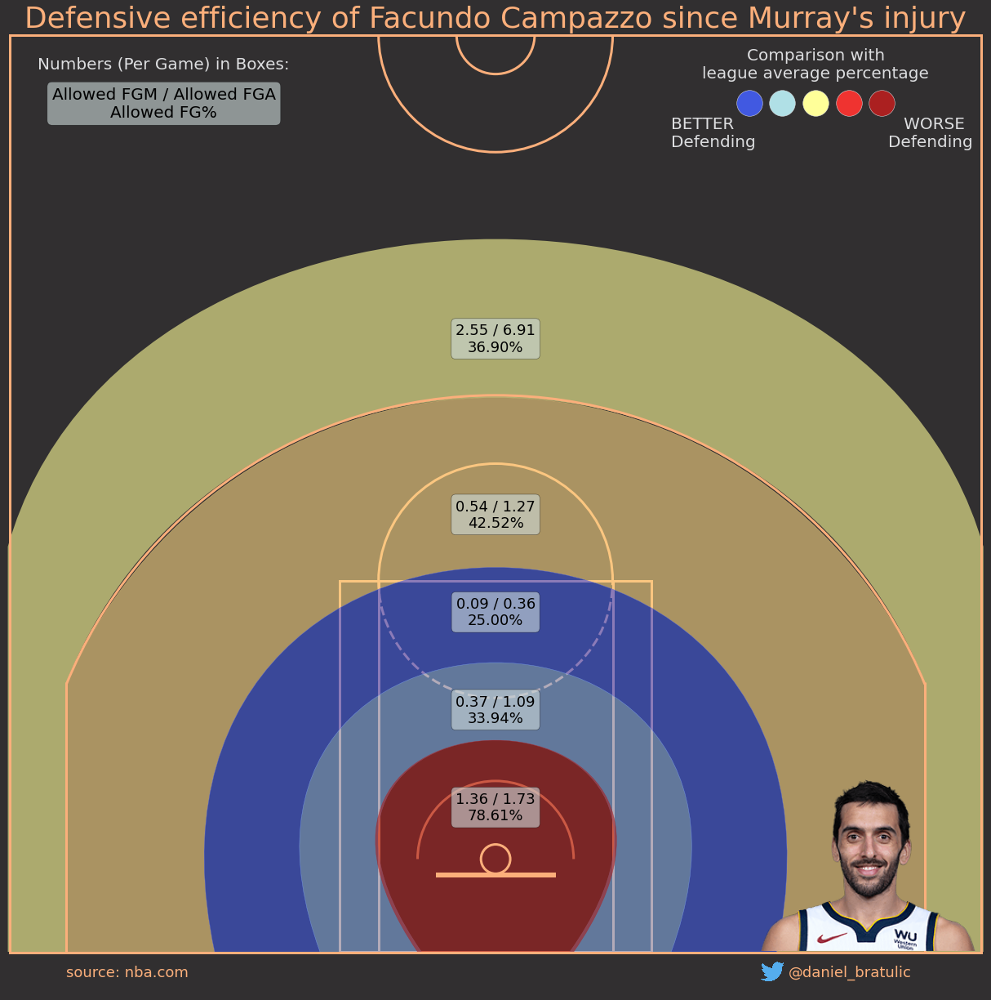

In [113]:
plot_for_player(player_id=player_id, team_id=team_id, title="Defensive efficiency of Facundo Campazzo since Murray's injury", is_per_game=True, season='2020-21', date_from='04/15/2021')

In [114]:
player_id = find_players_by_full_name("Aaron Gordon")[0]['id']

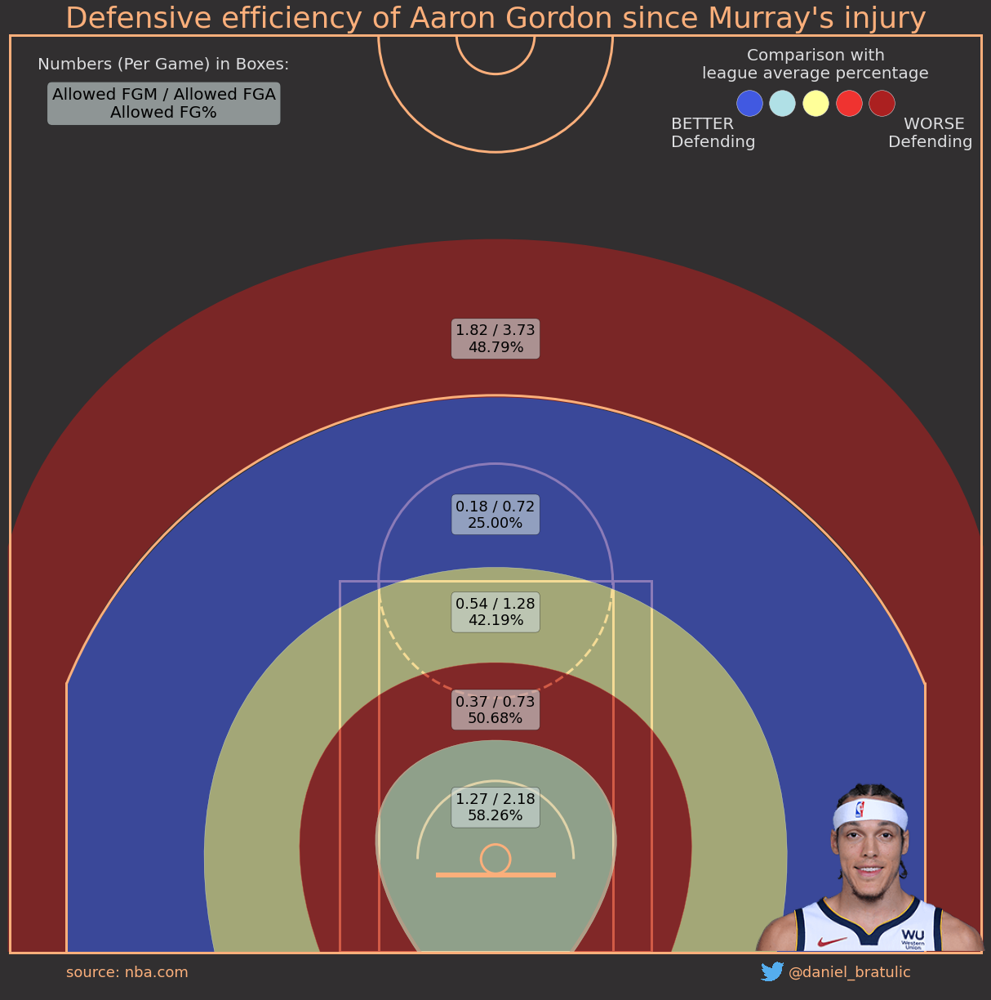

In [115]:
plot_for_player(player_id=player_id, team_id=team_id, title="Defensive efficiency of Aaron Gordon since Murray's injury", is_per_game=True, season='2020-21', date_from='04/15/2021')

In [116]:
player_id = find_players_by_full_name("Nikola Jokic")[0]['id']

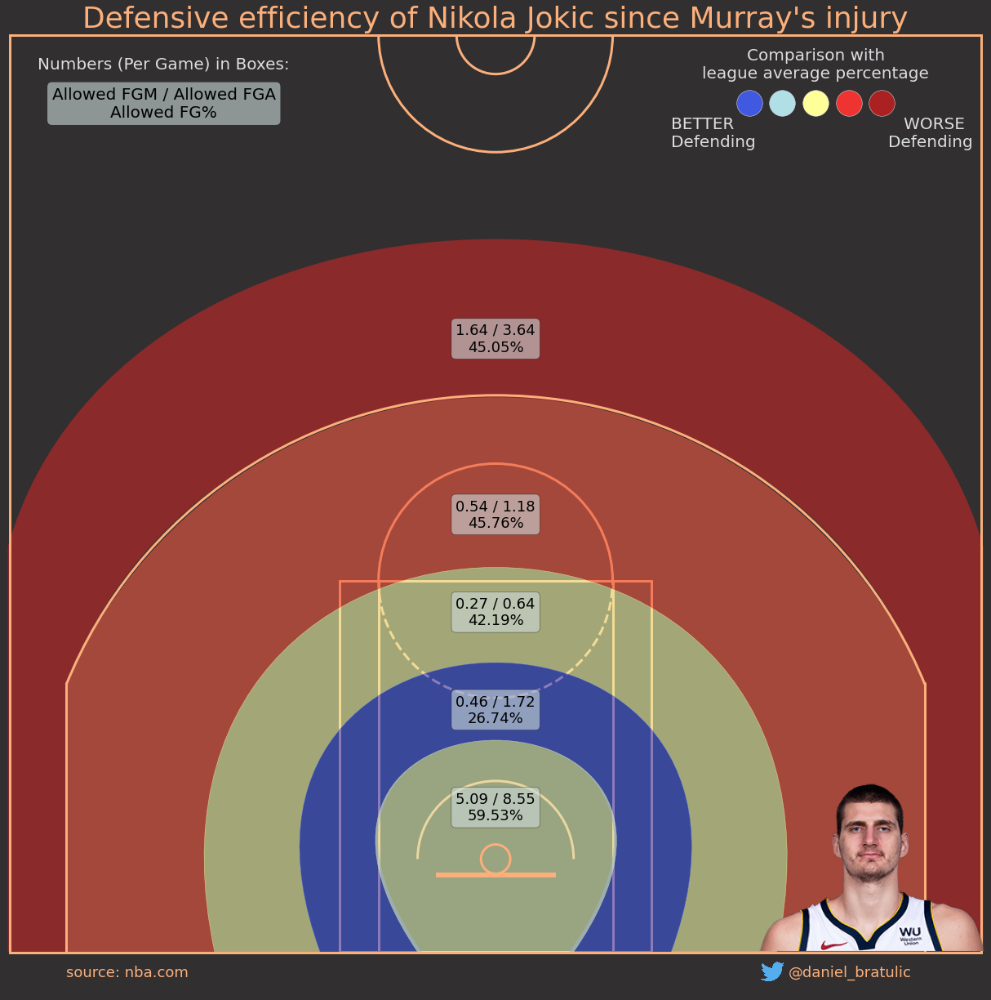

In [117]:
plot_for_player(player_id=player_id, team_id=team_id, title="Defensive efficiency of Nikola Jokic since Murray's injury", is_per_game=True, season='2020-21', date_from='04/15/2021')

In [118]:
player_id = find_players_by_full_name("PJ Dozier")[0]['id']

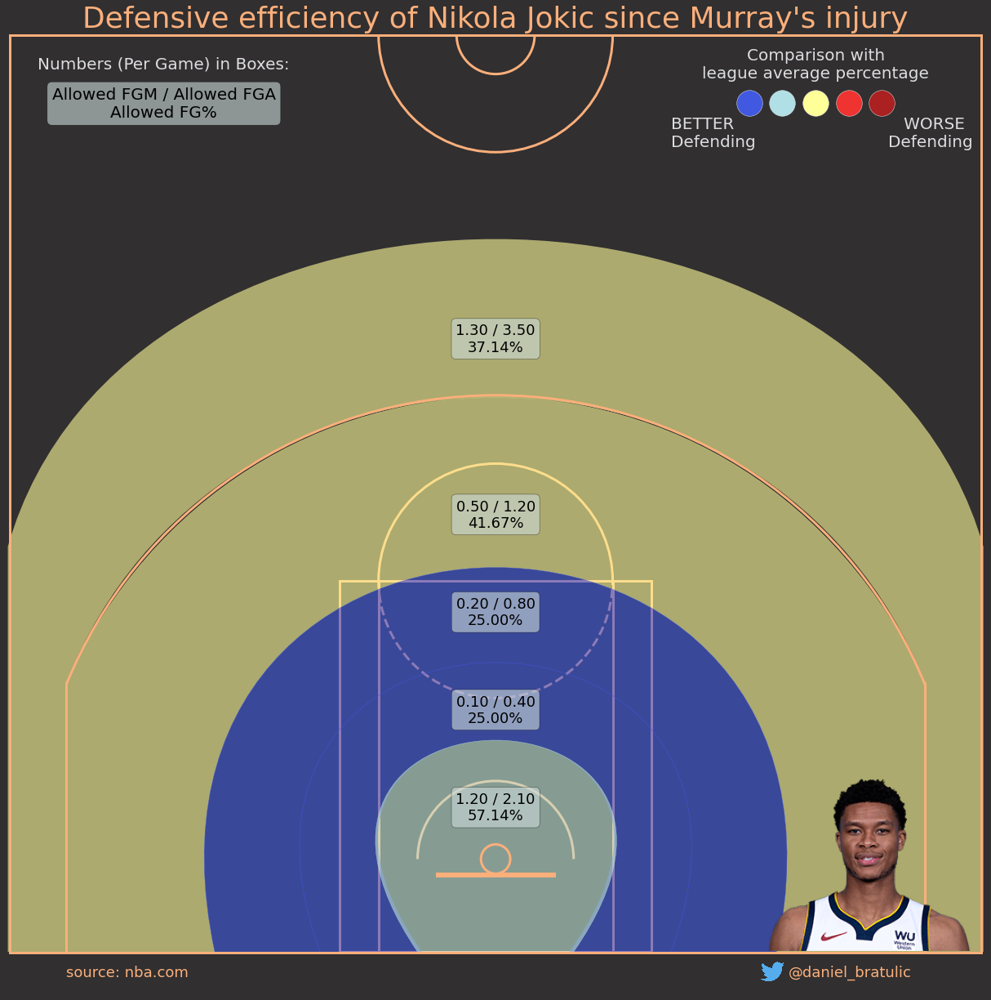

In [119]:
plot_for_player(player_id=player_id, team_id=team_id, title="Defensive efficiency of Nikola Jokic since Murray's injury", is_per_game=True, season='2020-21', date_from='04/15/2021')